LENDING CLUB FINAL

In [84]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
LC_2007_11 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats3a.csv')

In [4]:
LC_2012_13 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats3b_securev1.csv')

In [5]:
LC_2014 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats3c_securev1.csv')

In [6]:
LC_2015 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats3d_securev1.csv')

In [7]:
LC_2016_1 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats_2016Q1.csv')

In [8]:
LC_2016_2 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats_2016Q2.csv')

In [9]:
LC_2016_3 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats_2016Q3.csv')

In [10]:
LC_2016_4 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats_2016Q4.csv')

In [11]:
LC_2017_1 = pd.read_csv('/Users/adrija/Desktop/dsi-sf-7/Lending Club_Active/LoanStats_2017Q1.csv')

A function to check if all the datasets have the same features

In [12]:

def add_col(m):
    Col_list =[]
    for i in m.columns:
        Col_list.append(i)
    return Col_list

def cmpL(a,b):
    not_match_list = []
    for j in a.columns:
        if j not in b:
            not_match_list.append(j)
    return not_match_list        

def merge_columns(x, y):
    length_x = len(x.columns)
    length_y = len(y.columns)
    #not_match_list = []
    if length_x > length_y:
        Col_list = add_col(y)
        not_match_list = cmpL(x,Col_list)
        not_match_list
    else:    
        Col_list = add_col(x)
        not_match_list = cmpL(y,Col_list)

    return not_match_list          
           
        
merge_columns(LC_2007_11, LC_2012_13)


['fico_range_low',
 'fico_range_high',
 'last_fico_range_high',
 'last_fico_range_low',
 'sec_app_fico_range_low',
 'sec_app_fico_range_high']

In [13]:
merge_columns(LC_2012_13, LC_2014)

[]

In [14]:
merge_columns(LC_2014, LC_2015)

[]

In [15]:
merge_columns(LC_2015, LC_2016_1)

['fico_range_low',
 'fico_range_high',
 'last_fico_range_high',
 'last_fico_range_low',
 'sec_app_fico_range_low',
 'sec_app_fico_range_high']

merge_columns(LC_2015, LC_2017_1)

So clear from the last step that we don't have FICO Scores for all the years but since it is an important signal that
I would otherwise miss out 
The data I will be working with includes only years 2012, 2013, 2014 and 2015
Next step is to concatenate the dataframes
But before that I need to check the order of the column names of two data frames when taken together


In [16]:
#Masking the column names from the first data set
Col_names = LC_2012_13.columns.tolist()
Col_names

['id',
 'member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'term',
 'int_rate',
 'installment',
 'grade',
 'sub_grade',
 'emp_title',
 'emp_length',
 'home_ownership',
 'annual_inc',
 'verification_status',
 'issue_d',
 'loan_status',
 'pymnt_plan',
 'url',
 'desc',
 'purpose',
 'title',
 'zip_code',
 'addr_state',
 'dti',
 'delinq_2yrs',
 'earliest_cr_line',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'mths_since_last_delinq',
 'mths_since_last_record',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'initial_list_status',
 'out_prncp',
 'out_prncp_inv',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_d',
 'last_pymnt_amnt',
 'next_pymnt_d',
 'last_credit_pull_d',
 'last_fico_range_high',
 'last_fico_range_low',
 'collections_12_mths_ex_med',
 'mths_since_last_major_derog',
 'policy_code',
 'application_type',
 'annual_inc_joint',
 '

Considering these column names as the standard I will try to mask other dataframes, so that the order is maintained.

In [17]:
LC_2014_updated = LC_2014[Col_names]

In [18]:
LC_2015_updated = LC_2015[Col_names]

In [19]:
LC_Data = pd.concat([LC_2012_13, LC_2014_updated, LC_2015_updated], axis =0, ignore_index=True)

#pd.concat([df1, df4], axis=1)
LC_Data.shape

(844911, 128)

In [20]:
LC_Data.isnull().sum()

id                                          0
member_id                              844911
loan_amnt                                   6
funded_amnt                                 6
funded_amnt_inv                             6
term                                        6
int_rate                                    6
installment                                 6
grade                                       6
sub_grade                                   6
emp_title                               48850
emp_length                                  6
home_ownership                              6
annual_inc                                  6
verification_status                         6
issue_d                                     6
loan_status                                 6
pymnt_plan                                  6
url                                         6
desc                                   748109
purpose                                     6
title                             

In [43]:
LC_Data_new = LC_Data.drop(['member_id', 'desc', 'revol_bal_joint', 'sec_app_fico_range_low', 'sec_app_fico_range_high', 
              'sec_app_earliest_cr_line', 'sec_app_inq_last_6mths', 'sec_app_mort_acc', 'sec_app_revol_util' , 
                'sec_app_open_il_6m', 'sec_app_chargeoff_within_12_mths' , 
                 'sec_app_mths_since_last_major_derog','sec_app_collections_12_mths_ex_med','sec_app_num_rev_accts'], axis = 1)


In [44]:
LC_Data_new1 =  LC_Data_new.drop(['verification_status_joint','annual_inc_joint','dti_joint','sec_app_open_acc'], axis = 1)

In [63]:
LC_Data_new1.drop(LC_Data_new1.index[[188181, 188182, 423812, 423813, 844909, 844910]], inplace=True)

In [64]:
LC_Data_new1.shape

(844905, 110)

In [93]:
LC_Data_new1.emp_title.value_counts().index

Index([u'teacher', u'manager', u'owner', u'registered nurse', u'supervisor',
       u'driver', u'sales', u'rn', u'office manager', u'project manager',
       ...
       u'director of copy writing', u'legal secretary, level 5', u'sr it pm',
       u'senior financial analyst, cpa', u'staff accountsbt',
       u'senior v.p. sales & business development', u'operator / yardman',
       u'sr legal assistant/paralegal', u'sr. online software engineer',
       u'sound utility'],
      dtype='object', length=240688)

In [70]:
LC_Data_new1.emp_title.isnull().sum()

48844

In [80]:
# only run once
LC_Data_new1.emp_title = LC_Data_new1.emp_title.apply(lambda x: x.lower() if type(x) == str else x)   

In [109]:
LC_Data_new1.emp_title.shape

(844905,)

In [124]:
LC_Data_new1.emp_title.value_counts()[-250000:]

teacher                                     16622
manager                                     14963
owner                                        8586
registered nurse                             7722
supervisor                                   6938
driver                                       6214
sales                                        6208
rn                                           6018
office manager                               4687
project manager                              4625
general manager                              4257
truck driver                                 3566
director                                     3427
engineer                                     3186
president                                    3094
sales manager                                2713
vice president                               2634
police officer                               2603
operations manager                           2591
store manager                                2465


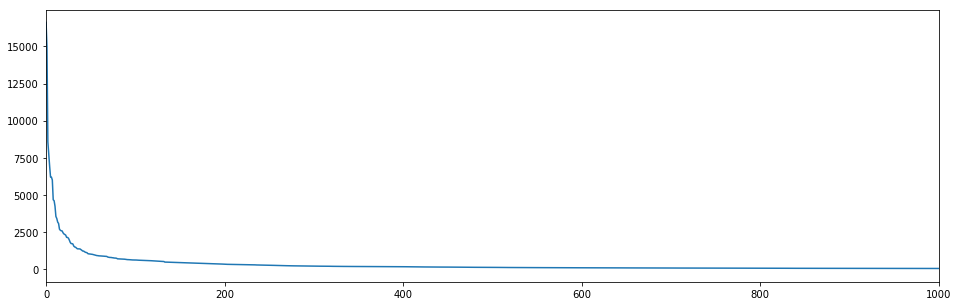

In [115]:
plt.figure(figsize = (16,5))
plt.plot(LC_Data_new1.emp_title.value_counts().values)
plt.xlim((0,1000));

In [68]:
for string in LC_Data_new1.emp_title.values:
    print str(string).title()


Ltc
Team Leadern Customer Ops & Systems
Area Sales Manager
Street Operations Supervisor
Project Manager
Systems Engineer
Teacher
On Road Manager
Medical Assistant
Surgical Technician
Parts Manager
Driver
Secretary
Assistant Director - Human Resources
Manager Information Delivery
Aircraft Maintenance Engineer
Building Maint. Mgr.
Registered Nurse
Operations Manager
Special Order Fulfillment Clerk
Auditor
Senior Designer
Information Systems Security Officer
Machinist
Dispatcher
Vet Tech
Probation Officer
Data Analyst
Claims Adjuster
Teacher
Regional Sales Manager
Lpn
Svp/Commercial Banker
Associate
Technician Support Specialist
Alarm Technician
Electronic Mapper
Business Systems Consultant
Executive Administrator
Senior Software Engineer
It Analyst
Campus Planner
Teacher
Lpn  Nurse
Hvac Technician
School Administrator
Teacher Coach
Senior Network Engineer
Lead Business Analyst
Manager
Senior Underwriter
Business Service Specialist
Customer Service Representative
Auto Body Tech.
Sales Mer

Sheetmetal Worker
Accountant
Machinist
Director Of Route Setting And Climbing
Manager
Nan
Pricing Manager
Sheetmetal Assembler
Programme Assistant
Vp/Loan Processing Manager
General Manager
Rn
Sr. Mortgage Banker
Server / Assistant Manager
Account Manager
Table Games Dealer
Sr. Account Manager
Sr Software Engineer
 Forman
Sr.Medical Economics Analyst
Storekeeper
Human Resources Specialist
Avp, Technology Services
Teacher
Support Engineer
Civil/Project Engineer
Billing Specialist
Yardman B
Business Managrt
Operator Ii
Mortgage Processor
Associate Professor
Special Assistant
Teacher
Specialist
Deputy Sheriff
Chef
Lead Project Manager
Technician
Principal
Supervisor Customer Service
Hospital Practice Manager
Cashier
Mechanic
Nan
Assistant Admin Analyst
Analyst
Engineer
Solution Architect
Associate
Teacher
Manager, Suite & Premium Seating 
Supervisor
Senior Financial Advisor
Hr Manager
Nan
Rig Supervisor
Internal Auditor
Superintendent
Accounts Receivable Specialist
Business Manager
Comput

Owner
Bpa
Deputy Sheriff
Icu - Registered Nurse
Production Supervisor
Administrative Assistant
Sales Associate
Executive Director Of Finance & Admin
Executive Assistant
Cna
Registered Nurse
Attorney
Nurse
Director
Nan
Professor
Nan
Plant Manager
Program Manager
Outside Sales Executive
Information Management Coordinator
Lead Technical Architect
Security  Officer
Custodial Supervisor
Marketing Consultant
Claim Representative
Director Of Operations
Extension Agent
Teacher
Director Of Merchandise Systems
Nan
Site Supervisor 
Operations Manager
Cbp Officer
Loan Officer
Wg-2810-10/5
Finance Director
Wellness Coordinator
Video Engineer
Cpa
Forman
Data Analyst
Courier
Manager
Sr Power Trader
Nan
Deputy Clerk 3
Athletics Business Manager
Shift Supervisor
Relief Control Operator B
Manager
Senior Team Lead - Infrastructure
Qa Manager
Supervisor
Nan
Nan
Registered Nurse
Business Development Application Enginee
Nan
Registered Nurse
De Underwriter
Rod Mill Op
Pct
Police Sergeant 
Manager
Dev Enginee

Administrative Assistant
Contract Administrator
Research Specialist Ii
Staff  Management Forestry 
Nan
Coo
Rn
Developer
Maint. Lead
Sterile Processing Tech
Nan
Director, Closing
Rn
Safety And Regulatory Specialist
Superintendent
General Manager
Veterinary Technician
Sofware Engineer / 
Nan
Reg Radiologic Tech -Clinical Instructor
Vp, Financial Planning And Analysis
Nan
Supervisor
Executive Assistant Manager
Vice President
Supervisor
Human Resource Manager
Field Service Technician
Tructure Machanic
Sales Team Manager
Nan
Tax Accountant
Special Projects
Vp Commercial Loan Officer
Nurse
Truck Driver
Senior Business Analyst
Teacher
Nan
Material Coordinator
Sr Software Engineer
Financial Controller
Manager
Registered Nurse
Adm. Asst
Nan
Manager 
Cis Project Manager
Deputy District Attorney
Otr/L
Vp Of Operations
Information Security Officer
Leasing Agent
Chief Lims Engineer
Mechanical Design Engineer
Route Sales Supervisor
Patrol Officer
Hr Director
Respiratory Therapist
Manager
Credential 

Supervisor
Sr Project Manager
Manager
It Business Analyst
Postdoctoral Fellow
Electronics Technician
Coordinator
Operater
Dir, Bd
Area Field Manager
Senior Program Manager
Hospital Sales
Senior Accountant
Business Operations Administrator 
District Manager
Finance Manager
Project Manager
Oncology Manager
Legal Writer
Executive Director
Bcr
Nan
Rn
Cartographer
Real Estate Agent
Radiology Coordinator
Teacher
Vp Of Field Operations
Electrician
Implementation Manager
Clerical/ Certified Nurse
Veterinarian
Lead Biopharmaceutical Mfg Associate
Local Truck Driver
Supervisor
Nurse Practitioner
Teacher
Chef De Partie
It Specialist
Board Certified Behavior Analyst
Store Manager
Manager
Job Foreman
Teacher
Detention Service Officer
Dispatch/ Purchsing Agent
Coordinator 
Apple Service Center Technician
Dealer Card
Process Tech
Staff Coordinator
Lead Cook-Maintainance Worker
Assistant Manager
Equipment Technician
Vp-Credit Risk Portfolio Manager
Manufacturing Technician
Nan
Eligibility Worker Ii
Sa

Information Technology Manager
Teacher
Inspector
Manager
Billing Analyst
Ced
Nan
Editor
Mail Carrier
Lead X-Ray Technologist
Claims Processing Speacilist
Associate
Manager
Nursing Aide
Supervisor
Telecom Admin
Technician
Pet Care Assistant
Account Manager
Law Enforcement
Education Manager
Billing Analyst
Employee Satisfaction Manager
Technician
Director
Legal Assistant
Consultant
Claims Assistant
Building Manager
Senior Software Engineer
Interpreting Services Manager
Teacher
Special Agent
Business Development
Property Manager
It Professional
Vp & Managing Director
Communications Manager
Tissue Recovery Coordinator
Teacher
Asst. Maintence Tech
Director Of Programming
Qa Analyst/Jr. Project Manager
Hvac Mechanic
Manager
Manager
Probation Officer
Licensed Mental Health Counselor
Loan Services Representative
Securities Business Process Specialist I
Credit Manager
Parts Manager
Project Manager
Senior Clinical Data Manager
Vp, Civilian 
Accounting Assistant
Accounting Specialist
Lead Phlebot

Asst. Director
Portfolio Advisory Specialist
Preservation Specialist
Sr. Systems Tech
Avp
Warehouse Support
Operator
It Specialist
Nan
Lead Planner/Scheduler
Pickerpacker
Nan
Sr. Security Officer
Nan
Receiver
Instructional Supervisor
Office Manager
Acquisitions
Personal Lines Underwriter
Payroll Consultant
Qa Analyst
Teacher/Coach
Elevator Mechanic
Prj Mgnt Asst
Attorney
Software Engineer Manager
Senior Doctor
Inside Sales Director
Radiology Supervisor
Nan
Sales 
Asst Controller
Speech Language Pathologist
Teacher
Senior Police Officer
Asst Credit Manager
Hotel Front Office Supervisor 
Training Consultant
Certified Medical Tech
Die Cutter Operator
Engineer
Software Engineer
Route Sales
Sci Teacher
Service Manager
Driver
Records Specialist
Asst Store Manager
Associate
Area Manager
Import Purchasing Specialist
Nan
Field Service Engineer
Director
Elevator Mechanic
Hr Manager
Control Analyst
Rn
Sales Rep
Process Engineer
Director Of Sales
Food Service Specialist Lead
Medical Management Spe

Technology Manager
Teacher
Process Eng Technician
Systems Administrator
Supervisor
Postman
Nan
Process Technician
Pilot
Manager
Mortgage Loan Officer
National Sales Executive
Dietary
Senior Consultant
Sat Verbal And English Teacher
Chaplain-Hospital Development Manager
Sales
Program Manager
Regional Chemical Mngr
Bus Driver
Dispatch Supervisor
Income Tax Manager
Staff
 Probation Officer
Nan
Radiology
Nan
Nan
Sales Support
Manager
Sr. Engineer Business Support
Supervisor
Supervisor
Vice President 
Stainless Products Mgr.
Senior Account Manager
Curriculum Developer
Nan
Nan
Caregiver
Office Coordinator
Nan
Front Office Management
Sales Associate
Nan
Tech
Medical Imaging Field Service Engineer
Transportation Program Specialist
Senior Systems Associate
Sales Associate 
Sr. Project Manager
Business Analyst
Education Director
Nan
Cook 
Rn
Vascular Tech
It Help Desk Analyst
Sr. Soc Analyst (Incident Responder)
Nurse Manager
Economist
Food Service Supervisor
Technical Writer
Nan
Department Supe

Nan
Assistant Manager
Vp New Product Engineering
Manager
City Manager
Default Specialist
Recruiter
Driver
Consumer Safety Inspector
Teacher
Banker
Billing Coordinator
Erp Manager
Engineer
Claims Analyst
Customer Service
Manufacturing Specialist
Loan Department Manager
Clinical Administrative Assistant
Manager
Talent Acquisition Manager
Registered Nurse
Lineman
Clerk
Special Education Teacher 
Superintendent
Painter
Customer Services Associates
Section Supervisor
Finisher / Foreman
Nan
Nan
Research Specialist
Assistant Professor Of Pharmacy Practice
Nan
Estimation / Sales
Programmer
Nan
Tech 1
Tax Director
Editorial Coordinator
Msa Radiology
Cementer
Crime Analyst
Building Maintenance
Sr Credit Analyst
Security Officer
Hvac Technician
Financial Analyst
Pipefitter
Service Technician
Cleaner 
Manager
Sales
Ceo
Clerk
Registered Nurse
Medical Coder 
Membership Team Lead
Nan
Resident Manager
Driver
Accounting Technican Iii
Service Manager
Manager
Admin
Associate Management Auditor
Activities

Nan
Accountant
Market Manager
Subaru Techincian
Claims Customer Service
Dept. Manger
Registered Nurse
Machinist
Sales
General Manager, Software Products
Rn
Avp, Credit Officer
Administrative Assistant
Nan
Cg Artist
Admissions Counselor
It Professional
Division Software Manager
Nan
Truck Driver
Shipping Clerk
Commercial Noc Analyst
Warehouse
Software Qa Analyst
Registered Nurse
Truck Driver
Rn
Journeyman, Leed Man
Teacher
High School Teacher
Journeyman Plumber
Housekeeping
Office Manager
Nan
Bsa Analyst
Fss
Dental Hygienist
F&B Supervisor 
Hr Manager
Director Of Icu
Conveyor Engineer
Teacher
Associate Actuary
Support Enforcement Officer
Sr Software Consultant
Analyst
Health Worker
Executive Editor 
Chef Manager
Landscape Maintenance Laborer
General Manager
Skilled Laborer
Nan
Service Writer
Med. Tech
E-6
Customer Specialist
Engineering Technician 
Regional Director
Vice President Architecture
Business Manager
Exchange Administrator
Scheduler
Pharmacist
Architect
Marketing Manager
Police

Quality Assurance 
Is Technician Ii
Hvac
Tax Specialist
Merch. Process Coordinator
Contact Manager
Project Manager
Elevator Service Mechanic
Water Operator
Senior Accounts Receivable
Merchandise Coordinator
General Manager
Operations Manager
Mechanic
Manager
Quality Engineer
Scheduling Coordinator
Senior Accountant
Teacher Aide
Fire Fighter / Emt
Clinical Consultant
Nan
Truck Driver
Field Specialist
Manager
Sleep Technologist
Legal Secretary
Front Office
Office Manager
Web Design & Management
Education Lead
Production Manager
Technical Support Engineer
Associate Professor
Receptionist
Machinist
Patient Access
Officer
Nan
Nan
Custodian
Project Manager
Nan
Vice President
Territory Manager
Mechanic
Sr Developer
Technical Support Rep
Court Reporter
Administrator
Supervisor
Legal Assistant
Nan
Rrs
Fishery Regulations Specialist
Graphic Artist
Underwriter 
Administrative Assistant
Registered Nurse 
Full Stack Developer / Seo Specialist
Care Coordinaotr
Postmaster
Produce Lead
Production Mana

Cfo
Certified Nursing Assistant
Teacher
Manager
Associate Environmental Specialist
Logistics
Director Of Sales Operations
Regional Sales Manager
Lead Inventory Analyst
Tech
Nurse
Administrative
Investigator
It Manager
Inventory Specialist
Engineer
Appeals Officer
Business Analyst
Sr. Associate, Events & Sponsorships
Senior Facilities Manager
Retention/Customer Service
Hr Assistant
Property Accountant 
Consultant
Regional Manager
Superintendent
Hrms Manager
Supervisor
Sales Manager
Vice President - Web Technologies
Financial Systems Accountant
Medical Coder
Solution Architect
Deputy Probation Officer
Supervisory Supply Management Specialist
Inside Sales
Vice President, Recruiting Manager
Loa
Electrical Test Tech
It Consultant
Accountant
Real Property Appraiser
Charge Nurse
Deputy Juvenile Officer
Insurance Broker
Gso Manager
Bankruptcy Specialist
Machinst
Training Nco
Customer Svc Rep
Legal Secretary
Registered Nurse
Manager
Admissions Rep
Management
Data Engineer
Deputy Sheriff/ Bailif

Carpenter 
Administrative Assistant
Medical Assistant
Project Manager
Warranty Adminstrator
Accountant
 Reoresentative
Financial Analyst
Manager
Nan
Electrician
Retoucher
Nan
Research Associate
System Analyst
Nan
Asisstant Manager
Research Associate
Risk Manager
Police Officer
Director
Optician
Deputy Sheriff
Sales Rep
Bookkeeping Manager I
Sales
Registered Nurse
Nan
Senior Strategist
Premium Mortgage Consultant
Manager
Secretary
Railroad Conductor
Fireman
Head Chef
Technician
Senior Environmental Planner
Nan
Police Officer
Controller
Manager
Trust Officer
Nan
Food Prep
Dean'S Assistant
Teacher
Police Officer
Receptionist 
Office Manager
Social Worker
Sales/Marketing Rep
Superintendent Of Special Traffic Servic
Senior Accountant
Machine Operator
Nan
Cpa
Consultant-Billing
Nan
Case Manager Assistant
Registered Nurse
Booter
Maintanence
Registered Nurse
Principal
Employment Services - Job Coach
Deportation Officer
Pmhnp
Supervisor
Event Supervisor
It2
Field Coordination Manager
Sr Payroll

Driver
Epc Manager
Senior Client Business Executive
Total Rewards Consultant
Sales Associate
Warehouse Supervisor
Home Supervisor
Bill Collector
Legal Assistant
Lead Enterprise Service Desk Analyst
Operations Director
Senior Principal Consultant
Payroll
Supervisor
Sr. Mechanical Engineer
Cna
Store Opener
Manager
Respiratory Therapist
Medical Billing
Warehouse Manager
Minister
Operation Tech
Production Manager
General Manager
R And D
Operatons Manager
Licensed Practical Nurse
Nan
Computer Support Technician
Academic Facilitator
President
Mechanical Engineer
Manager
Clinical Strategist
Sppech Therapist
Teacher
Leader 
Chemical Tech
Senior Area Sales Supervisor
Engineer
Adult Protective Services Worker
Auto Technician
Account Manager
Property Controller
Editor
Medical Assistant
Manager
Mail Handler
Supervison
Chef
Nan
Nan
School Counselor
Sales
Sr. Principal Analyst
Fsc
Personal Banker
Nan
Key Account Manager
Dental Assistant/Front Desk
Manager-Process
Fire Dispatcher
Field Representative

Server
Mobile Engineer
Reservations Manager
Senior Specialist
Underwriter
Manager
Marketing Communications Specialist
Legal Secretary Iii
Receivables/Dispatcher
Lead
Gm
Reliability Engineer
Truck Driver
Maintenance Supervisor
Finance Manager
Customer Service
Terminal Operator
Test Tech 2
Nan
Director Shared Services Contact Center
Office Manager
Front Desk
Assembler
Maintenance Superintendent
Shuttle Driver
Assoc. Director Of Provider Data Mgmt.
Nan
Nan
Fire Fighter - Paramedic
Director, Patient Financial Services
Staff Accountant 
Nan
Superintendent 
Director, Used Operations
Bariatric Surgery Fellow
Team Lead 
Engineering
Medical Technologist
Professor
Property Manager
Marketing
Sales
Receptionist
It Manager
Nan
Production Line Supervisor
Executive Assistant
Supervisor
Programmer/Analyst It Lead
Pastor
Custumer Service
Utility Clerk
Irs
Training Specialist
Nurse Coordinator
Computer Operator
Mortgage Underwriter
Bus Operator
Cto
Security Director
Finance Manager
Unit Secretary
Parame

Senior General Accountant
Inventory Control Specialist
Service Consultant
Field Service Representative
Paralegal Specialist/Technician
Perishables Sales
Lead Journeyman Electrician
Lead Test Analyst
Detail
Nan
Paralegal/ Office Manager
Wastewater Treatment Plant Operator
Training Operations Specialist
Admin Sec/School Bus Driver
Warehousing Leader
Ehr Specialist
Site Supervisor
Contract Manager
Registered Nurse
Account Manager
Office Manager
Executive
Sales Analyst
Registered Nurse
Environment Artist
Correction Officer
Office Manager/Accounting
Administration
Manage
Analyst
Set/Operator
Teller Coordinator
Senior Producer
Accounting Supervisor
Truck Driver
Laborer
Meat & Deli Manager
Vehicle Operations Supervisor 
Supply Chain Supervisor
Driver   
Sales
Management Analyst Ii
Consultant
Opt Asst 2
Clerk Admitting 
Store Worker
Manager
Surgical Informaton Systems Coordinator
Hwy Rep
Driver
Judicial Secretary/Court Monitor
Program Director
Document Auditor
It - Client Support
Rebar Bender


Electrician
Log Coord
Pest Tech
Research Scientist 
Corporate Trainer
Otr Driver
Buyer
Unit Manager- Loss Mitigation
Teamster
Technician
Nan
Customer Service Rep
Ap Coordinator
Cafe Manager
Scientist Ii
Professor
Accountant
Manager/Title Examiner
Production Director
Building Inspector
Nan
Chief Accountant
Welder
Health Facilities Nursing Consultant
Assistant Manager
Ceo
Computer Specialist
Associate
Rn
Manager Of Inside Sales
Subassembly Department Head
Pharmacy Technician
Rn
Env Worker 
Director
Health And Pe Teacher
Route Driver
Shipping Supervisor
Planning Supervisor
Nan
Technical Services Engineer
Spanish Teacher
County Assessor
Deputy Sheriff
Teacher
Staff Information Systems Analyst (Spec)
Medical Assistant
Production Manager
Msgt / Team Leader
Vice President
Nan
Medical Laboratory Scientist
Accountant
Director Of Marketing
Nan
Unit Manager
Senior Programmer
Teacher
Water Plant Operator
Farmer
Key Holder
Concierge
Electrical Engineer
Assistant Professor
Residential Support Provid

Legal Secretary 
Software Test Integration Engineer
Computer Tech
Munufacturing
Teacher
Server Systems Administrator
Director Of Guidance
Associate Director 
Rural Carrier
Mechanic
Technician
Manager Consolidation
Lead Retail Consultant
Rand
Redners Warehouse Markets
Yale-New Haven Hospital
Siemens Healthcare Diagnostics
Ups
Interactive Communcations
Select Physical Therapy
Newmont Mining Corporation
Disney/Abc Tv Ktrk Channel 13 Houston
Az Dept Of Public Safety
University Of Alabama
St. Louis Community College
Greater Houstontransportation Company
Nan
Anchor General Insurance
Cbsi
Litania Sports Group
Uva
Finch Paper Llc
Nan
Rwc International
Nan
Nan
Assurant
Safeway
Rosebud-Lott Isd
Fiber Labs
Worldwide Facilities, Inc
Executive Aircraft Interiors
Dept Of Veteran Affairs
Virginia Beach Tennis And Country Club
M&A Enterprises
Palm Beach Sheriff'S Office
Airmethods
Department Of Veterans Affairs
Frank'S International
Metro North Railroad
Nexteraenergy
Chapman Ford
Studio Q Furniture
Ab

Lipari Foods
Golden Valley Health Centers
Roper St. Francis Hospital
Noce Enterprises
National Pensions
Chicago Public School
Nestle Chocolate & Confection
J.Crew
Answers In Genesis
Liberty Lines Bus Company
Us Army 
Mersive Inc
Dominion Enterprises
Texas Health & Human Services Commision
Memorial Hermann Health Solutions Inc
Nasa 
Nan
Department Of Interior
Lavinstar Logistics Inc
Naf Child Development Center
Monarch Dental
Bcbsnc
John Pow 
The Boeing Company
Davita Ace Acutes
Us Army
Enterprise Recovery Systems
United Stationers Supply
Ops Consulting
West Georgia Technical College
Motion Industries
Master Lee Energy Services
International Paper
Iprospect
Western Pest Services
Paragon Honda 
Poudre School District
Liberty Mutual Insurance Company
Texas Southern University
City Of Tucson-Water Dept.
Hoffmann & Baron, Llp
Saic
Greene County Public Library
Aaa Insurance Exchange
At&T
Harborview Medical Center
Wells Fargo
Kaiser
Bison Printing
Vitals
Merced County
Tessera
Paul Davis Resto

Parentebeard Llc
Columba County
Kmart Pharmacy
Triple Canopy Inc 
Eye Care Associates, Pa
Ups
Richland Surgical Associates
Rhe
At&T
Nan
Greater Baltimore Medical Center
Oneonta Trading Corporation
Rosie'S Cantina
City Of Los Angeles
Exeter Police Department
Deltic Timber Corporation
Dw Morgan
State Of New Jersey
Msl Group
Barraco And Associates
Duke University
Us Postal Service
Darden
Republic National Distributing Company
American Hospitality Supply
First Service Residential
Us Postal Service
Cr Bard
Homeland Security
Harpercollins Publishers
Te Connectivity
Usps
Hospital Of The Unviversity Of Pennsylva
Conroe Isd
Cajun Chef Products, Inc.
Yrc Freight
Franklin Street Legal Suites
Dept Of Treasury 
Delta Air Lines
Nan
 Us Army
Community Medical Centers
Valassis Communication Inc
City Of New Haven
Us Govt / Doi / Usgs
Tower Glass Inc
9 New York
Us Army
Delta Cooling Towers
Health Information Designs
Coral Gables Hospital
National Dcp
Emory Healthcare
Ocean State Transit
Jc Penney
Automa

Select Medical
Wake County Public Schools
Gryphn Corporation
Viewray (Trinet)
Health First
Coastal Carolina University
Dyer County Board Of Education
Hudson County Dept Of Corrections
Exempla Good Samaritan
Us Army
Gettry Marcus Cpa, P.C.
Magnuson Hotel Marina Cove
Hyatt Regency Sfo
Conoco
Coastal Pulmonary Medicine
Fortress Investment Group
A-1 Express Delivery Service
New York Presbyterian
Sandhills Community College
Western Tel-Com
Five Star Ford Lewisville
Owens And Minor
Off Ramp Bike Shop
Pfizer Inc.
Jupiter Communities Llc
State Of Wisconsin 
Community Foundation Of Nj
Brocade Communications
Greenville Isd
Toyo Seat Usa, Corp.
Kai
Parkland Hospital
Lsba
Moreland Ob/Gyn
Joule Inc
Quiktrip
Fluor 
Hollywood Casino
Nan
Valueoptions, Inc.
Pinnacle Investments
Miami Dade County
Highlands Regional Medical Center
Experienced Care Inc.
Smithtown Nissan Inc.
Va Hospital
Pse&G
Lozier Homes Corporation
Loyal Loans
Lmkr
Chevron Usa
Bloomberg Lp
Siemens
Design Woodworking
Nan
Walmart Distribu

Classic Secrity
Ambius
Nan
Walmart
Casa Y Tierra Title Company
National Univeristy
Loudon County Gov
U.S. International Trade Commission
Lehman Mazda
Kessinger Hunter
Kit Masters
Service Mechanical Industries Inc.
Senate Engineering
Nan
Sagem Avionics
Rite Aid
Sysco Foods
Air Evac
S&S Construction
Birmingham Va Medical Center
Voans Pace
3Si Security Systems
Infor
Gordon Food Service
City Of Tulsa
Verizon Wireless
Equity League Healthand Trust Fund
Nan
Daiichi Sankyo Pharma Development
Cerner Corporation
Carquest  Auto Parts
Bdo
Sony Electronics
Swift Transportation
Architectural Sheet Metal
One Stop Cooling And Heating
Jasper Engines And Transmissions
Chr Corp
Sentinel Transportation, Llc
Hewlett-Packard Inc
Firecom Inc
Le Bleu Corporation
Canali
United States Cold Storage
Anne Arundel County Food Bank, Inc.
Intermountain Healthcare
Itt Goulds Pumps
Mcdonalds
Encap Investments, Lp
Manns Tower Service
Oracle
Warner Automotive
Townebank
Information Control Corporation
Community Hospital 

Bradley Marsh
Carrington Mortgage Holdings
State Auto Insurance Companies
County Of Warren
Hoag Hospital
Ridgeline Seeding & Reclamation
Rogers Ready Mix&Materials 
Office Depot
Centurion Cargo
Odlci Inc
City National Bank
D. Thomas And Associates
Usarcent
Celgene Corporation
Commonbond
Toyota Of Charleston
Ricoh Business Solutions
City Of Helena
Brantley County Board Of Education
Hp
Nan
Fisher & Paykel
Manchester Board Of Education
Federal Express 
Fbi
Nan
Stoel Rives Llp
Lieberman Production
Baylor Medical Center
Solano County Sheriff
2E Creative
Frank Lepori Construction
City Of East Lansing
Emergency Medical Service
Va Medical Center
City Of Miamisburg
Baptist Medical Center South
Kyrene School District
Dwyer Instruments
Hasco Graphics
City Of Evanston
City Of Greenwood Village
B & S Hacienda
Transam Trucking, Inc.
Nan
Law Firm
Cal & Nor, Inc
Mccallum, Methvin & Terrell
Bender Transportation 
Columbus Connection
Norfolk Southern
Utc Aerospace Systems
Hanemann Hospital
Party City
Ca

Ardagh Glass Inc.
Georgia-Pacific
Nan
Nordstrom
Korry Electronics
Nan
Simply Wireless
Skilled Healthcare, Llc
Nan
Better Wire
Kiewit
Hillsboro School District
State Of North Carolina
 Cowegas Western Cab
Nan
Nextgen Healthcare
Southern Baptist Conservatives Of Virgin
Corelogic/Stars
Nan
Nan
Citrix
Center Light Health Systems
Paypal Inc
American Red Cross
Village On The Isle
Sapient Corporation
Fdny
Dept. Of Public Welfare
La County Sheriff'S Dept
Midwest Multicare
Agaci, Llc
Nan
Embry Riddle Aeronauticle University
Federal Bureau Of Prisons
Lundbeck Inc
County Of San Diego
Nan
Cbisd
Federal Bureau Of Prisons
Cajun Grill
Verizon Wireless
Murphys Markets Inc.
Nevada National Guard
Wayne County
Riley Transportation
Us Department Of Labor
Hertz
Car Toys
Verisk Insurance Solution
Us Navy
Fabritec International
Ihop
Golden Pacific Bank
Shiel Medical Laboratory
Nan
Fifth Third Bank
Health First Inc
Town Of Narragansett
C. J. Hiotas 
Community Medical Center
Shorenstein Realty Services
Ame
Ame

Vitale & Lowe - Zurich North America
Guess Inc
Iron Mountain
Meijer
Amazon.Com
Loving Touch Homecare
Ryder Construction
Shea Family Care, South Bay
Army Benefits Center-Civilian
Bureau Of The Public Debt
Castleton Lyons
Baptist Health South Florida
Hunter Truck Sales
Haldeman-Homme
Los Angeles County Assessor
Allergan 
Mastro Imports
Ashley Distribution Services, Ltd.
Mckinstry
Groth Equipment Corp Of Louisiana
Social Security Administration
Mdc Holdings, Inc.
Timet
Nan
Msgi Corp
Synaptyk Inc
Cy-Fair Isd - Cook M.S.
Costco
G4Sgs Government Solutions
Ahmuty Demers & Mcmanus
Valley Medical Center
Fomoco Corp.
Taylor'S Demolition
Nan
Investments Ltd
Clack Corporation
Nan
Fasmart
Santa Monica Health Cater Center
Liberty University 
Worldpay Us, Inc.
Sanmar Corporation
John R Houck Co.
Nan
Midwest Sports Productions
Hers And His Plumbing
Carolina'S Medical Center
Bethanna
J P Morgan Chase
City Of Albuquerque Housing Authority
Community Bank
Dynamit
Beth Israel Deaconess Medical Center
Cable

Puget Sound Energy
Dixon Harvesting & Hauling Inc
Sperry Rail
Albuquerque Public Schools
Intergraph
Hsbc
Health Resources And Services Adm
St. Johns Hospital
Health Data Insight
Atlas Eps
Teach For America
Pilot Travel Centers Llc.
Citibank
Apria Healthcare
Navsea
Atlantic Iii At The Point
Hvac Inc.
Union County  
Ventura County Hsa
Sovereign Bank
Autobahn Motors Mercedes Benz
The Home Depot
Valley Health System
Belle Tire
Applebee'S 
Sanpro Technologies Inc
Airgas
Cipriani Usa
Sos Security Llc
Nan
Csx Transportation
Kings Counnty Hospital
Charter Communications
Perry Ellis Internation
Lockheed Martin
Progressive Insurance
Bach Bros
Verizon Wireless
Sungard Availability Services
Nan
Invenio Solutions
Harlem Children'S Zone
Dcbs
Adecco Technical
Bricklayers Local 1 
Blythe Dental Center
Northrop Grumman/ Usis Nsd
The Monroe Manor
American Intercontinental University
Western Southern Financial Group
Giant Eagle
Amherst County Public Schools
Reese & Associates, Inc.
St. Lucie Co. School B

Arkansas Childrens Hospital
Cornerstone Charter Academy
Snohomish County Public Utility
Warren Distribution
Klaussner Home Furnishings
Paklab
Kirby Offshore Marine
Grace Machine 
Dr Pepper/Snapple Group
State Of Missouri
Yrc Frieght
Jewish Home
Deloitte & Touche
H.I.G. Capital
Stone Etc Inc
Roush Management, Llc
Pinson Valley High School
Loveland Ready Mix
Best Buy
Brightstar 
Park Inc
Saratoga Hospital
Centerlight Healthcare
Income Inc.
King Soopers/Kroger
Indian River Medical Center
Social Security Administration
Yale New Haven Hospital
Nan
Cbt Company
Adrenaline Films
Georgia State University
Pinnacle Production And Mfg.
Xto Energy/Exxon Mobil 
Signature Towing
County Of Chester
Nan
Center For Disease Control
First Presbyterian Church
Walmart
Redline
Williamson Hospitality
Johns Hopkins Bayview
2R Production 
Logical Operations
Arrowhead Dental Laboratory
Electric Services Inc.
Safway Services
Grapevine Colleyville Isd
Avon Orthodontics
Rasmussen College
Contra Costa County
Tts Mari

The Woodlands Development Company 
Bae Systems
Graphic Packaging
Chatsworth Park Health Care Center
Pepsi Co
Garfield Board Of Education
Global Pro Insurance
Interstate Dist. Co
Elephant Bar
Sheridan School District
Department Of Defense
Tennessee Oncology
Midwest Communications, Inc
Dothan City Schools
Blue Crew Services
Cnh America Llc
St Joseph Hospital
Washington County Sheriff'S Office
Itt Exelis
Nan
Weissman Zucker Euster 
Target
Wl Gore & Associates
Clinica Familiar Universal
Bell State Bank & Trust
Nan
Sclessinger Associates
Team Wired
Jfk Medical Center
Allison Smith Co
Promise Energy
Panther Helicopters
Nine West
B&J Bodyshop  
United States Coast Guard
Bronx Lebanon Hospital
The Hope Institute
Ablitt Scofield, P.C.
Sacramento County
Tesoro
Andrews International
Palmdale School District
Polenta Elementary School
California Department Of Corrections
Aria Hotel
Alliancebernstein
Palm Chevrolet
Healthcare Services Group Inc.
Tampa Elec Co
American Caregivers
The Oaks At Mayview


Usps
Sussman Automatic Corp
Lyman Schools
Optim Healthcare
U S Steel
Ports America
M.C.Dean, Inc.
Dfs 
United Well Control
Senior Resources Group
Toyota Town
L.W. Reinhold Plastics
City Of Enumclaw
San Francisco Unified School District
State Of California
San Marcos Unified School District
Point Blank
Orgill
Greenbrier Schools
Holbrook Electric
Fellers
Cn Cash For Gold
Cornell University
Nan
Georgia State University
Consolidated Bachelors Quarters
Ensign United States Drilling
Wawa
Metropolitan Group
Jcl N Mountain Hospital
High Mountain Transport, Llc
Genzyme
Nan
Sysco West Coast Florida
Wavsys
Alternative Veterinary Hospital
Hyannis Fire District 
Peppermill Inc
Nationwide Insurance
Yusen Terminals Inc
Ernies Truck Plaza
Nan
Sonoma Superior Court
United States Postal Service
Alaska Railroad
Aspen Of Dc 
Irving Isd
Pinnacle West
Homemakers And Companions Co,Inc
Us Dept Of Housing And Urban Development
Business And Decsion 
Bolder Nonlinear Systems
Boa
City Of Lincoln
Navajo Nation Gam

Silverado Senior Living
Office Depot / Tech Depot
Dollar Bay - Tamarack City Area Schools
Winthrop University Hospital
Broadvox
Public Service Of Nh
Us Military
Producers Gin
Charles Schwab
Kleinfelder Inc
Rcis
State Of New Jersey, Judiciary
Crackers And Co. Cafe
City National Bank
Scotch Plains Fanwood Board Of Education
University Of Illinois
Nyc Dot
Mens Wearhouse 
Loring Ward
Oracle 
Prowers Medical Center
Activision
Ccsd
Lowe'S
Ttuhsc
Bank Of America
Baptist Orange Hospital
Bishop'S Glen Health Care Center
Isis Services
Comcast
Zsgenetics Inc.
Freestone County Clerk
Royal Technologies
American Express
Chester County Dept Of Emergency Service
Social Security Administration
Nan
Urban Pathways 
Ames Tool Company
Drug Enforcement Administration
Regional Health Services
Kellogg'S
Military
Teva Neuroscience
Fir Ridge Holstien Farm
Delta Airlines
The Chefs Warehouse
Defense Security Service
Mary'S Club
Lowes Companies
Target
Morgan Stanley
Lincare
Abbott Capital
Vera Cadillac
Home Depot


Manatee County Ems
Nan
Ty Cobb
Vns Ny
Softcon Usa
Premium Leasure
Missionvalley Bank
Otter Products, Llc
Crestwood School District
Information Innovators, Inc.
North Coast Tile & Stone Inc.
Lockheed
Rutledge Pike Electric Company
Dendreon
Legal Services Plan Local 237
Nycdep
Lee & Fairman
Defense Logistics Agency
At&T 
Runnigs Supply Inc
Greenberg Costle
Action Early Learning Center
Friedmans Appliance Center
Ec Porter Iga
Sandil Consulting Llc
Oceanside At The Pier
William Beaumont Hospital
Paragon International
Nan
Common Sense Ag Service
Ceva Logistics
Bluecross Blueshield Of Tennessee
Macomb County Habitat For Humanity
Wal-Mart
Harvard University
Chevron
Nc Dot
Mei Llc
Icc
Nan
Nan
Lockheed Martin
Comcast
Treadwell Enterprises
Umhs
Nan
Terracon Consultants, Inc.
Inscope International 
Walmart
Webcor Builders
State Of California
Parkview In Home Aide Service
Nan
Allegiant Air
Pilot Flying J
Nan
State Of Ohio
Kforce Inc
Hospice Family Care
Pridestaff
Livingston International
Grambling

Highland Bank
Granda Sales Corp
Treo Solutions
Ricoh Americas Corporation
Plaza Diner
Keystone Automotive
Yates Wood & Mcdonald
Bny Mellon
Landrys Inc. Bubba Gump Shrimp Co.
Jp Morgan Rps
Calvary Christian Academy
Oklahoma Publishing Company
Terex Us
Mainstreet Bank 
New Hope Solebury School District
Phoenixville Hospital
Cabrera Services
Us Army
Wb Mason
Klinger And Stehr
Sci Corp
Screw Machine Specialties
Beaty Chevrolet 
Us Army
Parkland Hospital
Metlife
Baltimore County Sheriff'S Office
Kone Inc.
Shop Rite
Superior Court Of California
Child Truck Line
Camp Longhorn
Rollie Williams Paint Spot
Con-Agra Foods
Consumer Financial Protection Bureau
Nordam
Sutter Tracy Hosp 
Us House Of Representatives, Budget Cmte
Strafford R6 Schools
Schwan'S Home Service
Cargill 
State Of Nevada
Us Food & Drug Administration
Nan
Valspar/Plastikote
Redwood Children'S Services
United Health Care
City Of Dover, Nh
Csm Bakery Products
Southern California Edison
Hms Holdings
Great Neck Plaza
Baltimore City 

At&T Mobility
Hilton Orlando
Consolidated Public Retirement Board
Nan
National Constitution Center
J B Bedford Llc
Highline Care Center
Broward Sheriff Office
Ups
Wasa Architects
Espn
Ceva Logistics
Carpenters Union Local 515  (Bechtel)
Winchester Woodworking Corp.
Nan
Nan
Amsurg
Lovelace Respiratory Research Institute
Manheim So. Ca
Nan
University Of Wisconsin
Kahala
St Joseph'S Medical Center
Rakuten Linkshare
Usaf
Benchmark Senior Living
Sekisui Specialty Chemicals
South Ripley Community Schools
National Cargo Bureau, Inc
Pitney Bowes
Novant Health
Perry & Brady Ent. Inc.
State Of Utah
Adp
Walmart
Weco Dist
The Walt Disney Company
Nan
Solarcity
Labcorp
Concordia University 
Jasa
Unified Fire Authority
Big State Xray
Tmci
Ciber
Owen Equipment
Garvey Corp
Dyno Nobel
Lesley University
Gci
Oregon Health And Science University
Us Navy
Kittichai
Nan
Rs Company
Heart Technologies
Herzog Contracting Corp.
City Of Chicago Dept Of Water Mangt
Nyct/Mabstoa
North Carolina Dept. Of Public Safety

Movement Mortgage
F&E Market
Trax International Llc
Toshiba America
Valero Energy  Corporation
Northrop Grumman Corporation
Wellstar Cobb Hospital
Averitt Express
Sterling Jewelers
Lovingcare Home Care Services
Anthem Blue Cross
Nan
Hilo Medical Center
Loomis Armored Llc
Fluor B&W
Dr. Donna Ebert
Bryan College
The Charles Machine Works, Inc
Usps
Arcanum-Bulter Schools
Nan
United States Air Force
Lord & King Trucking Inc.
U.S. Army
Pepboys
Verizon Wireless
Phenix Mutual Fire Insurance Co
Hewlett-Packard
Ak Steel
Columbus Regional Healthcare System
Indiana University
M&T Bank
Home Depot
Sunsuweet Growers Inc
Miami Valley Hospital
State University Construction Fund
Nan
Vibrant Pos Systems
Njdot
Blackhawk Network
Randstad
Estes Express Lines
Nan
Sprint
Bill Dube Inc 
Sanderson Pipe Corporation 
Cox Communications
North Carolina Central University
Miami Valley Hospital
Papa Murphys
Department Of Youth Services
Bae Systems
Nan
Stafford Fire And Rescue
Nan
Cox Chevrolet
Los Angeles County
Mac

Nan
Economy Transmission
University Of California - San Diego
Nan
United States Postal Service
Basf
Employer Flexible, Hr /Barron Mgmt Co
Baycare
Walt Disney Company
Nan
Lkq Corporation
Weatherford International
Bubba Gumps Seafood
Resurgent Capital Services
Department Of Defense-Air Force
Three Rivers Distributing
Math Academia
Castro Valley Pediatrics 
Carpet Express
Knox County Schools
Im Flash Technology
Middletown Honda
Davita Dialysis 
Exelon Generation
A&F Foundations
Edward Jones
F E Moran
Varsity Cycle
Huntsville Hospital
High Point University
Herson'S Kia
Lafourche Parish School Board
Spilman Thomas & Battle Pllc
Packaging Services Of Md
Gym Source
University Of Iowa
Packaging Products Corp. Llc
Nan
Miles Electric Co
Cioffi Electric
Battelle National Biodefense Institute
Arbitron
Salt Lake City Corporation
Franklin County Board Of Education
United States Postal Service
Modesto Regional Fire
Brightview Senior Living
Lodi Bd Of Ed
Nan
Conroeisd
Commercial Bank Of Texas, N.A.
Wo

Hillstone 
Colormasters, Llc
Saputo Cheese Usa
Acculytic
Ips Industries Inc
Med James, Inc.
Providence St. Mel School
Albemarle County Schools
Snl Distribution Services
Itasca Consulting Group, Inc.
Ajel Technologies Inc
Mahle Engine Components
Glenshire Nsg  Centre
Nationwide Insurance
City Of Dacono
Dillon Boiler Services O., Inc.
Veolia Transportation
Dmi Columbus Llc
University Of Tennessee
Long Fence
Mayo Health System Owatonna
Ford Motor Company
Carilion Clinic -Roanoke Memorial Hosp.
Deloitte Consulting Llp
Rdu Airport Authority
Hogan Transportation 
Cornerstone Ondemand
Nan
Mohegansun
City Of Commerce
Tek Systems
Time Inc.
Hobson&Motzer
Sunnyside Retirement Community
Children'S Hospital
Csx
Bunzl Usa
Crowne Solutions 
Management Consulting Inc.
State Of Illinois
Kmart Pharmacy
Holly Name Medical Center
Baylor University Medical Center
America Come Back To God Church
Usaf
Nan
Nstar Electric & Gas
Chimacum School District
Super Target
Jacobs Technology
Licking County Government
V

Nan
Thomas Financial
San Joaquin County Probation
Dr.Claude V.Camden,Jr
Gcs Consulting
Total Skin And Beauty Dermatology
Winco Foods
Bureau Of Prisons, Fdc Honolulu
Socal Rehab Associates Inc
Raytheon
Wells Fargo
Ernst & Young
Janssen Pharmaceutical
Eckman Freeman And Associates
Ajax Union Llc
Redwood Baptist Church
Denver Health
Mainstreet Funding Llc
Ch Robinson
The Applied Group
Alexanders
Vantage Management Services
Pennsylvania Dept Of The Auditor General
Afas
Indian Health Services
Dreamworks Animation Skg
Advanced Pharmacy Services
Pan Star Express Corp
Department Of Defense
First Madison Bank
Wells Fargo
Max Restaurant Group
Brandmuscle (Formerly Known As Centiv)
Acl Laboratories
Kforce Inc.
Country Oaks Care Center
Transamerica Retirement Solutions
Kindred Healthcare
First Baptist Chuch Hispanic Of A.P.
Aaron G. Walker, P.A.
Maria Joseph Manor
Citizens Carpet Services
Dominion Dental Usa Inc
University Of Central Oklahoma
Schneller Llc
Heartland Miami Lakes
Catalyst Corp
Bench

University Of Maryland College Park
U.S. Department Of Defense
Blue Nami Corporation
Compassionate Care Hospice
Hostos Community College
Generations Family Health Center
Aries Inspections
Wahiawa General Hospital
Titan Contracting & Leasing
Brides By Demetrios
Appellate Division, First Judicial Dept
Amc Entertainment
Charles Schwab
Tidy Buiding Service
Jp Morgan Chase
Honda Finance
City Of Fort Worth
Richardson Molding
Case Farms
University Of Washington Medical Center
Nan
Florida'S Natural Growers
Csula
Ups
Nan
Flat Iron Grill
Baker Hughes
Department Of Justice
Kuehne + Nagel Inc.
Cleggs Termite And Pest
Career Counseling & Consultant
Humansville Public School
Vivage Cambridge Care Center
Silgan Containers Corp
Petsmart
Us Army
Vantage Apparel
State Of Nj
City Of Stuart
Okaloosa County Sheriff'S Office
California Investors Escrow
Blackrock
Hard Rock Concrete
H-E-B Plus
Mohammad Maghami
Rcsd1
Maxim Healthcare
Wyomingcounty Community Hospital
Virginia Employment Commission
Lau Associate

Brigade Capital
Department Of State Hospitals
Capital Community College
Tgh- Tampa General Hospital
Sterilmed
Private Chauffeur Club
State Of New Jersey
Milton Academy
Thuillez Ford Gold Butler And Monroe,Llp
Bnsf Railroad
U.S. Army
Medsynergies
Coldstream Farms
Carefusion
The Forum
Nan
Local 43
Fedex Services
Advanced Picc Specialist
Massapequa Schools/ Pension From Garden 
Point Breeze Credit Union
Veterans United Home Loans
Pinellas County Sheriffs Office
Pnc
Fairfield Inn/Marriott
Sedgwick County
American Medical Response
Nswc Dahlgren Division
Dell Inc
Qctl
Greater New Bedford Voc-Tech
Coca-Cola Refreshments
Hagel & Coulter 
Txdot
Labette Health 
Amtex
Turner County Board Of Education
First Courier And Logistics
National Park Service
Sidonline
Ar Metallizing
Triad Isotopes, Inc.
Haralson Tire Company Llc
Higgs Fletcher & Mack 
Cancer Treatment Centers Of America
Ford
Elavon Inc.
Community Hospital
Paypal
Wdw
Walgreens
U.S. Air Force
Yolo County Dess
United States Government
Sirote

Metropolitan Water District
Golden Living Center
Best Western
Liberty Mutual Insurance
Nan
Nissan Of St Charles Il 
Dana Corp.
Metlife
Ferrellgas
News Corporation
Elder Care Pharmacy
Mvea
Sun Chemical Corporation
Vitran Express
Nan
A Storage Place
Price, Hamilton & Price, Chtd.
Fis
Sme Inc Usa
Pcc Airfoils
Kenexa, An Ibm Company
State Of Connecticut Dept Of Correction
Northrop Grumman
Express Jet Airlines Inc.
Perdue
Pershing.Co
Buffalo Board Of Education
A T & T
Ace Group
Pepsi
Lafarge
Navistar Inc.
U. S. Dept. Of Hud
Meriwest Mortgage
Nan
Nyc Transit Authority
Hentzen Coatings
Ejm Solutions, Inc.
Echo 
Wolfe Tree Service
Northern Kentucky Health Dept.
Walmart
Nan
City Of Baltimore
Sage Electrochromics
Ahmp
Upmc Health Plan
Novitas Solutions, Inc.
Trading Technologies Itnl
State Of Nj South Woods State Prison
Celenia Software
Andaz Wall St
Escambia Tax Collector
My It, Llc
Us Navy
Taylormade Adidas Golf
Dr. Jeffrey D. Gaber And Associates
City Of Las Vegas
Carpenter Company
U.S. Depar

Herb Weisser, P.C.
Dassault Falcon Jet
Corinthian Colleges, Inc
Metropolitan Airports Commission
Usps
Veritext 
Opm/Don Strategic Systems
Kaiser Permanente
Morgan Stanley
Voxeo
Department Of Defense
Morris Elementary
Department Of Defense
Ess Brothers And Sons Inc
Inova
The Mountain Corporation
Air Products And Chemicals
Cvph
Saint Joseph High School
The Hertz Co. 
Meei-Ling Chen A Professional Law Corp
Aetna Inc
Gsf Saefway
Sc Builders
Richard White Painting Inc
Theracare Inc
New York City Police 
Fdg Logistics
St. Davids Namc
N.J. Dept Of Corrections
Whole Foods Market
Vinal Tech High School
Sugar House Day Spa
Jack B. Kelley
Us Postal Services
St Aloysious Orphanage
Hewitt Enterprise
Cms
Conagralambweston
Vantiv
Sodexo
Lmc Enterprises
St. Peter'S Hospital
Oregon Technical Assistance Corporation
Capgemini Consulting
Verizon Wireless 
T-Mobile
Kaiser Permanente
Manpower Inc
Clark Pacific
Guilford County Schools
Richemont N.A.
Hospira Inc.
Nesbitt Cont. Co. Inc.
Charles R. Drew Univers

Mt. Vista
Tmk Ipsco Koppel Tubulars
Three Saints Bay
At&T Mobility
Cbc Companies
Santa Ynez Band Of Indians
John Ray & Sons
Southwest Securities Fsb
Honeywell
Miami-Dade County
Ultimate Medical Academy
Aviv Centers For Living
Sam Far 
Jet Propulsion Laboratory
Stephenson, Chavarri & Lambert, Llc
Nan
Abbvie Bioresearch Center
Bestcare Inc.
Colliers International
Bpr Properties
Goldstick Weinberger, Pc
Nan
Adventist Health System
Arkansas Highway  Dept
Yetter Coleman Llp
Gateway Bank
Symantec Corporation
Ameristar Casino
Oracle
The Roanoke Times
Core
Scattered Oaks Inc
Peoples Home Health
Nan
Starboard Communications
United States Conference Of Mayors
Carlson Logistics
Toliver Ford Lincoln
South University
Nan
Davivienda Intl
Chicago Public Schools
Texas Health Resources
Cadient Group
Social Security Administration
Tagged
32Nd Street Surgery Center
Fibich & Associates
Rex Radiator Sales & Distribution Inc.
Mckesson
Nan
Ihg Staybridge Suites
Eastern National Bank
U.S. Steel
Wells Fargo
Be

Perigen, Inc
Covenant Baptist Church
Low, Ball & Lynch
California Medical Association
Tri-State Well Service
Alterra
Nan
Ciraco Electric, Inc.
Aubrey High School
Ruiz Foods
Sprint Corp
Burns & Mcdonnell, Inc.
Pcl Construction
Nan
Kansas City Southern Railroad
Kpmg
Omron Oilfield And Marine
Swiss Post Solutions
Credit Suisse
Cartersville City Schools
Dove Data
Prairie Farms
Garden Homes Management
Wellpoint
Nv5
Emcare
Nan
State Of West Virginia
Nan
Walmart
St. Barnabas Hospital 
Sandata Technologies
County Of Riverside
Advanced Micro Devices
Citi Bank
Service Roofing
Capital City Nurses
Con-Way Freight
Winn Residential
Nan
Oakwood Rehab And Skilled Nursing
Warehouse Services Inc
Nan
Calcasieu Parish School Board
Texas Health And Human Services Commissi
Hsa
Malcolm Thompson And Associates
Dept Of Homeland Security
Brandprotect
New York Center For Rehab And Nursing 
Hochunkgaming/Blackriverfalls
Saama Technologies
Incnetworks, Inc.
Clackamas Ferderal Credit Union
Luthern Social Services
C

Nan
Nan
Centurion Medical Products
Nypro Healthcare 
Stryker Sustainability Solutions, Inc.
Webb City Schools
Dept Of Army
Ucla
United States Postal Service
Northern Erie Lanscape Maintance Co.
Healthcare Innovations
Middleoak
Morris & Bergen County Irrigation
University Health System
The University Of Chicago
Blindtek
Nan
Jimmy Pete'S Bar & Grill
Bureau Of Labor Statistics
Navy
Thyssenkrupp 
Senior Health Associates
Community Care Physicians
Dsny
Masimo
Paul Mccarthy Studios Llc
Bcpss
Sugarhouse Casino
Bureau Of Emergency Communications
Gvna Healthcare Inc.
Arinc
Sears Holdings
Equator, Llc
Bcbg Max Azria
Albaugh Inc
Foodland
Autoline Industries
Customs And Border Protection
Williams-Sonoma, Inc.
Isatori, Inc
Hogan Lovells
Lake Sunapee Bank
Berryessa Union School District
Unified Grocers
Stifel Nicolaus
Certified Fire Protection
Colorado East Bank & Trust
Forestethics
American Governor Company
Days End Pictures
S.A.I.C.
Department Of Public Social Services
Caci
Nan
Image Engineering G

Miami Beach Resort & Spa
Prudential
Regus
Pepsico
Lovelace Health Services
Blu Perspective
A Thomas Farrell Law Offices
Mcdermott Will And Emery Llp
Terex
Southern Wine & Spirits
Perfect Smile Dental Care
Barrios Technology
County Of Riverside Mental Health
Hoyfox Automotive Market
Learnvest Planning Services, Llc
Indemand Networks
Valero
Bupa Latin America
Service Chevrolet
Ivy Tech Cc
Cushing And Dolan Pc
Aceituno Dentistry
Federated Kelly Transportation
Alexandria Toyota
Mcdonald'S Corporation
Quest Diagnostics
H.E.B
Bonneville Transload Inc.
Cliffs Auto Service Centre
City Of Highland Park
Chrysler
Gefen Llc
Mat Su Regional Medical Center
Southern Star Inc. Dish Network
Walgreens 
Kaiser Permanete Hospital
Congress Of Ct Community Colleges
Union Pacific Rail Road
Rensselaer Polytechnic Institute
Northrop Grumman
Wright County
Sharp Healthcare
Ryder System, Inc
Lithia Motors
Ihop
Mass. General Hospital / Harvard Medical
Methacton School Distict
Distrivalto Usa
Parker And Sons
Wells 

Nan
St. Joseph County Police Department
Usps
Kahoots
Optim Healthcare
First Premier Properties
City Of New Orleans
Wells Fargo
Braintree Public Schools
Nan
Unr
Securitas
Pricewaterhouse Llp
Usps
Nan
Meijer, Inc
American College Of Cardiology
Wakemed
Fis Management Services Inc.
Galena Park Independent School District
United Parcel Service
Capital District Ddso 
Checkers
Starlight Children'S Foundation
Newark Community Cooperative, Inc.
Usss, Dept. Homeland Security
Wal Mart
Maricopa Integrated Health System
Us Army
State Of California- Department Of Corre
Bnp Media
Standard Management
Equity Residential
Coletti'S Construction Inc
Yap.Tv
Austin Police Department
Medline Industries
Uc Irvine Medical Center
Jsl Transportation
Jacks Tax Service
University Credit Union
Kpix-Tv
Compassion International
Fedex Express
Macandrews & Forbes
Action Advertising & Marketing
Travis County
State Of California
Rba
Caltrans
Bodycote
Nan
Juniper Networks
Msco Medical Center
Nan
Pearson Vue
Nan
Maersk Age

New American Funding
District 113
County Of San Diego
Display Source Alliance Llc
Nan
Boston Children'S Hospital
Drs 
Coleman World Group
Dependable Septic Systems
Emerging Health Information Technology
Pathways Community Hospice
Nan
Rbj Software, Inc.
Crestron Electronics, Inc.
Stuart M Perry
Xerox
Apria Healthcare
Nan
Alice Isd
Apex Systems, Inc
Eli Lilly
Tompkins Trust Company
Department Of Defense
Des
Us Government (Hud)
Repro Products Inc
University Of North America
Macy'S, Inc.
Bank Of America
Coos Bay-North Bend Water Board
St. Vrain Valley School District
Transportation Concepts
Pomonok
Team Washington Inc
Global Consulting Inc
Freedom Medical
Roy N Kaldestad,Dds,Ps
Western Federal Credit Union
Rice Pugatch Robinson & Schiller, P.A.
Polywin Corporation
Deerfield Correctional Center
Summit Medical Center
Amtrak
Texas Health Resources Harris Southwest
Global Alliance
Northern Trust
Mgm Resorts Int
Nan
United Agriculture Benefit Trust Fund
Yrc Freight
Newburgh Enlarged City School

Nan
County Of San Diego
Bagasse America Corp
Valueoptions
J C Steele
University Of Arizona Medical Center
Radioshack
Buck Hill Falls Co.
Schindler Elevator Corp
Fresenius Medical Care
Stockton Unified School District
Millennium Pharmaceuticals Inc
Toyota Motor Manufacturing Indiana
Excelta Corporation
Usps
Brigham And Womens Hospital
Calvin Klein/Pvh Philips Van Heusen
Microsoft
Alliance Beverage
Brookhaven Mri
Nan
Department Of Interior
Hurley Medical Center
Integrity Rebar Placers
Sovereign Bank
Us Army
Turlock Scavengers Company
Entech Sales And Service, Inc
Samaritan Medical Center
Nan
Readerlink Llc
Clear Channel Media & Entertainment
Medifast
Mobile Infirmary Health Systems
Hireright Inc
Dept Of Navy
Dutch Corporation
Moresco Distributing
Olympia Eye Clinic
Climatec Btg
Sbsi
Nexteer Automotive
Wyndham Worldwide
Medica
Weston And Sampson
John Cataldo Architects
Harvard University
Jump Trading
Stop&Shop
Lowes
3Gm Steel
Murataps
Gus Home Improvement 
Dod Army
Federal Aviation Admini

Ups
Dod Civilian
Ibm Global Services
Nyc Department Of Education
Sebastian Sign & Crane , Inc.
Volvo Construction Equipment 
United Concordia
Northeast Document Conservation Center
Us Dept Of Labor
Dickinson Press Inc.
Central Consolidated School District #22
Midwest Health 
Us Postal Service
Njdoc
Claus Construction
Yrc
M.S.Walker
Texas Pipe & Supply
Kaycan Ltd
 Dr. John Lipani
U.S. Dept. Of Interior
Cook Children'S Medical Center
Lord And Taylor
Tower Federal Credit Union
Purdue University
Richter Precision Inc.
Usaf
Hospital
Us Air Force
Main Street Graphics
Madison Metropolitan School District
Sodexo At Keuka College
Logistics Systems Inc
Royal Imex 
Rainmaker
Stark & Stark
Hilton Washington
Virginia Hospital Center
Denihan Hospitality Group
Dhs/Tsa
Hms Host
School District Of Philadelphia
Dept Of Defense
Boys & Girls Clubs Of Arlington
Brandsmart Usa
Bally Technologies
Capgemini Consulting
Evon Wong
The Boeing Company
Assurant Specialty Property
Adams 50 School District
Berkley Av

Mckenna Long And Aldridge
Nan
Securenet Llc
Suntrust Bank
Jamestown Area School District
United States Postal Service
Long Beach Unified School District
Ubm, Llc
Moore Excavating Inc
Symitar
Infinity Home Health Care, Inc.
Computer Sciences Corp
At&T
Thyssenkrupp Presta
Scottish Rite Center
Presbyterian Manors Of Wichita
River Rock Casino
Starwood Hotels And Resorts
O.T.S. Inc
State Of California - Edd
Innovative Refrigeration Systems
Oreilly Auto Parts
Marie Callender'S
Sheriff
Joseph Chambers
Safeway 
Comerica Bank
Tiny Prints
Csuci
Cypress Avenue Animal Hospital
Ernst & Young
Millercoors
Reagal Entertanment Group
Comcast
County Of San Bernardino
Child Dental
Us Postal Service
Pomona Valley Hospital Medical Center
Reed Elsevier
Pinellas County Schools
Transportation Security Administration
Luxottica
Micro Probe Inc.
Pouschine Cook Capital
Woodbury Nissan
R&L
Ascip
U.S. Army
City & County Of San Francisco
Gary K. Fujinami
Hotel Shattuck Plaza
Usaf
Alliant International University
Holi

Minuteman Arc
Health Data Management Solutions
Deertrail School District 26J
Caterpillar
New Orleans Casino
Franklin University
Nan
Hawker Beechcraft
Vasso Waste Systems
Nan
Nan
Good Samaritan Medical Center 
Ozark Guidance Center
Hoffman Construction
Maximus
Elizabeth Arden, Inc.
Buffalo Gap Saloon
Parker Hannifin Corp
Bath And Tennis Club
Chase Bank
Southern Oil Transport
Renco Machine Co
Us Airforce
Mueller Roofing Distributors
Cedar City Coca Cola
Criswell Funeral Home
Smithfield Packing Co.
L.A County Office Of Education
Iupui University Library
Dow Chemical-Sco
Lou Rich
Reg
Cox Communications
Statewide Credit Assn/Imc Credit Service
Belk
Issaquah Signs
Hd Supply Waterworks
Microsystems Inc
Honda Of Freehold
X5 Manufacturing
Bae Systems
Nan
Nan
Firebaugh-Las Deltas Unified
Nan
Lausd
Nan
Anchor Bank
Nan
Blue Diamond Disposal
Repsol Usa
Nan
Internal Revenue Service
Nan
Bechtel Corporation
Delta Air Lines
Hsn
Siouxland Surgery Center
Nan
Port-O-Call Hotel
Einstein Medical Center
Walm

Nabors Drilling And Completion
Republic National Distributing Company
Salesforce
Yonkers Public Schools
Froedtert Healthcare
Rbc Capital Markets
Automatic Data Processing Inc
Rite Aid
Wells Fargo Bank
Sociofabrica
Glen Rose Isd
Unitedhealth Group
Nan
Brightnow Dental
United States Air Force
County Of Tulare
Cemex
Hms Interiors Inc
Bank Of America
Opus-Ism Llc
Internal Revenue Service
Harris Teeter Inc
The Mitre Corporation
Us Army
Nan
Nan
Quincy Deli Mart
Nan
Massmutual Life Insurance
Arrow Shed Llc
Nj Transit
Time Warner Cable 
Tj'S Auto And Collision Center
Alcatel-Lucent
Acco Engineered System
Gila Regional Medical Center
Environmental Quality Management
Nan
United Way 
Pacific Gas And Electric
Nys
Dbhdd, Atlanta, Ga
C+R Research
U.S. Office Of Personnel Management
Nassau County Police Fcu
Insurance
Selland Constuction
Autoworks Diagnostic And Repair
Devon Energy
H&M Trucking
Local Government
Village Of Brookville
Ucla Ronald Readan Medical Center
Nan
Hsbc Securities
United Nations 

Stater Bros.
Certified Power, Inc.
Vornado Realty Trust 
Usairways
Dhs
Public School District
Empire Computer Services
Pauls Oilfield
Volusia County Government
Winco Masonry
Hopland Sho-Ka-Wah. Casino
First Communications
Dennis Dequette
Navistar
Brenntag Great Lakes, Llc
Professional Aviation  Management
Ice River Springs
Edgar Online, An Rr Donnelley Company
Thermo Fisher Scientific
Ac Transit
Jp Morgan Chase
Federal Aviation Administration
State Of Connecticut
United Airlines
Ubu Sports
Ford Motor Company
Army
Calo Research Services
Morgan Stanley
Nan
Department Of The Interior
Adp
St. Alexius Medical Center
Nexenta
Loreal Usa
The Par Group
Microbac Laboratories, Inc
South Colonie Schools
Nan
Awnings Of Hollywood
U.S. Army
Cochise County Juvenile Courts
University Of Colorardo
Ward-Henshaw Construction Co; Inc.
Webster Univ.
Portland Providence Medical Center
Jp Morgan Chase
Ces
Arizona Lotus Corp.
Anaphora, Llc
At&T
Progress Rail Services
Hillshire Brands
Bank Of North Carolina
Net

Bayer Corporation
Vestas
St Johns Medical 
Ascension Parish School Board
Fort Bend Isd
Source Substrates
Sundt Construction
Rio Tinto
Crockett Elementary
Ross Stores
Aera Energy, Llc
Ubs
Nan
Mendes & Mount, Llp
Texarkana Independent School District
Fertility Institute
The University Of Central Arkansas
Huntington Hospital
Mta
U.S. Government Military
Menswearhouse
Nan
Intermountain Electric, Inc.
Canberra Industries
Federal Government
First Niagara Bank
Windstream Commuications
Booz Allen Hamilton
Franklin County 
Nyco 
Usmc
Cargill Incorporated
Baylor Health Care Syatem
Smith And Associates
Wertsch Vision Associates
Bae Systems
Multi Chem
The Living Room
Oakhilll School
Ford Motor Company
Fsrinc
M&M Mfg. Co.
At&T 
David Bohnett Foundation
Fcc Services, Inc.
Childrens Medical Center
Fox Ford
Oce
Herb Connolly Acura
Reliable Tank Line
Siamese Kitchen
Stop N Shop Supermarket
Milliken
H&K International
Kingsbrook Jewish Medical Center
Texas Capital Bank
Marriott International Hotel
Horry 

Jive Software
Connecticut State Dmv
Chandler Regional Medical Center
Memories By Design
United States Air Force
Wake Co Public School System
Thyssenkrupp Bilstein
Tween Brands, Inc
Gensler
Saddlebrook Construction, Inc.
Alice Independent School District
Energy Resource Technology
Swisslog Translogic Corporation
Ucla
Home Depot
Aerodyn Wind Tunnel
Labcorp Of America
Nan
Ferguson Enterprise
Paramount Equity Mortgage
Davis-Paige Management Systems
Mumm Napa Valley
Avaya Inc
Post Office
Frito Lay
Nan
Wheaton Franciscan Healthcare
Bankers Hill Bar And Restaurant
Robert Wood Johnson University Hospital
Rec Silcon
Sav-Rite
Lockheed Martin
Apollo Inc
Advance Auto Parts
At&T
Dod
Nan
Hayden Industrial Products
Premier Access Insurance
Vchc
Golfsmith
Department Of Health
Stanford Hospital And Clinics
Navy Federal Credit Union
Suncoast Post Tension
Restoration Technologies
Premier Dental Care 
Edwingouldservices For Children And Fami
Dod
Insight Investments
Nan
Venkany Inc 
Home Depot
Dunes Reside

United States Air Force
Robert Bosch
Boeing
Yokohama
Hologic Inc
Henry Ford Health System
Caresouth
Nan
Tacna Services Inc.
Fresenius Medical Care
Martingale Wharf Restaurant
Texas A&M University
Roy'S Kaanapali
Miami Children'S Hospital
Nan
Ford Motor Company
Csu Channel Islands
Cvs Caremark
Jarrow Formulas 
Ocean Medical Ctr  Brick Nj
Circuit Court Of Lake County
Dr. Scott Press
Dcs Federal
Marken Llp
First Energy
Teradata, Inc.
Northrop Grumman
Security Paveing
Aep 
Pacific Beach Dental
San Diego Gas & Electric
Pwc
Newyork-Presbyterian Hospital
Baylor College Of Medicine
Bank Of America
Rockbridge Wealth Mgmt
Le Pain Quotidien
Comprehensive Care
B. Braun Medical
Usi
The Boeing Company
Hilton Waterfront
Fragomen, Del Rey, Bernson, Loewey, Llp
Nan
City Of Conroe
Emigrant Bank
Lands' End
Lamesarv
Sarnoff 
United States Marine Corps
Consol Energy, Inc
Target Corporation
Ness Technologies
Callidus Software Inc
Hope, Inc. Rancho Cucamonga
Almac Clinical Services
Local Union 351
Kangaroo E

Nan
Orange County Public Schools
Capgemini
Oroville Hospital
Adventist Glenoaks Hospital
Northrop Grumman
Cargill
Ag Industries
Catedral De Fe Ministries
A.O. Dayspring
Us Army
The Hathaway Group
Nan
Kaiser
Wienerschnitzel Franchise
Chilis/Muy Mucho Group- 2Nd Applebees
Pdc Energy
Family Leisure Of Little Rock
Unitedtrazaction
Atrc, Inc
Veteran'S Administration
United Surgical Partners
Brookdale Hospital
Tiff'S Treats Cookie Delivery
State Of California 
University Of Kentucky
7-Eleven Inc
Wells Fargo Bank
Lord Abbett
Comcast Cable Tv
Insight Direct Usa Inc.
Frito Lay Inc.
Walgreens
Compass Group-Morrison
Nyu Langone Medical Centre
Arbor/Rescare
Monte Carlo Hotel & Resort
Amerimed
Johnson Controls
Barnes & Noble
Wells Fargo
Usps
Methodist Health System
Cypress Private Security
Mercedes-Benz Of White Plains
Masco Contractor Services West
Colorado State University
Americold 
Walmart
Mcdonald'S
The Judge Organization
San Diego Marine Exchange
Sleepy'S
Brickman
Charlee Of Dade County
Webb 

Sacred Heart Nursing Home
State Of Utah 
Zia Trust
Sysfore Technologies
Edgewood Academy
Exifast, Inc.
Cac Industries
Samaritan Health Services
Juniper Village
Indsoft
Titeflex Aerospace
Nan
Nan
Dbu Construction
Nan
Quintiles
Fedex Ground
Davita
Occupations, Inc.
Nan
Wells Fargo Insurance Services
K&L Gates Llp
Nan
Employed
University Of California Los Angeles
Gm
Art Center College
Homland Security / Tsa
Walsh Carter & Associates
Avon Park Youth Academy
Nan
Abbott Labs
Department Of Defense
Ast Systems Us
Jack In The Box
Legacy Salmon Creek Hospital
Millenium Comm
Crs
Mce/Agrium
Federal Assist
Econolodge
Woodway Financial Advisors
Paychex, Inc.
Dade Paper
Ready To Roll Transportation
Foodlion Disterbution Center
Fidelity Investments
Fishbones 
Task Force Tips
City Of Hope
Southwest Behavior School
Harry Miller Co
Texas Quality Medical 1
Saylor Lane Health Care Center
Lancaster General Hospital
Crossmark (Chi Management G Pr)
Bed Bath And Beyond
Taj Consulting
Alzheimer'S Association
Ti

Confluence Watersports
Yoshino America Corp.
Nan
Cass Information Systems
Chukchansi Gold Resort & Casino
Planet Hollywood Hotel
U.S. Postal Service
Sierra Madre Congregational Church
Dental Corporation
Ulta
Sierra Instruments
Elevation5221
Beverage Wholesalers Inc
Laramie County Schools
Metco
Ace Cash Express
Nyc Police Department
Sports South, Llc.
Bank Of America
Boot Barn Inc
All About Wig,Inc.
Space Systems Loral
Campbell County Schools
Performance Food Services
Opm
Franklin County Board Of Education
City Of Santa Clara
Coventry
Department Of Homeland Security
Dm Clinical Research
Nan
Us Navy
Omnicom Media Group
Wellness Source
Livingston Area Transportation Service
Department Of Veterans Affairs
Ics
Palmetto Corp
Woodward Hrt
Patrick County Sheriff'S Office
Public Relations Society Of America
National Forest Foundation
Sourceone It, Inc.
Jme Automotive
Csx Railroad
Fads
Henry County Schools
Cvs Pharmacy 
Belvedere Club
New Horizons Resources
Markel Corp
Sears 
Pier 1 Fish N Chips

Brinks Inc
Metlife Bank
City Of Ocoee
Nan
Yrc Freight
Meyerjabara Hotels
Nationalgrid
New Penn Financial
Healthcare Partners
The Valley Hospital
Public Work,S
Toledo Orthopaedic Surgeons
Sam'S Club
Oiltanking,Lllc
Biomodels Llc
Aeronca Inc
Mckesson
Maryland Dpscs
Miso, Llc
King Soopers
Guernsey Office Products
Pepsi Bottling Ventures
La Casita
Usac
American Bank & Trust
Walmart
Vanguard
Atlantic Plywood Corp.
Whiteford Kenworth
Gillman Honda
Guardian Care
Rutgers University
Medwest Ems
Dr. Regina L Lewis Dds
Emc Corporation
Weber Shandwick
American Red Cross
Nbc Universal
Old Dominion Freight Line Inc
Schnuck Markets
Union Bank
Anadarko
Los Angeles County Fire Department
Nan
Securitas Security Services
Dame Company
Los Angeles Police Department
Nan
Nan
Autotrim Design
Humane Society Of Southern Arizona
Toms River Schools
Geico Insurance Company
Core-Mark International 
Desert Vista High School
Hvi-Absmc Imagaing And Mammography
Eagle Elevator
Open Geospatial Consortium
Midas
Stevens He

Nexus Plastics
New England College
San Mateo-Foster City School District
Central Wholesalers
Williams Cos.
Concophillips
Golf Channel
Peacehealth
Cablevision
The Automaster
Montello Computer Solutions, Inc
Bethesda Memorial Hospital
Arkwright
Nan
Farmers Insurance
Compupay, A Benefit Mall Company
Eastern University
St. Vincent'S Southside
Brookdale Community College
Ge Healthcare
Just Right Carpets
Dillion
Fourth Presbyterian Church
Ocean State Jobbers
See Water, Inc.
Picture Perfect Installation
Napoleon Bistro
Nan
Nationwide Insurance
Pediatric Group 
Wr Grace
Highwoods Properties
Oregon Dept Of Corrections
Omnicom
Remington Arm
Department Of Homeland Security
Idg 
Hankins Services Inc
Nan
Robert W Baird & Co
Trans Coastal Supply Co
Nan
First Quality Maintenance
Web4, Inc
Dex One
Brown And Caldwell
At&T
Duke Energy
City Suites
Tinker Air Force Base
Banner Good Samaritan
J Iverson Riddle Developmental Center
Trump International Hotel
Roofing Trade Services
Great Southern Bank
Quest Di

J Farm Produce
Children'S Hospital Los Angeles
Department Of Defense
Wyndham Consumer Finance
Berlitz
Frisco Isd
Bosco'S Pizza Co.
Costco Wholesale
Travelers
Msi Management Services, Inc
Mwi Veterinary Supply
Crowe Horwath
Turbine Engine Center
Expeditors
New York City Law Department
Pike Electric
Post Road Iron Work
Gloucester Twp Fire District 4
Hess Corporation
Fremont Bank
Conair Corp.
Coldwell Banker Caine
Pearl Garden Manor
Stater Bros
Ihc Health Solutions
Kelloggs
Beh Israel Medical Center
U. S. Postal Service
Village Of Palmetto Bay
Ucla
Sterling Automotive
Pilgrims
Allegiance Staffing
Cc-Ops Inc.
General Steamship Corporation
Nan
San Diego Gas & Electric Co
Enerflex Energy Services
Jim Palmer Trucking Inc
Directv
Mendoza & Associates
Us Border Patrol
Dhs
University Of Pittsburgh
Tejas Tubular
Denver Wholesale Florists
Butterfly Nails
Moby Dick
Starwood Hotels & Resorts Of San Diego
Alpha Home Care
Abec Inc.
Bob Howard Pdc
Trowbridge & Trowbridge, Inc.
John Muir Health
St Marys

Canadian National Railway
Bill Haddox Insurance
Steward Health Care Systems
Nan
Nan
Maxway
Morton Hospital
Ucsd Police Dept.
Philips Healthcare
Nan
Randolph-Field Isd
Sitton Enterprise
Memorial Sloan Kettering Cancer Center
Kcbs/Kcal-Tv
Roundy'S Rainbow Foods
Lake Merwin Campers Hideaway
Cms Management
Verizon
Special Olympics Southern California
California Institute Of Technology/Jpl
Arcularius Ranch
Hospital Shared Services
Freeport Mcmoran
Alameda County Public Defender
Navy
Columbus Police Department
Century Design & Graphics
Upmc
Wells Fargo
Neiman Marcus 
Citibank, N. A.
Whitneybell Perry Inc
County Of Kern
Nan
Nail Supplies Unlimited
Jpmorgan Chase
Seward & Kissel
Fulton County Sheriffs Office 
State Farm Insurance
Ave Maria School Of Law
Kerr And Wagstaffe Llp
Safeway Foods
Texas Roadhouse
Utility Solutions
Nan
U.S. Department Of Veterans Affairs
Harlingen Medical Center
Jcpenney
Citterio
City Of Raleigh, Nc
Medwest Harris Hospital
Delren Assoc
Thermal Piping
Verizon
Morgan Sta

Allied Oilfield
Ibm
Duplin County Schools
Desert West Obgyn
St. Mary'S Hospital
The Depository Trust & Clearing Corp.
Dassault Falcon Jet
Womens Care Of Wisconsin
Ground Source Systems,Inc
San Angelo Supported Living Center
Florida Department Of Law Enforcement
H. Lamm Industries, Inc.
Associated Foot & Ankle
24Hour Recreational Storage
Charter Communications
Ibm
Providence Health & Services
Bank Of America
Johnson Automotive
Carrollwwood Care Center
Wells Fargo
Embassy Of Spain
Waterloo Industries
Sams Club
Parkway Auto Sales
Spectra Contract Flooring
Okaloosa Youth Development Center
Usaf
Northshore University Healthsystem
Texas Department Of Banking
Safeway Inc.
King Soopers
Beef O Bradys
Platinum Valley
Finance
Ups
Hospital For Special Surgery
Sam'S Club
Country Pure
Taylor Morrison Homes
Wwt
Abdo Publishing
Grand Wailea Resort
Groupm Esp
Kitewire, Inc.
Compusa
The Mission Restaurant
Philips Electronics North America
Local 158
Quality Computer Service, Inc.
Quality Imports
Rogers &

The Jones Group Inc
United States Post Office
Spillman Technologies
Shaws Supermarket
Jurupa Unified School District
St. John The Evangelist School
St. Joan Of Arc Parish
Bgc
Ionia Intermediate Schools
Tech Usa
Salson Logistics
Marketing Solutions Llc
American Pride Engineering
Amazon
Ihs
West Asset Management
Resonant Legal Media
Centurylink
Nan
Bcbs Fl
State Of New Jersey Judiciary
United States Bureau Of The Census
Boston Medical Group
Independence Residences Inc.
Sc Department Of Juvenile Justice
Arbor Commercial Mortgage
Td Bank
Cartus
Airborne Maintenance And Engineering
Us Army
Randalls 
Dr Smith
Volunteers Of America
Mercer County Board Of Social Services
Kas Direct Llc
Arnold & Porter
Iprospect
Good Samaritan Hospital
Georgia Film Fund Twelve
Fedex
Vol.Co.Schoolboard
Raytheon Company
Humblodt Petroleum Inc.
Toyota Assembly Plant
Alaris Companies
Baptist Health Center
Dynamicflowform
City Of New York/Hra
U S Treasury
Commerce Bank
U S Postal Service
Bulloch County Magistrate Co

Nyc Department Of Corrections
A-L Service
Emerald Downs
Columbia Bank
Longmont United Hospital
Sony
Jpmorgan Chase
Nan
Pitney Bowes
Rose Trucking
Network Data Services, Inc.
New York City Fire Department
Lockheed Martin
Los Angeles Dodgers
Nan
Microsoft Corp
Links Of London
Bbt
Chicago Northside Toyota
Electronics Expo
Wash Co Bd Ed 
Kimball Midwest
Lang Diesel Inc
Roche
Jefferson County District Attorney
Isd 2144
Disney
L-3 Communications
Volubill
Cleary Gottlieb
Premier Family Chiropractic 
Sprint
Us District Court - Southern District 
Walmart
Nyc Department Of Education
The Medical Team
Flightsafety International- Vss
Kaiser Permanente
Nan
Perry Ellis International
First Jersey Credit Union
Nan
Panera Bread
Wyo Tech Techincal Institute
Verizon
Golden 1 Entertainment
Autotrader
Biosciences, Inc
Kforce, Inc
State Controller'S Office
Dcma Orlando
Rend Lake College
Young & Rubicam
Hennepin County Medical Center
Houston Isd
St Marys Hospital
Axa Advisors
Monroe County Sheriff'S Office
La

Wells Fargo Bank
Nan
Hdr Architecture, Inc
Con Edison
The Orthopaedic Center
Lafollette-Johnson
Abba Fuels Inc
Hyundai Marine & Fire Insurance
Jp Morgan Chase
County Of Santa Cruz
City Of Yuma
Bodhtree Solutions Inc
United Parcel Service
Soa Software
Cuyahoga Metropolitan Housing Authority
Portland Community Investment Initiative
Openworks
Nan
Fischer Tool And Die
United Parcel Service
Amtrak
Us Department Of State
T&T Benefits, Inc
Douglas R Myers Od Inc
City Of Oceanside
Sports Images, Inc.
Trinity Lifestyles Management
The Lighting Design Group
Wells Fargo
Infosys Technology 
Fluidmaster
Us Department Of Justice
Take Care Health Systems
At&T
Kelley Kronenberg
22Squared
Oshkosh Corporation
Ashworth College
Macerich
Cpc Logistics
Lyon Real Estate
Nan
Tech One
Adp Oinc
Royal Concrete
Drs Technoligies
Dell Computers
Taco, Inc
Dell Inc/Nrc
Ashley Regional Medical Center
State Of Oregon
Nan
Bollingers Shipyards Inc
Sea Fuels Marine Services, Inc.
Local 1199 Seiu
Astellas Pharma Us
Cogniza

Protocall Communications
Aircraft
Hss Modular Service
Utah County Assessor Office
Tepa Ec
Samuels Jewelers, Inc.
Vi At Aventura
Uc Health
American Beverage Depot Llc
Casino Arizona
Purolator Efp/Clarcor
Us Navy
Bed Bath Beyond 
New York City Police Department
District 51
Maxum Petroleum
Stonybrook Hospital
The Leukemia & Lymphoma Society
Assa Abloy
United Parcel Service
Usps
Nan
Esther Jackson Elementary
Lockheed Martin Corp
Metalcraft Of Mayville
Nan
Union Pacific Railroad
Ultramotive Corp.
Dimension Data
Ehi
Kwik Mart Convenience Store Inc
Getty Petroleum
Warner And Pank 
City And County Of San Francisco
First Reliance Holdings
Nan
Laurel Auto Parts
Venture Manufacturing Services
Nan
Cheeca Lodge & Spa
Da Dodd
Cincinnati Childrens Hospital
Nan
National Ceramic Company
Nan
Lewis Brisbois
Finish Machined Products, Inc.
Dandy Mini Mart
Jamaica Hospital Medical Center
Wells Fargo
Federal Reserve Bank
Commonwealth Edison
Michiagn Army National Guard
Thacher Associates Llc
Winn-Dixie 
Dr G

Guardsmark
Ewhowell
Mad Mex Shadyside
El Paso Specialty Hospital
Schick Moving And Storage
Department Of Homeland Security
Gpi Corp.
Nyc Doe
Telestream, Inc.
Dale Rogers Training Center
Haydel Dertmatlogy
Gulfstream Aerospace
Vailresorts
Muto-Little
Lewis Communications
Childrens Memorial Medical Center
Hunt Refining Company
Civil Construction Contractors
Rick Hendrick Toyota
Cms Inc.
Dallas Isd
State Of Connecticut
Hatfield Family Medicine
Fcmg
Hemet Unified School District
Northwest Finance Partners, Llc
San Francisco Newspaper Co.
Raytheon Company
Assabet Machine
Pinellas County Schools
Riley Construction
Nan
Alonso, Andalkar, Toro, Facher & Mac Avo
Arlington Euipment
State Of Ct.Uconn Fire Dept. 
Miami-Dade County
Nan
Nan
The University Of Chicago Press
Mrm
Nan
Materil Delivery Service
Exempla Lutheran
Nan
Spartan Resources
Schwans Home Service 
Via Christi Cancer Center
Fidelity National Title
Wolverine Freightliner
Colorado State University
Wells Fargo Bank N.A.
Nan
National Spec

Btig,Llc
Nan
Temp Positions Healthcare
St. Colman'S Home
Sbcusd
Military 
Petit Philippe
Snapp & Associates Insurance Services 
Buchi, Inc
Bi-Mart
The Bank Of Bennington
Neuro 
Edgewood Independent School District
Exempla Good Samaritan Hospital
Hrtv
First National Bank Alaska
Goodwill Industries Of Upstate Midlands 
New Start Group
Faztec Industry
Georgia Gasket
Ernst & Young
Legal Services
Zurich Insurance Company
Lockhee Martin
Mss Solutions Llc
Alfred Dunner
Redwood Credit Union
Va Health Care System
Jp Morgan Chase
Town Of Mashpee Police Department
Sprint
Brookwood Hospital
G&G Marine
The Customer Center
Suburban Contract Cleaning, Inc.
Advanced Energy
Mmbb
Illinois State Police
L.A County Dep. Of Public Works
Air Force
Nan
Front Burner Restaurants
Nan
Nan
Dr. Miller & Rosenfeld
Brookhaven National Lab
Soraa, Inc.
United Church Of Christ
Cst Usa Inc.
Phenix City Schools
Longline Investigative Services
Cdi It Solutions
Test Quest Inc
Hsbc
Oracle America, Inc
Strategic Healthcare & 

Afm & Epf
Csi Companies Inc
Emcare
Carthage Central School
Nan
Charter Steel
Department Of Homeland Security
Nan
Nan
University Of Southern California
Garretson-Furgerson Construction
Krcr
Nissan North America
J.Iverson Riddle Developmental Center
Los Angeles County
Integrity Management Consulting
Sogomon S Hair Studio
Adidas
Ed Morse Honda
Aecom
Bsi Group
Summit Security
Isd
Chase Bank 
Us Resources Inc
Citibank N.A.
Cvs Pharmacy
Elmhurst Hospital
Montgomery County Public Schools
Roseburg Forest Products
Ubs
Algix, Llc
Filterfresh Coffee
Scott And White Hospital
Gp Roadway Solutions
School District Of Palm Beach County
Cardinal Cg
Gaeta Recycling
Greensboro Korean United Methodist Churc
Nan
Creative Tops By Ernie Inc
Telepacific Communications
The Bosworth Group
Nan
Westview Baptist Church
Auto Bodys Unlimited
Borlie Mechanical
Adp Total Souce (Specialty Manufacturing
Target Corp.
The Warranty Group
Pepsico
Department Of Defense 
Warner Bros. Entertainment
Walmart
Epic Enterprise
Sand

Vp
Rn
Assistant 
Senior Business Develoment Analyst
Director-Event Production
International Flight Attendant
Financial Advisor
Accountant
Hr Consultant
Principal
Firefighter
Staff Nurse
Supervising Engineer Ii
Mechanic
Journeymen
Senior Business Analyst
Driver
Healthcare Division Manager
Sales
Ceo
Vp Of Business Development 
Project Manager
Master Program Planner Mgr
Supervisor
Registered Nurse
Outside Sales
Teacher
Research Analyst
Flight Attendant
Project Manager
Nurse
It Specialist
Associate
Owner
Registered Nurse
Rn
Rn
Snr Technical Specialist
Server Engineer
Maintenance
Application Analyst
Owner/ Dentist
Peer Counselor
Remote Technical Specialist
Jury Clerk
Chef
Director Of Clinical Services
Letter Carrier
Systems Administrator
Assistant Manager
Detention Deputy
Vice President
Rn
Civil Engineer
Medicare Sales Rep
Jailer/Dispatch
Financial Rep 
General Manager
Universal Associate
It Specialist
Pilot
Director, Capital Planning And Projects
Planner
Wfm Analyst
Landman
Teacher
Ceo
She

Accountant
Manager
Deployment Strategist
Sales Person
Private Client Banker
Chief Of Shelter Medicine
Engineer
Loan Documentation Specialist 4
Loan Officer
Sr. Systems Eingeneer
Commercial Underwriter
Sr. Dev Analyst
Network Tech
Security Supervidor7
Administator
Installation Supervisor
Team Lead
Receptionist
Nan
Administration
Assistant Teacher
Warehouseman/Delivery Driver
Chemical Processor
Financial Advisor
Senior Designer
Security Officer
Geotechnical Engineering Technician
Spine Sales Consultant
Owner
Nan
Sales
Customer Service Rep 
Business Analyst
Nan
Team Leader
Pipefitter
On Air Personality
Processor
Manager
Business Systems Analyst
Senior Loss Control Consultant
Vice President, Operations
Behavior Analyst
Partner
Janitor
Nan
Registered Nurse
Branch Manager
Truck Driver/Warehouse
Process Operator
Laborer
Project Facilitator
Night Guest Service
Security Officer
Literacy Coach
Account Manager
Preconstruction
Business Systems Analyst
Parts Dept
It Team Lead
Utility Billing Analys

Owner
Mailhandler
Pest Control Specialist
Property Book Officer
Regional Manager
Officer
Accounting Manager
Managing Director
Commodity Manager
Sales
Nan
City Attorney
Director, Hr
Signal Maintainer
Train Operator
Technical Specialist
Coordinator
Teacher
Loan Documentation
Rn
Assistant Director
Licensed Practical Nurse
Area Manager
Senior Compliance Specalist
Staff Sergeant
Accounting Manager
Supervisor
Conductor
Sales Specialist
Rn
Nan
Safety Manager
Machinist
Hr Business Partner
Nan
Controller
Service Advisor
Certified Surgical Technologist
Teacher
Sales Executive
Teacher
Manager
Sales Mgr
Administrator - Instructional Specialist
Sales
Vice President
Welder
Assistant Principal
Nan
Utility Operator
Assistant Manager
Consultant, Frontline Learning
Configuration Management Technician
Vice President, Finance
Broker
Owner & Managing Partner
Mechanic
Web Production
President
Flight Attendant
Rn
Revenue Agent
Captain
General Manager
Channel Account Manager
Lab Supervisor
Night Staff Superbi

Paralegal
Senior Vp
Food Developer
Nan
Marketing Director
Preschool Teacher
Bell Hole Technician
Staff Auditor
Sales
Truck Driver
Educator
Teacher
Manager
Electrical
Direct Disposer In Charge
Testing Specialist
Nurse Anesthetist
Controller
Clinical Trials Coordinator
Receptionist
Corporate Trainer
Sr Technical Lead
Truck Driver
Claims
Driver
Environmental Health Specialist, Senior
Physician Assistant
Operations Manager
On Site Delivery Manage
Accountant
Teacher
Forklift
Agent
Owner
Barista
Manager
Manufacturing Engineer
Sales Manager
Program Manager 4
Software Developer
Manager
Office Manager 
Nan
Registered Nurse
Senior Hernia Sales Specialist
Registered Nurse/Admin/Dps
Nan
Nan
Front End Rep
Restaurant Manager
Maintenance Technician
Developer
Service Tech
Dealer
Document Review Specialist
Labor
Managing Member
Owner
Production Manager
Architect
Teacher
Sr Inspector
Advanced Medical Support Assistant
Nan
Network Engineer
Computer Tech
Vice President
Cad Cam Engineer
Design Assistant
St

Controller
Sales
Area Liaison
Accounting
Quality Testing Engineering
Contract Manager
Sr Member Service
Nutritionist
Office Manager
Verification Manager
Comp Engineer
Truck  Driver
Conductor
Talent Coordinator
Production Director
Drafting Specialist
Attended
Police Officer
Athletic Director/Teacher
Service Supervisor Iii
Recording Officer
Information Security Engineer
Architectural Support  Coordinator 
Real Estate Agent
Project Manager/ Principal Planner
Project Manager
Manager
Sr. Director
Registered Nurse
Senior Designer
Division G4
Lab Tech
Programmer Analyst
Fire Lt
Senior Toxicologist
Finance Manager
Registered Nurse
Nan
Nan
Case Specialist
Sales/Tech
Staffing Specialist
Accountant
It Manager
Senior Sales Rep
Procurement Analyst
System Administrator
Route Sales
Licensed Practical Nurse
Vice President
Assistant Superintendent
Payroll Specialist
Technical Writer
Ceo
Sales Engineer/Manager
Patient Lift Associate
Director
Pricing Assistant
Commercial Manager
Systems Administrator
Nan

Accountant
Cfo
Aviation Support Equipment Tech
Supervisor
Sr. Dba/Sr. Programmer/Analyst
Software Development Manager
Purchasing Manager
Hvac Bas Programmer
Analyst/Health Physicist
Mentor
Branch Manager
System Administrator
Lpn
Technical Director
Sr Engineering Techncian
Bank Officer
Biller
Teacher
Electrician
Police Officer
Plant Manager
Pharmacy Tech
Statistical Clerk
Driver
Branch Manager
Network Admin
Machine Operator
Nan
Nan
Sales
Engineer
District Operations Manager
Assistance Sale
Associate
Project Engineer
Teller
Service Delivery Manager
Group Manager
Mgr
Call Center Operator 
Riser
Busser
Order Selector
Senior Lift Station Tech
Truck Driver
Appeal Coordinator
Graphic Designer
Manager
General Manager
Researcher
Locksmith
Manager
Ia/Ux Specialist
Nan
Associate Scientist
Govt Op Consultant Ii
Nan
H Ha
Analyst
Vice President
Business Manager
Sr Programmer Analyst
Administrative Assistant
Technical Specialist
Ehs&Hazmat Manager 
Production Manager
Voucher Examiner
Teacher
Producti

Mill Shop Foreman
Manager
Accountant
Staff Manager
Consultant
Federal Contract Protective Services
Senior Ui Designer
Eftc Specialist
Wic Nutritionist
Loan Officer
Nan
Graphic Designer, Screen Printer
Mechanic
Sr. Director, Bac
Independent Provider
Vice President
Asst Shift Manager
Ass Manager
Nan
Driver
Teacher
Pension Benefits Specialist
Manager
Mechanic
Nan
Manager
Payroll
Petroleum Tech
Coordinator
Detective
Supervisor
Manager
Bartender
Registered Nurse
Driver
Admin Asst Ii
Sales/ Customer Service Rep
President
Chief Of Finance
Nan
Incentives
Managing Partner
Traffic Agent
Nan
Office Manager
Senior Web Developer
Police Officer
Administrative Assistant
Senior Instructional Design Specialist
Field Representative
Foreman
Operation Account Manager
Lead Cook
Table Games Dealer
Project Manager
Resident Coordinator
Sr. Financial Analyst
Civil Engineers
Route Tech
Nan
Manager
Sales
Lead Programs Manager
Nan
Family Nurse Practitioner
Hr Manager
Data Analyst
President
Engineer
Tech 3 Crew Le

Driver
Maintenance Workers
Owner/Designer, Wholesale Needlepoint Co
Territory Manager
City Outreach Chief
Project Coordinator
Engineer,  Design
Manager
Auth & Referrals
Officer
Doctoral Academic Assistant
Office Manager
Therapist
Bakery
Overnight Manager
Journey Man
Communication And Signals Inspector Test
Truck Driver
Teacher
Manager
Quality Inspector
Financial Analyst
Produce Buyer
Engineering Technician
Senior Programmer Analyst
Sr. Human Resources Business Partner
Office
Logistics Manager
Software Engineer
Rn
Asst. Dir. Conference Service
Manager
Client Manager
Academic Director-Fashion Dept
Dye House Main.
Account Manager
Financial Service Consultant
Nan
Fa
Proposal Manager
Owner Operator
Brand Manager
Welder
Director Of Curriculum And Instruction
Tax Audit Manager
Sales Associate
Accounts Payable
Child Welfare 
Editor
Backroom Zone Supervisor
Nan
Vulnerability Management
Financial Analyst
Expeditor
Rn
Account Manager
Assistant Director Of Sales
Manager Of Field Operations
Solar S

Lab Technician
Hr Business Analyst
Private Banker
Screener
Manufacturing Specialists
Winder
Customer Support Specialist
Senior Accountant
Admin Assistant
Production
Department Head
General Manager
Appraiser
Office Manager
President
Manager
Sales
Csaii
Administration  Assistant 
Nan
Registered Nurse
Assistant Manager
Bus Operator
Accountant
Contract Programmer
General Manager
Site Proformance Owner
General Msnsger
Senior Consultant
Nan
Porter / Doorman
Computer Systems Manager
Operations
Driver
Vice President
Cfo
Supervisor
Sales
Logistics Coordinator
Hygienist
Nan
School Nurse
Outpatient Coordinator
Specialty Assistant Store Manager
Administrative Assistant
Teacher
Database Assistant
Manager
Registered Nurse
Principal
Underwriter
Medical Assistant 
Manager
Truck Driver
Pharmacy Technician
Auto Care Center Service Writer
Student Loan Counselor
Environmental Supervisor
Sales Manager
Air Traffic Controller
Deliverer
Tech
Sr Qa Staff Engineer
General Manager
Maint Tech. Suppervisor
Physica

Director, Investor Relations
Firefighter
Property Manager
Certification Lead Officer
Registered Nurse / Charge Nurse
Director, Community Engagement
Office Manager
Credit Controller
Dispatcher
Customer Service Rep
Loan Control Analyst
Vp
Operator General Foremen
Sales
Nan
Sales & Finance
Truck Manager 
Operator A
Assistant Director
Manager
President
Finance/Hr Director
Sr. Clerical Administrator
Deputy
Driver
Supervisor
Application Coordinator
Regional Manager
Buyer
Associate
Registrar
Lpn
21 Dealer
Patent Examiner (Electrical Engineering)
Qa Analyst
Pea
Teacher
Rn
Photographer
Assistant Store Manager
Business Analyst
Meat Cutter
Quality Tech
Machinist 
Process Techician
Manager
Teacher
Co-Owner
Patent Examiner
Sales
Ramp Agent
Executive Chef
Casino Porter
Solution Architect
Laborer
Maintenance Associate
Customer Data Tech
Teacher
Purchasing Manager
Acting Dean Of Liberal Arts
Official Court Reporter
Police Officer
Business Analyst Sr. Consultant
Bus Driver
Chemist
Medical Operations Rn

Rehabilitation Specialist
Firefighter Paramedic
Nan
Machinist
Sales Manager
Manager
Sales 
Distribution Superviosr
Sec
Attorney
Senior Director Of Marketing
Environmental Control Tech
Behavioral Health Clinician
Physical Therapist
Business Critical Account Manager
Flight Attendant
Direct Support Specialist
Rn
Early Childhood Program Manager
Process Tool Engineer
Team Lead
Water Treatment Operator
Account Manager
Dental Assistant
Engineering Manager
Bartender
Senior Supply Nco
Bartender
Project Manager
Engineer 
Consultant
Communications
Masslnc Project Coordinator
Sta Lead
Interior Designer
Community Worker
Assistant General Counsel
Superintendent
Accountant
Golf Course Superintendent
Project Vision Director / Marketing Dept
Systems Engineer
Caregiver
Asst. To Personal Injury Mgr.
Music Director
Physical Therapist
President
Stores Specialist Sr
Nan
Account Rep
Analyst
Teacher
Aircraft Technician
Maintanence
Cfo/Secondary Marketing
Valet / Bellman
Projection Technician
Police Corporal
H

Store Manager
Research Associate
Sales Engineer
Manager
Nurse 1
General Manager 
Regional Leadership Manager
State Trooper
Truck Driver
Administrative Assistant
Assistant Director, Acct & Finance
Bartender
Accounting Specialist
Director Of Finance
School Psychologist
Java Developer
Nan
Lpn
Professor Of Music
Speech Language Pathologisst
Tech
Vice President
Sale
Forman
Truck Driver
Quality Supervisor
Software Engineer
Ceo/Gm
Implementation Engineer
Teacher
Spray Foam Technician
Qa
Frieght Lead
Team Leader
Shipping
Owner
Banker
E6
Budget Analyst
Industrial Mechanic
Account Executive
Vice President Partner-Partner
Investment Specialist
Maintenance Technician
Manager
Surgical Technologist
Principal Accountant
Forensic Scientist
Nan
Team Captain
Supply
Sr Engineer Ii
Rn
Owner
Engineering Project Manager
Senior Manager
Music Therapist/Voiceover Actor
Nan
Research Scientist
Nan
Cna
Loan Officer
Operations
Branch Manager
Manager
Owner
Reguonal Manager
Security Officer
Engineer
Building Service

User Experience Architect
Otr Driver
Sales
Office Manager
Nan
Systems Engineer
Controller
Hr Generalist
Store Manager
Senior Financial Analyst
Teacher
Assistant Chief Of Police
Account Director
Legal Secretary
Lpn
Financial Advisor
Owner/Designer
Administrator
Customer Service
Senior Accountant
Supervisor
Manager
Secretary/Treasurer
Manager
Truck Driver
Senior Utility Analyst
Steel Operator
Claims Resolution Specialist
Respirator Specialist
Senior Network Engineer
Engineer
Video Production Dodgervision
Teacher
Dairy Manager
Nan
Proj. Manager
Chemistry Process Iv
Regional Sales Manager
Building Operating Engineer
Executive Personal Assistant
Warehouse & Logistics Manager
Program Manager
Night Manager 
Case Manager
Office Administrator
Route Supervisor
Radiologic Technologist
Transfer Clerk/Customer Service 
Hr Manager
Transport Driver
Cosmetologist
Machine Operator
Claims Adjuster
Senior Accountant
Federal Law Enforcement
Equipment Operator
Service Specialist
Director Of Planning
Regist

Programmer
Vp Retail Administration
Auditor
Escrow Officer
Management
Database Administrator
Senior Vice President
Truck Driver
Paramedic
Registered Nurse
Vice President Of Strategic Sales
President
General Manager
Admin Asst
Staff Accountant
Assembly Texh
Gis Analyst
Vice President
Nan
Regional Manager
Sr Engineer
Teacher
Homecareaide
Scm Procurement Operations Specialist
Medical Assistant
 Registered Nurse
Software Programmer
Ivestagator
Sr Claims Specialist
Snr. Bi Developer
Water Operator
Outside Sales
Asst. Director Of Security
Nan
Shop Foreman
Chief Medical Officer
Traffic Analyst
Nan
Svp/Manager
Spare Parts Leader
Corporate Counsel
Inside Product Support Representative
Sr. Software Engineer
Sales Dept
Site Supervisor?Food Services
Counselor
Rn/Restorative Nurse
Store Manager
Associate Executive Director
Move Crew
Productivity Engineer / Sales
Production Control Analyst
Nurse Manager
Certified Pharmacy Technician Specialis 
Account Manager
Delivery Service Mgr
Regional Account Ex

Lead Agent
International Representative
Wharehouse
Pharmacy Technician 
Plant Manager
Machine Operator
Director
Dish Room
Dispatcher / Driver
Health Educator
Machine Opperator
Pilot
Buyer
Nan
Manager
Logistics Team Member
Systems Support Analyst
Vice-President 
Store Manager
Surgical Technologist
Assistant Branch Manager
Patrolman
Recruiter
It Support
Project Specialist
Compliance Supervisor
Sfc
Engineer
Associate University Registrar
Correctional Officer
Registered Nurse
Supervisor Librarian
License Nurse
Biometric Screening Event Manager
Roadmaster
Coordinator
Nan
Engineer
Doctor Of Chiropractic
Admin Assitant
Register Nurse
Cna
Nan
Assistant Vice President
Office Administration
Administrative Assistant 
Admin Asst Ii
Assistant Manager
Sale Rep
Supervisor
Safety Representative
Group Leader
Driving Intructor
Machinist
Pharmaceutical Sales Rep
Clinical Integration Specialist
Billing Manager
Valet Manager
Cco
Nan
Manager
Professor 
Manager, Total Medical Cost Analytics
Aircrew Flight Eq

District Manager
Pgy-6, Fellow
Office Manager
Journeyman Ironworker
Branch Coordinator
Manager
Tech Ops
Mm/Mhs School Nurse
Supervisor
Registered Nurse
President And Ceo
Secretary
Analyst
Certified Registered Nurse Anesthetist
Chief School Business Official
Finance 
Psychologist
Firewatch
Rural Letter Carrier
Teacher
Tax Law Specialist
Irrigation Service Technician
Equal Employment Opportunity Mediator
Qc Foreman
Assistant Manager
Teacher Aide
Management Analyst
Driver
Maintenence
Aircraft Jet Engine Inspector
Rv Service Technician
Quality Systems Analyst
Nan
Machine Operater
Nan
Mechanic
Project Manager
Auditor
Insurance Biller
Nan
Vet Tech
Laroror
Principal
Nan
Pharmacist 
Flight Attendant
Teacher
Mp Captain 
Fabric Clerk
Project Controls Manager
Distribution And Binding Books
Trans. Maintenance Supervisor
Owner/Broker
Cosmetologist/ Esthetician
Network Tech V
Supervisor Spd
Atl
Advanced Quality Specialist
Engineer
Director Of Sales
Driver
Machine Operater
Deli Manager
Professor
Regi

Police Officer
Supetintendent
Craftworker
Helpdesk Technician
Plant Manager
Pressman
Warehouse 
Operations Supervisor
Nan
Eligibility Worker
Assistant Manager
Dbay Driver
Foremen
Sales
Branch Assistant Manager
Nan
Medical Assistance 2
Respiratory Therapist
Case Specialist Iv
Loan Processor
Sales Manager
Field Rep
Managing Director
President
Ht&P Technician
Nan
Licensed Vocational Nurse
Emcs/Hvac Systems Speicislist Certified
Banker
Electrician
Pharmacy Manager
Vice President
Accounting Manager
Network Analyst
Lto
Nan
Maintenance
Sales Manager
Office Manager
Sr.Analyst
Specialist-Techonology Security
Claims Processor
Finishing Line Loader
Liquor Lead
Nan
Office Manager
Inventory
Personnel
Vice President - Finance & Accounting
Sanitation
Machinists 
Owner/Manager
Property Manager
Trooper Ii
Teacher
Senior Engineer
Owner
Owner
Director
Facility Maintenance,Kitchen Manager
Assybler
Const. Superintendent
Director - Trading
Nan
Engineer
Registered Nurse
Pacs Administrator-Radiology
Principal

Nan
Fiber Optic Tech
Accounts Receivable
Letter Carrier
Assoc Director, Fed Sales Contract Mgmt
Squad Leader
Associate Publisher
Fire Fighter
Police Officer
Slot Host
Specialist
Bank Officer
Store Manager
Human Resources Sergeant
Case Manager
Personal/Executive Asst
Nan
Letter Carrier
Senior Director Business Development
Certified Medical Assistant
Nan
Department Manager
Dairy Mgr
General Manager
Assistant Manager
Groundperson
Nan
Sr. Mechanical Engineer 
Data Analyst
School Teacher
Massage Therapist
Owner
Order Managment
Nan
Manager, Nerc Compliance
Field Engineer
Human Resources Assistant
Principal Accountant
Principal/ Owner
Acdountant
Family Service Specialist
Nurse
Dental Hygienist
Vp
Manager
Nan
Mortgage Loan Officer
Unit Catering Manager
Staff Asssociate
Night Manager
T1 Advisor
Network Engineer
Staff Accountant
Underwriter
Paralegal
Sound Engineer
Licensed Practical Nurse
Traffic Manager
Assistant Manager
Lieutenant
Owner
Engineer
Account Manager
Hvac Technician
Switch Tech
Cla

Financial Management Analyst
Senior Analyst
Histology Tech
Driver
Assistant Branch Manager
Treasury Analyst
Scientist
Long Island Billing Manager
Training Supervisor
Owner
Aquatics
Cash Management Associate
Sergeant Major
Nan
Record Analyst
Supervisor
Member
Quality Engineer
Bar Manager
Customer Service Manager
I/E Analyzer
Relocation Manager
Dental Assistsnt
Nan
Coo
Nan
Echo/Vascular Sonogrpaher
Nan
Accounts Payable
Road Driver
Sales
Cook
Claims Resolution Analyist
Engineer
Professional, Rn
Ap Mechanic
Nan
Backhoe Operator
Supervisory Investigator
Nan
Director Flight Test
Adjuster
Federal Officer
Principal
Manager
Supervisor
Manager
Nan
Firefighter / Paramedic
Escrow Assistant 
Buildings And Grounds Associate
Early Head Start Director
Market Researcher
Faculty
Operations Manager
Csr
Tech Support Rep
Svp Lending Group Manager
Senior Cost Accountant
Charter Manager
U.S. Customs And Border Protection
Sr Web Developer 
Senior Assistant Manager
Sales Manager
Practice Manager
Regional Manag

Sr. Revenue Fiancial Analyst
Logistics & Operations Support
Senior Vice President 
Bsn-Rn
Genersl Dentist
Parts Manager
Area Sales Manager
Senior Consultant
Flo
Assistant Meat Manager
General Manager 
Customer Service
Sales Manager
Sr It Manager
Molder
Dba Manager
Tri Axel Driver
Licensed Practical Nurse
Senior Systems Engineer
Lead Operator
Store Manager
Cad Designer
Registered Nurse
Tool Room/ Mold Repair
Employment & Training Spec.
Manager
Nan
Recruiter
Attorney
Quality Analyst 
Nan
Driver Sales Rep. Dsr
Assistant Public Defender
Owner
Visual Resources Coordinator
Nan
Accounting Manager
Customer Service Rep
Processor
Leading Chief Petty Officer
Product Manager
Nan
Physical Therapist Assistant
Executive Assistant
Dental Hygienist
Operations Manager
Manger
Director Of Sales & Marketing
Toll Collecter
Rurual Carrier Ass.
Office Manager
Cfo
Senior Administrator
Ceo
Deputy Sheriff 
I.T. Support Engineer Iii
Driver
Project It Lead
Transit Outreach 
Estimator
Nan
Clerical Assistant
Teacher

Police Officer
Nurse
Technical Sergeant 
Accountant
Certified Health Coach
Compounder Asst
Managing Consultant
District Manager
General Manager
Manager
Csr
Nurse Practitioner
Barista
Chef
Hearing Instrument Specialist
Accounting
Internet Sales Manager
Registered Pediatric Nurse
Distribution Center Manager
Preschool Director
Med Tech
Sperintendent
Carpenter
General Manager
Court Services Assistant
Truck Driver
Digital Operations Manager
Cabinet Builder
Nan
Vp
Vice President
Assistant Division Chief
Manager
Crew Leader/Painter
Practice Manager
Engineering Specialist
Document Control Tech
Managing Director
Nan
President
Business Analyst
Patient Coordinator
Records Clerk
Sec. Therapy Aide
Purchasing Agent
Route Driver
Nurse
Owner Operator /Riffey Transport Leasee
Store Mgr
Rental Agent
Office Manager
Teacher
Firefighter
Warehouse Night Selector 
Specialist
Regional Visit Coordinator
Interior Designer
Educator
Billings Department
Team Leader-Radiology, X-Ray Tech
Assistant Administrator
Lib

Ar
Clerk
Nan
Nan
Nan
State Sales Manager
Supply Management Manager
Driver
Teaching Assistant
Lan Engineer
Welder
Family Support Liaison
Administrative 
Senior Program Manager
Owner
Lpn
Office Assistant
Route Sales
Radiology Tech
Director Of Operations
Branch Manager
Broker Sales Rep
Registered Nurse
Service Manager
Vp Sales
Accountant
Electrical Engineer
Licensing Administrator
Account Manager
Rn Clinical Supervisor
Project Manager
Instructor
Qa Analyst Ii
Counseling Director
Health Plan Performance Manager
Project Manager
Saw Operater
Operator
Photographer
Oa Ii
Vp/Gm
School Counselor
Building Custodial Supervisor
Psts
Customer Service Representative
Staff Photojournalist 
Senior Logistics Analyst
Vp Sales
Hr Specialist
Railroad Conductor
Owner
Nan
Business & Employment Specialist
Project Management
Owner/Consultant
Technical Trainer
Supervisor
Vault Associate
Smt Supervisor
Warranty Administrator
Sales Rep
Teacher
Supervisor 
Dispatcher
Office Manager
Ac/Refrigeration Tech 
Project M

Support Manager
President
Warehouse
Assistant Principal
Foreman
It Director
Nan
Owner
Store Manager
Supervising Groundskeeper I
Manager
Courier
Civilian Employee
Teacher
Pack Lead
Ride Operator
Sales Support Representative
Service Advisor
Nan
Manager
Clercial Associate Lv2 
Supervisor
Sergeant
Teacher
Owner
Manager
Sr. Administrative Assistant
Nan
Ultrasound Tech
Location General Manager
Auditor
Nursing Aid
Pharmacy Technician
Support Analyst
Manager
Inspector 
Senior Operations Foreworker 
Funds Mgt Analyst
Analyst
Registered Nurse
Lead Clerk
Vice President - Financial Advisor
Counselor
Service Consultant
President
Teacher/Coach
Hha
Sr. Process Engineer
District Manager
Agent 
Zookeeper
Radiology Assistant
Medical Interpreter
Players Club Supervisor
Registered Nurse
Support Engineer
Buyer
Engineer
Server
Sr Quality Eng
Warehouse Manager
Machine Operator
Mechanic
System Engineer
Research Associate
Manager
Network Operations Engineer
Clinical Case Manager
Pharmacy Assistant
Admissions S

Medical Assistant
Software Engineer
Nurse Practitioner
Driver
Bindery Operator
General Manager
Management Analyst
Occupational Therapist
Valet Supervisor
Airframe Mechanic
Equipment Technician
Project Director
Inventory Manager
Store Manager
Fuel Station Clerk
Maintenance Mechanic
Marketing
Purchasing Analyst
Facilities Manager
Municipal Employee
Assistant Communications Director
Ultrasound Technologist
Radiologic Technologist
Production Worker
Truck Driver
Locomotive Engineer
Teacher
Supervisor
Manager
Sr. Business Consulting Manager
Staffing Specialist
Reports Analyst
Bookkeeping
Baker
Boilermaker
Personnel Banker
Athletic Secretary
Service Provider
Corporate Trainer
Quality Manager
Nan
Gift Advisor
Electrician
Logistics Management Specialist
Construction Adminstrator
Sr Director
Claims Rep
Sales Manager
Owner
Distribution Specialist
Production Team Leader
Driver
Rn
Production Technician
Office Manager
Rn
Residence Hall Director
Analyst
Material Handler
Sales & Service
Recovery Speci

Vice President
Business Planning Manager
Mgr Of Logistics
Warehouse Worker
Registered Nurse
Advisor
Administrative Assistant
Receptions 
Bakery Sales
Security Officer
Administrative/Accounting 
Nan
Rn
Mail Handler
Direct Support Aide
Plumbing Foreman/Steamfitter
Literary Agent
Technician
Clinical Research Study Manager
Cook
Sales 
Firefighter
Producer/Videographer
Engineering Fabricater
Endoscopy Tech
Implementation Specialist
Manager - Information Technology
Supervisor
Nan
Marketing
Nurse Practitioner
Manager
Enroller
Sergeant
Mechanic
Chief Operating Officer
Attorney
Inside Sales Specialist
Manager
Cook
Derrick Hand
Managing Director
Ship'S Serviceman
Sales Manager
Senior 
Nan
Facilities/Records Supervisor
Office Coordinator
Pharmacy Technician/Program Coordinator
Associate Director Fitness
Nan
Customer Service Supervisor
Water Treatment Plant Operator
Patient Care Tech
Safety And Training Coordinator
Configuration Management Analyst
Adminstrative Assistant
Human Resources
Head Facil

Protective Security Officer Dhs
Flight Attendant
Collision Tech/ Painter
Landscape Architect
Assistant To Principal
Remote Deployment Functionality Technici
Life Skills Teacher
Nan
Assistant Nurse Manager
Regional Sales Manager
It Manager
Live Goods Buyer
Nan
Senior Accountant
Key Account Manager
Service Manager
Accounting Manager
Firefighter I
Outside Operator 
General Manager
Sheet Metal Worker
Executive Vp
Nan
Benefits Producer
Manager
Sales Manager
Nan
Communication & Portal Manager
Sales
Laborer
Administrative Assistant
Director Of Finance
Director
Owner
Dispatcher
Security Officer
Cna
Cust Engagement -Field
Administrator
Waiter
Administrative Services Manager
Csr
Production Supervisor
Stockbroker 
Online Support
Clinical Operations Associate
Litigation Support Analyst
Mechanic
Nan
Dispatcher
Chief Engineer/Captain
Project Manager
Project Manager
Group Leader
Legal Secretary
M-2 Operator
Associate Pastor
Hvac Journeyman
Maintenance
Anethestist
Nan
Branch Manager
Super
Supervisor
M

Site Director
Technology Manager
Postmaster
Purchasing Clerk
Convocations
Senior Program Coordiantor
Teacher
Finance
Quality Assurance Supervisor
Supervisor
English Instructor
Cna/Saa
Analyst, Infrastructure Eng.
Police Sergeant
Owner
Consultant
Technical Sales Specialist
Senior Property Manager
Fabricator 
Police Officer
Shipping And Recieving
Product Rep
Factory Worker
Executive Assistant
Automotive Painter
Health Information Analyst
Resource Technician 
Real Estate Agent
Project Manager
Human Resources Assistant
Electrical Foreman
Owner
Nan
Actuarial Analyst
Manager-Revenue Services
Manager
General Manager
Gas Service Tech
Operator/Packer
Senior Business Analyst
Owner
Business Functional Leader
Machine Operation / Slitting Department
Senior Manufacturing Specialsit
Customer Service Manager
Lvn
Crop Adjuster
Vac Truck Operator
Paralegal Specialist
Medical Assistant
Evs Specialist
Equipment Mechanic
Speech Pathologist
Vp-Owner
Store Manager
Electrical Enginering And Solar 
Program Eng

Nan
Mail Carrier
Senior Systems Engineer
Operations
Manager
Material Supervisior
Accounts Payable
Business Analyst
Dialysis Rn
Driver
Productuion Manager
Medical Assistant
Information Technology
Sales Representative
Marketing Coordinator
Case Manager
Business Analyst Xi/Hr/Payroll
Sales Manager
Service Tech
Geotechnical Engineer - Engineer Iii
Bmw Major Repair Accociate
Showroom Manager
Mailman
Teacher
Quality Assurance Monitor
Manager
Sales Manager
Nan
Sole Owner
Respiratory Therapist 
City Carrier
Senior Advisor
Nan
Nan
Technical Scheduler
Cto
Operations Manager
Rim Worker
Electronic Mechanic Leader
Manager/Ceo
Detective
Assistant Manager
Advertising Director
Payroll Administrator
Senior Team Lead/Consultant
Machine Operator
Chha
Claims Agent
Crm Analyst
Mis-Director
Server
Owner
Pharmacy Technician
Sr. Manager, Compliance And Operations
Manager
Secretary
University Advisor
Soldier
Branch Manager
Server
Logistic Specialist 3
Technician
Business Change Manager
Driver
Nan
Program Coord

Welder
Delivery
Driver
Merchandiser
Branch Manager
Customs & Border Protection Officer
Administrative Assistant
Division Manager
Sales
Local Compliance Officer
Surgical Assistant
National Support Technician
Mammo Tech
Owner
Analyst 
Blending Operator
Store Designer
Supervisor
Vice President
President
Paybles/Payroll
Specialty Installer
Sales
Deputy
Database Administrator
Loan Specialist Ii
Maintenace Engineer Supervisor
Caregiver
Wholesaler
Asst Mgr
General Manager
It Program Manager
Owner
Social Worker
Richmond, Va
Respiratory Therapist
Unit Secretary
Chemical Engineer
Mailhandler
Registered Nurse
Compliance Specialist
Project Manager
Transportation Coordinator
Nurse
Teacher
Client Relations
Associate Civil Engineer
Accountant
Burn Surgery Fellow (Physician)
Engineering Specialist
Educator
Group Lead
Leasing Manager
Clinical Applications Training Coordinat
Night Custidian
Teacher
Executive Assistant
Teacher
Intake Coordinator
Sergeant 
Director Of Client Service
Sr Avionics Technician

Team Leader/Project Manager
Technician
Project Manager
Emergency Watchman
Accountant
Teacher
Stewarding Lead
Client Support Manager
Support Manager
Assistant Store Manager
Business Analyst
Sr. Consultant
Administrative / Dispatch
Nan
Crane Operator
Security Forces Craftsman
Supervisor
Server/Bartender
Teacher
Sr. It Specialist
Patient Flow Co-Ordinator
Production Supervisor
Quality Technician
Account Manager
Physician Assistant
Physician
Administrator
Supervisor
Customer Service Rep
Certified Dietary Manager
Medical Assistant
Sr. Vehicle Tech
Specialist
Assistant Manager
Senior Mechanical Engineer
Patrol Worker
Director Of Contracts
Technician
Mechanic
Market General Manager
District Controller
Assistant Manager
Clinical Research Management Associate
Rn Clinical Documentation Specialist
Forecast Manager
Federal Agent
Program Manager
Administration
Area Manager
Paralegal
Sales 
Owner
Beverage Director
Laborer
Executive
Reimbursement Edi Specialist 
Transit Operator
Retail Warehouse Supe

Registered Nurse
Underwriting Manager
Cfo
Program Manager
Transit Bus Driver
Residential College Director
Director
Police Custodian
Foreman
Assistant Professor
Clinical Pharmacist
Catastrophe Claim Reinspector
Recruiter
Mortgage Branch Manager
Ceo
Librarian
Driver
Stocker
Rvt/Manager
Staff Services Manager Ii
Controller
Supervising Legal Steno 
Orthopedics
Retail Sales Representative 
Installed Sales Coordinator
Attorney
Account Executive
Electrical General Foreman
Radiation Therapist
Nan
Ceo
Director Of Prevention
Business Banking Officer
Hotel Revenue Manager
Financial Analyst
Corrections Officer
Managing Director
Sr Client Accounting Manager
Contractor
Training Consultant
Chief Meteorologist
Client Service Rep
Auxiliary Operator
Lead Assistant Editor
Director-Planning & Allocation
Electronics Technician
Personal Assistant
President
Rn
Mri Tech
Legal Support Supervisor I
Avp
Distribution Spicer
Nan
Accountant
Aircraft Mechanic
Customer Service
Medical Biller/Coder
Director Of Marketi

Tattoo Artist
Supply Chain Management Analyst
Resource Room Teacher
Assistant Press Operator
Account Manager
Registered Nurse
Account Manager
Ac Specialist
Nan
Training Manager
Accounts Payable Clerk
Restaurant/Banquet Manager
Manager
Technical Program Analyst Iv
Deputy
Pressman
Quality
Dept. Manager
Critical Facility Engineer
Rn
Credit Manager
Owner
Adjunct Clinical Faculty
Registered Nurse
Master Technician
Partner 
Sales Supervisor
Branch Manager
Nan
Chief Technology Officer
Manager
Research Associate Iii
Technical Support Engineer
Financial Associate
Sr Premium Auditor
Rf Engineer
Installer
Mechanic
Program Manager
Sfc
Sales Assistant
Project Manager Iii
Ultrasonographer
Assistant Branch Manager
Nan
Sergeant First Class / Platoon Sergeant
Food Service Director
Provider
Validator
Medical Insurance Biller
Nan
Business Analyst
Director Of Engineering
Legal Secretary
Brand Manager 
Registered Nurse
Staff Sergeant
Overnight Merchandiser
Registered Nurse
Financial Consultant
Head Teller


Nan
Laboratory Scientist
Account Managet
Physician Assistant
Administrator
Systems Administrator
Director Of Youth Ministry
Airline Mechanic
Electrical Engineer
Assistant Manager
Crew Leader
Barista
Worker
Director Of Business Development
Nan
Nurse
Teacher
Team Leader
Shift Supervisor
Brand Manager
Travel Nurse
Owner
Ceo
Accountant
Accountant
Cement Mason
Equipment Operator
Shift Manager
Cashier
Patient Service Manager
Radiographer
Controller
High Net Worth Specialist
Middle Management
Plumber
Short-Term Disability Benefits Manager
Director Of Operations
Director Materials Management
Assoiciate
Sr. Social Caseworker
Sr. Regional Process Engineer
Operational Supervisor
Supervisor
Registration Manager
Deputy Registrar 
Systems Engineer
Retail Manager
Foundry Manager
Manager
Sr Human Resource Sgt/State Auvs Manager
Materials Manager/Purchasing
Work Plan Scheduling Coordinator
Manager
Pharmacy Technician 2
Project Manager
Owner
Specialty Leasing Manager
Stationary Engineer
Asp
Manager
Proj

Senior Software Developer
Career Services Director
Inspector
Prison Counselor
Cook
Travel Consultant
Teacher
Nan
English Specialist
Teacher
Franchising Specialist
Dentist
Xray Technologist
Assistant Principal
Pharmacy Manager
Reg Nurse
City Carrier
Realtor
Human Resources Administrator
Process Design Consultant
Technical Specialist
Warden Philadelphia Prisons
Controller
Nan
Job Coach
Teacher
Systems Engineer
Asphalt Foreman
Accounts Receivable Specialist
System Administrator
Forklift Operator/Receiving
Pastor
Sr Business Manager
Asst Department Manager
Concierge 
Program Manager
Security Officer
Flight Chief
Chart Coordinator
Director Of Account Management
Sales
Managment Analyst
Nan
Lead Internet Securityspecialist
Account Director
Paralegal 
Owner
Software Solution Engineer
Ebusiness Resource/Videographer
Cpa
Machine Operator
Mechanic
Training Sergeant
Lieutenant 
Truck Driver
Dairy Manager
Owner
Production Technician
Nan
Letter Carrier
It
Procurement
Sales
Mri Technologist
Systems S

Asst. Director, Revenue Cycle
Pharmacy Technician
Squad Leader
Food Service
Wire Control Units
Supervisor
Business Office Manager
Aircraft Maintenance Technician
Detective Sergeant
Lead Operator
Crew Chief
Dental Assistant
Foreman
Assisten Manager
Cisco Wireless Engineer
Quality Assurance Speciaist
Welder
Accountant
Nan
Shear Operator
Respiratory Therapist
Physician Assistant
Registered Nurse 
Sales Manager
Registered Nurse
Operational Due Diligence
Caregiver
Asst. Manager
Decorator
Clinical Manager 
Operator Rech
Laboratory Technician
Registered Dental Hygienist
Director Of Operations
Fork Lift Driver
Federal Officer
Physician
Supervisor
It Director
Teacher
Dentist
Program Director
Nan
Operations Specialist
Professor
Dispatch
Craine Opporator
Customer Service Agent
Project Manager
It Consultant
Nurse Anesthetist
Operations Manager
Service Manager
Circulation Supervisor
Lead Cook
Nan
Data Analyst
Truck Driver
Program Manager
Warehouse Team Member
Technology Support Specialist
Assistant

Operations Manager
Software Developer
Loan Admin
Assembly
Biomed
Senior Software Engineer
Lead Of Departent
Technition
Director Of Operations
Receptionist
Director
Athletic Director
It Analyist
Sr Engineer 
Manager/Sales
Associate
Vmi Tech
Tooling Diagnosticcontroller
Environmental Technician/1St Responder
Kitchen Manager
Patient Access Manager
Sales Manager
Office Manager
Slot Floorperson
Executive Assistant 3
Sales 
Operations Manager
Senior Lighting Specialist
Sales Project Consultant
Analyst
General Manager
Recruiter
Dental Assistant
Vp/Local Area Manager
Global Director Quality
Physical Therapist
Physician
Production Supervisor
Rn
Industrial Specialist
Manager /Co Owner
Nurse Practitioner
Registered Nurse
Vice President 
Sr .Systems Engineer
Tankerman
Land Manager
Lab Technician 
Sales Program Manager
Vp Operations
Operations Supervisor
Logistics Officer
Assistant General Counsel
Tax Auditor
Warehouse Manager
Vp
Assistant Part Manager
Systems Administrator / Developer
Research Ass

It Business Analyst
Supervisior
Career Mailhandler
Print Specialist
Laborer
Claims Processor
Senior Research Analyst
Advance Technical Support 
Engineer
General Manager
Motorman
Bindery Machine Operator
Audiovisual Technician
Cash Receipts
Sr Hr Manager
Director Of Program Development
Customer Representative Service
Studio Manager
Dialisis Tech
Assistant District Attorney
Examiner
Nurse
Sales Representative
Service Manager
Loan Processor
First Sergeant
Social Worker
Claims Processor
Assistant Manager
Journey Man
Nan
Teacher
Probation Clerk
Language Services Project Manager
Warehouse Manager
Teacher On Loan
Sorter
Assistant Professor
Cna
Manager, Americas Region Cel
Sales Associate
Software Architect
Rn
Management & Program Analyst
Nan
Operator
Tractor Trailer Driver
Faculty 
Chief Inspector
General Sales Manager
Computer Graphics Manager
Digital Banking Platform Manager
Electrician
Vice President Finance
Customer Service Specialist
Correctional Sentence Specialist
Billing Specialist Ii

Account Executive
Plans Chief
Plumber
Scientist
It Director
Ea Team Leader
Office
Developer
Licensed Practical Nurse
Msr
Sr. Engineer
Asset Manager
Kitchen Manager
Software Design Engineer
Claims Specialist
Psychologist
Admin. Coord.
Treasury Analyst
Production
President
Houseman
Vice President, Sales
Ops Manager
Nurse
Acciunting
Electronic Technician
Asst Branch Manager
Homecare Business Unit Manager
Ultrasonographer
Pca 
Teacher
Human Resource Officer
Legal Secretary
Infection Control Practitioner
Staff Nurse
Teacher
Project Supervisor
Phlebotomy
Drafter/Designer
Operational Tech
Fsr
Deputy Sheriff
Ceo
Nan
Territory Representative
President-Owner
Administrative Sales Coordinator
Training Assistant
Driver
Table Games Supervisor
Auto Claim Specialist
Physician
Vp / Operations Manager
Mlt
Home Health Aide
Admistative Assistant
Intellectual Property Specialist
Nan
Cook
Assistant General Manager
Accountant
Superintendent
Engineer
Regional Manager
Lab Tech Outreach
Equipment Operator
Teach

Scheduling Clerk
Technician
Lead Transportation Security Officer
Floor Manager
Data And Record Integrity Analyst
Senior Copywriter
Communications Coordinator
Proposal Manager
Nan
Vice President / Relationship Manager
Pool Technician
Bus Driver
Sr Financial Analyst
Product Marketing Manager
Retail Store Manager
Editor
Illustrator
Lab Analyst Ii
Supervisor
Fulltime-Mate
Lab Technician
Maintenance Director
Vice President
Market Asset Protection Team Leader
Hub/Ramp Operations Manager
Leasing Administrator
Director Commercial Solutions Lac
Director Of Application Development
Histology Technician
Admin Asst
Hr Manager
Fitness Manager
Counselor
Customer Service Center Rep
Sr. Supply Chain Analyst
Software Analyst
Director
Unit Coordinator
Docket Coordinator
District Sales Manager
Dental Hygienist
Sr. Recruiter
Front Office Coordinator
Router
Freelance Retoucher
Executive Pastor
Field Manager
Pharmacy Technician 2
Sr. Lead Operations
Captain
Supervisor
Aerospace Engineer
Ast Manager Transport

Security Officer Supervisor
Research
Sales 
Avp Procurement
Parts And Service Manager
Registered Nurse
Clerk Iii
Clerk Typist 3
Resident Manager
Light Driver
Lead Social Worker 
Registered Nurse
Hha
Teacher
Director Revenue Integrity
Driver
Title Clerk
Project Manager
Lead Clerk
Supervisor
Bookkeeper
Receiving Manager
Truck Driver
Lead Ccr
Associate Director, It And Facilities
Police Sergeant
Regional Director Of Clinical Services
Miner
Instructor
Senior Accountant
Senior Fraud Analyst
Accounting Manager
Senior Credit Analyst
Behavioral Health Specialist
General Accountant
Technician
E & I Tech
Truck Driver
Nan
Warehouse Manger
Investment Specialist
Network Administrator
Registered Nurse
Dir. Of Social Work
Location Manager
Tax Director
Sales Representative
Communications Tech
Medical Assistant
Staff Nurse
Driver
Senior Internal Auditor
Police Officer
Distribution Manager
Chief Business Official
Electrician
Operations Supervisor
Supervisor
Special Education Teacher
Education 
Lead Tech

Nan
Psychoeducational Diagnostician
Build Manager
Mail Carrier
Payroll Technician
Habilitation Specialist
Manufacturing Engineer
Nurse
Manager
Project Manager
Produce Associate
Supervisor
Forklift Driver
Cpa
Director
Data Analyst
Mechanic
Phlebotomist
Pct
Server
Sheetmetal Worker
Teacher/Coach 
Office Management Specialist
Physician/Surgeon
Accounts Receivable
Manager
Nan
Teacher
Business Development Manager
Director Of Mortgage Services
Folklife Driver
Medical Assistant
Area Administrator
Manager
Systems Administrator
Manager
Tow Driver
Service Desk Officer
Nurse Practitioner
Cocktail Waitress
Officer
Staff Sergeant/ Drill Sergeant
Military Police
Teacher
Program Coordinator
Shift Manager
Director Client Operations
Chief Financial Officer
Teller
Warehouse Manager
Ready Mix Driver
Machine Operator
Maintenance
Learning Specialist
Crane Operator 
Csr
Registered Nurse, Director Perioperative
Laborer
Manager
Manager
Service 
Receiving Specialist
Credit/Collections Coordinator
Registered Nu

Quality Assurance Analyst
Field Manager
Assistant Manager 
Senior Accountant
Collision Technician
Affiliate Manager
Assistant Property Manager
Aerobics Coordinator
Drafting Engineer
Counter Server
Cdl Driver
Principle
Truck Driver
Marketing Manager
Nurse
Software Consultant
Teacher
Clinical Laboratory Scientist
Rv Technian
C.P.O.
Owner
Registered Dental Hygienist
Sr. Sales Professional
Physical Therapist Assistant
Enginnering Manager
Buyer
Director
Mould Design Engineer
911 Operator
Machine Operator
Machine Operator
Customer Service Coordinator
Product Manager
Chair Of Nursing
Territory Sales Manager
Supervisor
Marketing Campaign Lead
Nurse Practitioner
Machinist
Tow Truck Manager
Auto Technician
Program Manager
Technician
General Manager
Senior Accountant
Medical Assistant 
Registered Nurse
Pharmacist
Senior Consulting Manager
Teacher
Nan
Loan Servicing Specialist
Mechanic
Information Systems Auditor
Stocker
Project Manager
Principal 
Project Manager
Vp & General Counsel
Attorney
Gmm3

Shipping And Receiving Supervisor
Nan
Accounting
Corporate Contracts Manager 
Accounting Officer
Sales Manager
Mortgage Loan Officer
Nan
Etl Architect
Engineer
Lab Tech Ii
Teacher
Caregiver
Service Manager
Registered Nurse
Sr. Mgr. Casualty Claims
Production Technician Ii
Merchandiser
Program Manager Iii
Federal Agent
Technician
Teacher
Nan
Global Logistics Manager
Machinist
Captain
Remittance Associate
Mortgage Loan Processor
Engineer
Account Executive
Minister
Mortgage Loan Officer
Supervising Probation Officer
Rn
Assistant Casino Manager
Collection Specialist
Property Accounts Manager
Sr Compliance Advisor/Legal Specialist
Development Manager
Vice President
Detention Deputy
Banking Consultant
Paralegal
Lead Van Driver
Owner/Broker
Lineman
Water & Sewer 
Service & Credit Review Coordinator 
Office Manager
Vp Mortgage Lending
Director
Planning Specialist/Gis And Data Analyst
Chief Nursing Officer
Associate
Senior Engineer
Team Leader
Rn
Longshoreman
Teacher
Bus Driver
Hr Manager
Nan
T

Project Manager
Programmer  Analyst 2
Payroll Account Technician
Sgg
Services Tech
Registered Nurse Ii
Store Manager
Plant Manager
Special Events Assistant
Client Program Manager
Nan
Business Manager
Manager
Plant E & I Technician
School Bus Driver
Software Engineer
Chef
Educator
Shaved And Packaging
Partner
Assembler
Field Operator
Passenger Services Supervisor
Performer
Program Support Assistant
Retail Sales Consultant
Chemical Operations Specialist
Inside Sales Manager
Electrical Designer
Teacher
Preschool Teacher
Supervisory General Engineer
Nan
Sr Acct Executive
Rn
Manager
Sales
Investigator
Oem Sales Manager
Implementation Manager
Technician
Lead Legal Assistant
Teacher
Registered Nurse
Acupuncturist
Nan
Safety & Security Manager
Director Of Community Engagement
Bartender/Guest Relations
Registered Nurse
Collector
Electrician
Crna
Teacher
Customer Service Supervisor
Vice President
Security Guard Officer
Manager
Sales 
Production Manager
Senior Buyer
Advertising
Dvp, Analytics
Sen

Mortage Loan Underwriter
Teacher
Boilermaker
Range Technician
Senior Processor
Regional Account Manager
Paramedic
Nan
Cashier
Rn
Account Executive
Staff Specialist
Captain
Finance Coordinator 
Region Director Of Operations
Owner
Vice President
Teacher
Assistant Resident Engineer
Manager, Bti
Qc/Production Lead
Purchasing Agent
Office Manager
Driver
Chemical Operator
Teacher
Clerk Typist
Real Estate Sales Person
Bartender
Security Analyst
Managing Consultant
District Sales Managr
Bus Driver
Technology Director
Director Of Information Technology
Gas Mechanic
Teacher
Government Underwriter
Engineer
District Manager
Production Manager
Revenue Analyst
Optical Operations Coordinator
Financial Aid Rep
Laborer
Product Manager
Pathology Technician
Police Sergeant
Chief Network/Security Architect
Help Desk Manager
Billing Specialist Supervisor
Vice President
Linehaul Manager
Senior Programmer Analyst
Branch Manager
Finance Manager
Account Executive
Membership Sales Advisor 
Settlement Coordinato

Site Manager
Financial Consultant
Personal Banker
Project Coordinator
Lead Production Operator
Design Studio
National Operations Manager
Custodian
Chw
Team Coordinator
Truck Driver
Nan
Qa (Quality Assurance) Associate I
Senior Logistics Analyst
Internet Sales Manager
Systems Engineer
Director Of Operations
Accounts Payable
Crew Leader
Nan
Owner
Surgical Technologist
Manager Program Operations
Server
Sales
Store Manager
Band Director
Fulfillment Specialist 
It Manager
Programming Specialist
Shipping
Office Manager
Installer Fabricator
Management
Director Of Business Development
Nan
Kitchen Manager
Route Driver
Admin
Quality Engineer
Deputy Warden
Field Representative
Npi Project Engineer, Jr.
Nan
Teacher
Registered Nurse
Southeast Territory Sales Manager
Elevator Constructor
Rural Carrier
Lab Tech
Business Manager
Operation Manager
Finance Manager
Owner/ Operator
Certified Nurses Assistant
Program Analyst
Director Of Operations
Director
Field Manager/Supervisor
Ndt Assistant
Vice Presid

Provider Network Development Rep
Bank Manager
General Manager
Maintenance Engineer
It Manager
Teachers Assistant
Branch Team Leader
Consultant-Fin Ops-Billing
Subject Matter Expert
Office Manager
Admission Assistant
Deputy Sheriff
Nan
Office Manager
Sales Rep
Nursing Assistant 
Administrative Officer
Attorney
Estate Manager
Assistant Manager
Human Resources Specialist
 Sales
Packaging Engineer
Machine Operator
Scale Operator
Benefits Service Manager
Director Of Corporate Security
Manager
Graphic Arts Industry
Manager, Technical Recruiting
Transportation Operation
Title Specialist
Nan
New Venture Specialist
Executive Assistant
Human Resources Specialist
Executive Officer
Section Manager
Medical Assistant
Superindentent
Manager
Bi Manager 
Heodialysis Technician
Veterinary Assistant
Underwriter
Warehouse
Financial Consultant
Eligibility
Operations Manager
Lead Technician
Computer Support Specialist
Lieutenant Colonel
Pharmacy Manager
Reporter
Rn
Sales Specialist Neurosurgery
Location Man

Nan
Material Handler
Svp- Real Estate 
Warehouse Manager
Manager
Avp & Closing Officer
Event Manager
Correction Officer
Library Director
Administrative Officer
Detective
Manager
Nan
Legal Secretary
Operations Manager
Card Dealer
Case Manager
Registered Nurse
Vp, Transportation
Fork Truck Driver
Social Scientist
Buyer
Realtor
Asst. Asset Manager
Legal Assistant
Sr Software Engineer
Teacher
Accountant
Senior Vice President
General Manager
Histology Technician
Patient Intake Coordinator
Senior Systems Engineer
Dryer Grader
Accounts Payable Specialist
Painter
Owner
Teacher
Sr. Accounting Manager
Nightshift Patient Flow Supervisor
Law Enforcement
Teacher
Regional Manager
Staff Rn
Sr. Financial Aid Counselor
Call Center Assistant Manager
Business Systems Analyst 4 (Obiee Dvlpr)
Radiologic Technologist
Nan
Nan
Supervisory Paramedic
Sales Proffesional
Hairdresser 
Legal Assistant
Product Specialist
Electrician
Sr Informatics Analyst
Assistant To The Chair
Senior Internal Auditor
Plc Technician

Manager
Travel Consultant
Police Officer
Operations Manager
Simulator And Ground School Instructor
Staffing Supervisor
Service Rep
Photojournalist 
Location Manager
Professor And Associate Dean
Senior Consultant
Lawn Manager
Owner
Program Director
Doctor Of Chiropractic
Operations Officer
Registered Nurse
Realtor
Teacher
Systems Architect
Engineer
Technicion Ii Ndt Inspector
Nan
Service Technician
Signal Engineer 
Paralegal
Sales
Truck Driver
Pharmacist
Cashier
Slaes Manager
Customer Resolution Specialist
Sales
Nan
Senior Pricing Analyst
Speech Language Pathologist 
Operater
Branch Manager
Accounting Tech Ji
Credit Investigator 
Admitting Rep
Co-Owner
It Analyst
Sales Manager
Sales Engineer
Teacher
Billing Manager
Operator
Quality Inspector-Lead
Markting Leasing Coordinator
Music Teacher 
Project Manager
Director Of Inside Sales And Client Ret.
Senior Social Worker
Rn
Eligibility Analyst
Mechanic
Owner
Warehouse Manager
Sheet Metal Model Maker
Senior Scientist
Account Manager
 Agent
Ra

Inspector
Clinical Social Worker
Leasing Agent
Journeyman Carpenter
Investigator
Physical Therapist
Assistant Vice President
Senior Care Coordinator
Manger
Conductor
Driver
Water/Wastewater Operator Iv
Director Of Water Resources And Public W
Housekeeping
Curriculum Developer
Store Manager
Maintanence Supervisor
Supervisor
Vp Human Resources
Project Manager
Overhaul Shop Mechanic
Programmer
Register Nurse
Administrative Assistant
Bartender
Teacher
Nan
Office Manager
Medical Doctor
System Manager
Auto Body Technician
Manager
Nan
Investment Advisor
Maintenance Manager
Registered Nurse
Service Tech
Coding Specialist
Practice Manager
President
Sr. Business Analyst
Collections Manager
Cardiovascular Technician 
Senior Analyst
Casino Floor Supervisor
Registered Nurse
Rn
Teacher
Produce Manager
Registered Nurse
Branch Manager
Building Services
Owner
Teacher/Coach
Manager Of Train Operations
Counselor
Lead Wait Staff/Asst. Supervisor
Save Technician
Bartender/Server
Project Folder Coordinator


Infant Toddler Director
Network Security Analyst 
Nan
Service Technician
Wholesale Sales
Drywall Journeyman
Csa
Production Line Manager
Financial Crime Specialist
Supervisor
Telecommunications Technician
Quality Control Supervisor
Independant Contractor
Associate Director - Recruiting
Administration
School Social Worker
Section Leader
Secretary
Letter Carrier
Executive Assistant
Yardmater
Supervisor
Auditor
Vp Donor Relations
Aco Operator 
Shipping Supervisor 
Manager
Supply Coordinator
Administrative Assistant
Hvac Technician 
Poker Dealer
Office Manager
It Project Manager
Quality Assurance Auditor
Manager
Counselor 
Sergeant
Personal Banker
Industrial Service Manager
Rn
Senior Paralegal
Executive Assistant
Property Maintenance
Route Service Representative
School Services Accounts Manager
Production Supervisor
Filler
General Manager
Sales Representative
Video Production
Web Designer
Warehouse Supervisor
Environmental Compliance
Financial Sales Consultant
Retail Sales Product Counselor

Support Services Technician
Patient Registration
Design Director
Sr. Digital Art Director
It Systems Supervisor
Engineer
Substitute Teacher
Management And Program Analyst
Headend Technician
Research Assistant
Gna/Rehab Aide
Application Architect
Medical Technologist
Pilot
Quality Manager
Physician
Manager
Executive Assistant
Corporate Tax Manager
Director
Nan
Supervisor
Superintendent
Police Officer
Assistant Professor
Office Manager
Administration
Icu Registered Nurse
Welder
Teacher
Account Executive
Chief Executive Officer
Tax Manager
Deli Clerk
Underwriter
Sr.Contract Admin
Pharmacy Assistant
It Auditor
Engineer
Platoon Sergeant
Asst Conductor
Professor
Facility Maintenance Analyst
Administrative Assistant
Sales
Senior Technical Engineer
Plumber
Project Manager
Tablegames Dealer
Director Of Operations
Claims Specialist Iv
Executive Asst & Corporate Events Coord.
Owner
Firefighter
Lead Catering Assistant
Manager
Police Detective
Senior Analyst
Incident Management Coordinator
Payroll 

Luthier/Cad Tech
Protective Security Specialist
Customer Service Go
Engineering Manager
Realtor
Flight Attendant
Placement Worker
Area Manager
Nan
Citycarrier
Produce Manager
Cto
Operating Technician
Paramedic
Support Manager
Dmv Clerk
Admin. Asst.
Clerk 2
Sr. Data Network Engineer
Fuel Delivery
Civil Engineer
Plant Operator A / It Consultant
Leasing Director
Outbound Coordinator
Assistant Center Manager
Nan
International Sales Order Manager
Ceo
Director Of Purchasing
1St Sergeant
Revenue Analyst
Test Technician
Buyer
Recieving/Office Clerk
Unit Assitant
Senior Director Of Advancement
Certified Midwife
Medical Technologist
Licensed Surveyor
Government Contractor
Data Operations Supervisor
Senior Product Specialist
Program Technician Ii
Truck Driver
Maintenance Head
Sales
Sales Engineer
Sr Infrastructure Engineer
President
Director Of Accounting
Low Voltage Foreman
Machinist
Teacher
Control Room Specialist 
Service Manager
Customer Service
Driver Supervisor
Technology Specialist
Nan
Nan

Admissions/Marketing
Utility
Educator
Registered Dental Assistant
Fire Engineer
Paralegal
Outside Sales
Business Development Manager 
Principal Systems Analyst
Welding
Nurse
Cement Finisher
Manager, Bill Review
Area Manager
Cad Designer
Receiver 
Endodontist
Senior Maintenance
Financial Advisro
Process Technician
Cosmetologist 
Personal Assistant
Asst Vp Of Admin
Cable Technician
Journal Manager
Rural Mail Carrier
Rn
Quality Systems Analyst
Vice President
Software Engineer
Registered Nurse
Medical Billing
Service Desk Technician
Paralegal
Service Manager
Teacher
Crna
Instructor
Teacher
Senior Staff Analyst
Surgical Tech
Branch Manager
Partner
Accounting Department
Tax Associate
Police Officer
Shipping Crew
Outside Sales Rep
Tax Accountant
Human Resources Manager
Accounting
Computing Specialist
Vice President Of Sales
Criminal Investigator
Fiel Manager
Correctional Lieutenant
Bar Manager
Professor (Tenured)
Engineer - Services Rf
Paramedic Field Supervisor
Project Manager
General Manage

Program Manager
Nan
Night Lead
A/R Payroll
Senior Marketing Manager
Financial Advisor
Nan
Vice President Of Quality
Grounskeeper
Conductor
Teacher
Dealer
Supervisor
Elearning Designer / Lms Coordinator
Accounting Manager
Attorney
Engineer
Assistant Bar Manager
Registered Nurse
Nan
Head Of Operations Integration
Facility Manager
Teacher
Supervisor
Senior Designer
Corrections Officer
Avp Real Estate
Director
Supervisor 
Security Guard
Accounting
Sales
Branch Manager
Crew
Supervisor
Hemodialysis Technician
Store Manager
Selsman
President
Pricing Analyst
Decision Support Analyst
Typist-3
Officer
Asst.Store Manager
Isso
Corporate Technical Trainer
Life Skills Instructor
Principal
Management
Accountant
Rn
Principal Qa Coordinator
Tech Services
Underwriting Clerk
Driver/Decorator
Nan
Asset Protection Manager
Technician
Ios Software Developer
Pso2
Student Service Representative
Csr
Sr. Product Support Specialist
Off Premise Sales Consultant
Instructional Coach
Director, It
Head Librarian
Solut

Auditor
Rn
Finance Mgr
General Manager
General Manager
User Experience Designer
Service Manager
Senior Travel Consultant 
Accounts Payable
Store Manager
Financial Analyst
Suspended Billing Rep
Manager
Nan
Director Of Public Programs & Historian
It Engineer
Industry Operation Investigator
Nan
Manager
Machinist
Pressman
Nan
Truck Driver
Personal Banker
Food Service Manager
Senior Banker
Operator
Dental Assistant
Director
Deputy
City Manager 
Problem Analyst Lead
Material Handler
Sales Director
Technician
Teacher
Regirtered Nurse
Sr. Mask Designer
Waitress
Snack Bar Manager
Educator
Maintenance Supervisor
Machine Operator
Staff Sergeant
Vice President
Director Of Assessment
Technologist
Sales
Bus Operator
Personnel Officer
Senior Staff Nurse
Platoon Sergeant
Mail Carrier
Captain
Superintendant
Senior Administrative Aide
Cnc Machinist
Manager
Database Administrator
Truck Driver
Owner
Technology Consultant Iii
Teacher
Police Officer
Customer Service Representative
Service Deli
Teacher
Nan
C

Vp Sr. Project Manager
Hospitalist
Dept System Specialist Ii
Registered Nurse
Team Leader
Global Ebusiness Operation Manager
Nan
Medical Assistance
Assiociate Marketing Manager
Firefighter/ Operations
Owner
Planner
Cae Engineer
Mail Carrier
Firefighter
Strength Coach
Superintendent
Materials Manager
Mates: English Instructor
Systems Engineer
Teacher
Teacher
Mechanic  Shift Supervisor
Nanny
Account Executive
Receptionist
Maintenance Supervisor
Register Nurse
Truck Driver
Chemical Operator
Nan
Senior Software Engineer
Electronic Tester 4
911 Dispatcher
Supervisor
Resident Care Director/Rn
It Tech
Computer Technician
Registered Nurse
Vice President
Sales Agent
Delvery Driver
Customer Service
Sr. Analyst, Global Trade Compliance
Nan
Rn Manager
Prod Service Rep
Letter Carrier
Provider Contracting 
Subsea Operations Manager
Owener
Cae 2
Production Supervisor
Customer. Service
Lead Economic Support Specialist
Nan
Business Manager
Teacher
Operation Engineer  
Locomotive Engineer
Laborer/Operat

Vice President
Service Manager
Supervisory Border Patrol Agent
Group Supervisor Gs-14
Nan
Actuarial Analyst
Rn
Drilling Fluids Engineer
Director
Nan
Hris Administrator
Board Certified Hearing Specialist
Fuel Pricing
Welder
Interpreter
Clinical Pharmacist Specialist
Police Officer
Sales
Java Developer
President
Service Manager
Nan
Sr. Ops Prod Coor
Supply Chain
Director Of Solutions Management
Office Manager
Minister
Subsidy Case Worker
Laborer
Sr. Manager, Workforce Transformation Ch
President
Project Manager
Nurse Practitioner
Asst. Mgmt Coordinator
Production Tech
Rail Operator
Service Manager
Sales Director
Director Of Event Services And Catering
Nan
Senior Tax Associate
Nat'L Certified Medical Assistant
Customer Service Representative
Nan
Engineer
Business Development Manager
Electrician
Nan
Night Auditor
Director Of Catering
Industrial Hyginist 
Probation Officer
Sr. Abstractor
Director Of Social Services
Sales Accouting Sepcialist
Region 5 Supervisor
Executive Propoerty Manager
N

Tire Planner
Mobile Service
Elevator Operator
Mrp Planner
Administrative Asst
Manager
Software Engineer
Account Specialist/Sales Coordinator
Manager
Production
Pharmacist
Quality Engineer
Server/Trainer
Associate
Engineer
Systems Engineer
Executive Director
Divison Branch Manager
Pool Operator
Custodian
Cabinet Builder
Teacher Assistant
Lineman
Asst. Meat Manager
Senior Research Director
Sr. Systems Analyst
Lead Supervisor
Master Technologist
Owner
Patent Prosecution Legal Secretary
Agent Investigator
Office Services
Biologist
Audit Manager
Project Mgmt
Omnicell System Administrator
Laundry Finisher
Legal Assistant
Lecturer
Broadcast Engineer
Foreman
Health Physicist
Physician
Director
Mechanic
Truck Driver 
Estimator
Shipping And Recieving
Lead Tech.
Branch Manager
Assistant Property Manager
Maintenance Tech
Attorney
Driver
Head Mechanic
Wc Claim Supervisor
Program Management Analyst I
Community Corrections Supervisor
General Manager
Electrician
Network Tech
Regional Field Manager
Pla

Lab. Manager
Reporter
Insulation Tech
Facility Worker 1
Laborer
Project Manager
Producer
Svp Real Estate And Brand Development
Project Manager
Code Enforcement Officer
Senoir Pastor 
Owner
Regional Director Of Technology
Vp - Mfg
Branch Manager
Pastor
Traffic Manager
Hair Stylist
Wharehouse
Manager
Service Manager
Lab Supervisor
Contract Specialist
Corrections
Mechanic
Superindentent
Manager Ii
Attorney
Sr. Staff Engineering Tech
Nan
Laboratory Technician
Nan
Owner
Nan
Manager
Sr. Technology Architect
Lead Application Developer
Account Manager 
Teacher
Behavioral Health Consultant 
Electrician
Sales Associate
Systems Administrator
G/L Accountant
Heavy Equipment Operator
Database Administrator
Sr. Support Services Specialist
Bartender
Union Electrian
Administrator
District Sales Manager
Rn
Client Product Relations
Vice President Of Operations
Terminal Operations
Consultant
Night Sleep Technologist
Lead Engineer
Stylist 
Cto
Mfg. Eng. Sr.
Residential Manager
Revenue Analyst
Health Care T

Supervisor
Maintance
Supervisor Respiratory Therapy
Crna
Benefit Administrator
Busser
Presales
Supervisor
Electrician
Diagnostic Electronic Technician
Respiratory Therapist
Registered Nurse
Sr. Recruiter
Hematology/Oncology Fellow
Teo B Operator
Supervisor
Lvn 
Atty
Driver Sales Rep
Consultant
Director, It
It Manager 
Lpn
Dental Hygienist
Associate Manager
Nurse Manager, Oncology
Teacher
Supervisor
Electrician
Senior Engineer
Manager
Sr Assistant
Risk Analyst
Dairy Plant Worker
Ceo
Nan
Administrative Assistant
Owner
Scheduler
Airfreight Export Agent
Systems Analyst Senior Specialist
Mixer
Public Works 
Letter Carrier
Scientist
Paralegal
Nan
Sales
Agent
Installer
School Counselor
Registered Nurse
Truckdriver/Union
Owner, Mediator, Consultant
Truck Driver / Contractor
Returns/Vcb Clerk
Military
Loan Originator
Machine Operator
Auto Mechanic
Registered Nurse
Millwright
Accounts Administrator
Driver
Tech
Project Analyst
Branch Manager
Dental Lab Technician
Senior Claims Representative
Payr

Safety Coordinator
Managing Member
Director
Truck Driver
Sales Manager
Consultant
Unit Accountant/Group Sales
Sales Management 
Vice President, Software And Systems
Superintendant
Nan
Senior Developer
Volunteer Director
Fso
Data Entry Clerk
Owner
Medical Assistant
Lead Sales Rep
Sales 
Bin Technician
Nan
Vice President
Associate Accountant
Chipping Managment
Nan
Elevator Mechanic
Msgt E-7
Buyer
Senior Consultant
Svp
Professional
Janitor
Customer Service
Sales Professional
It Enterprise Infrastructure Mgr
Owner
Production
Nan
Regional Sales Representative
Implementation Project Manager 
Server
Food Service
Systems Administrator
Technical Project Manager
Vice President
Press Op
Admin Asst
Staff
3Rd Shift Supervisor
Customer Service 
Manager
Sales
Server
It Project Manager
Store Manager
Nan
Police Officer
Director Of Client Services
Teacher
Kitchen Manager
Doctor
Flight Attendant
Accountant
Business Development Manager
Technical Specialist
Technical Support
Elementary School Principal
Pur

Operations Manager
Claims Representative
Dentist
Project Manager
Police Officer
Full Time Rn
Health Information Assistant 2
Technical Helpdesk Associate
Registered Nurse
Director, Treasury
Store Manager
Sales
Account Manager
Manager
Ob Tech
Shipping
Senior Consultant 
Production Specialist Airside
Area Manager
Supervisor
Outside Account Sales Manager
Labor
Community Health Worker
Mechanic
Assistant Manager
Warehouse Manager
Sheriff Deputy
Assistant Clinical Professor
Collections Supervisor
Teacher
Library Assistant
Dealer
Manager
Superintendent 
Consultant
Police Officer
Machinist
Sr. Lab Lead
Sales
Chef
Systems Analyst
Technical Director
Rn
Engineering Director
Interior Architecture Designer
Vp Sales
Sales
Teacher
Customer Service Supervisor
Asset Protection Associate
Graphic Designer
Social Worker
Senior Manager
Paint Prep.
Registered Nurse
Driver / Hand Floor
School Psychologist
Superintendent
Supervisor
Manager
Behavioral Health Rehab Specialist
Director Of Sales And Marketing 
Lib

Packaging Brewer
Teachers Assistant
Medical Coder
Research Specialist
Operations Controller
Materials Manager
Network Engineer
Manager
Plant Manager
Fab Operator
Rn
Nan
Mts I - Quality Assurance
Plant Manager
Nan
Operations Manager
Division Director
Pricing Analyst
Manager
Information Technology Specialist Ii
Printer
Nan
Assistant Manager
Qa
Plumber
Teachers Assistant
Permit Expiditure
Warehouse
Optician
Maintenance
Auto Damage Adjustor
Letter Carrier
Patient Service Coordinator
Customer Service Aide 4
Registered Nurse
Project Manager
Helicopter Mechanic
Maintance Manager
Police Officer 
Chief Financial Officer
Bookkeeper
Controller
Clerical 
Senior Booking & Contracts Coordinator
Nan
Area Field Manager
Team Leader
Front End Manager
Cashier
Medical Technologist
Sales
Account Associate
Lead Scaner
Branch Manager
Certified Physician Biller
Human Resources Director
Account Executive
Hr Service Specialist
Instructional Reading Coach - Educator
Assistant Construction Manager
Accounts Payabl

Air Traffic Controller
Flight Attendant
Officer
President
Nan
Ac Tech/ Maintance
Logistics Specialist
Monitoring Rep
Project Manager
Qc Auditor
Managing Director, Product Development
Dental Hygienist
Part Specialist
Sr. Business Integration Analyst
Athletic Trainer/Teacher
Medical Pathway Coordinator And Teacher
Teacher
Ceo
Product Manager
Bartender
Vp, Assistant Reporting Director
Senior Technical Support Engineer
Safety Specialist
Community Banking Officer
Lead Batcher
Shipping Clerk
Accounting Manager
Fence Installer
Teacher
Reservation Sales
Lieutenant
Accounting Specialist
Case Manager
Diesel Tech 
Doctor
Sales Manager
Software Developer
Staff Software Engineer
Mover
Billing Coordinator
Manager
Technology Salew
Sales Rep
Mantinence Managaer
Project Manager
Unit Coordinator
Loader Operator
Nurse Practitioner
Executive Account Analyst
Senior Mechanical Designer
Cyber Security Operations Manager
 Business Associate
Medicaid Client Services Specialist
Machinist
Manager
Teacher
Banquet

Pct
Manger
Air Traffic Controller
Business Development Representative
Software Support Technician
Principle Technical Engineer
Middle School Teacher
Telecommunications Analyst
Clinical Social Worker
Sr. Program Manager
Clerk
Truck Driver
Billing Representative
Turning Bay And I&F Department Head
Warehouse Worker
Virtual Service Specialist 
Program Manager
Mortician
Product Manager
Accountant Assistant
Assembler
Supervisory Mgmt & Program Analyst
Store Worker
Custodian
Cabdriver
Installer
Enviroment Spec 
Inside Sales
Administrator
Client Services Director
Medicare Sale Rep
Line Supervisor
Supervisor
Pharmacist
Vice President
Rn
Office Administrator
Engineering Coordinator
Human Resource Specialist
Assistant Office Manager
Sap Basis Administrator Specialist
Mailroom Foreman
Agent
Technician
Nan
Warehouse Supervisor
Truck Driver
Senior Specialist, Cbs
Nan
Vice President Of Programming
Police Officer
Foreman
Tech
Sales
Lead Systems Analyst
Project Superintendent
Probation & Parole Officer

Psych Tech
Restore Manager
Project Director
Educator
Assistant Manager
Customer Service
Rn Sr Ops Manager Bhts
Clinical Manager
Financial Services Specialist
Program Representative
Tech
Software Engineer 
Medical Assistant
Remote Coder Iv
Nan
Superintendent
Legal Clerk Ii
Captain Of Corrections
Showcoordinator 
Truck Driver
Driver
President
Mwd
Welder
Inventory Manager
Teacher
Owner/Dvm
Glass Artist
Branch Manager 
Teacher
Tech Support Specialist Iii
Legal Secretary
It Specialist
Accounting Manager
Claims Supervisor 
Manager
Director Of Human Resources
Area Manager Kansas City
Owner
Tech
Senior Manager Administration
Teacher, Facilitator
Merchandiser
Supervisor
Senior Treasury Analyst
Truck Driver
Operations Manager
Police Officer
Firefighter
Installer/Sub-Contractor
Border Patrol Agent
President
Tn Hwy Patrol Captain
Network Engineer
Operations Manager
Marketing Manager
Nan
Nan
Executive
Laborer
Operations Specialist
Teacher
Assembly
Vice President
Senior Network Engineer Avp
Head Cus

Forklift Tech
Analyst
Paralegal
Nan
Technical Writer 
Quality Assurance Manager
Electrician
Branch Manager
Certified Court Interpreter
Mac Technician
Sales Associate
Production Manager
Store Manager
Mechanic
Teacher
Table Games Dealer
Project Manager
Owner
Laborer
Director Evironmental Services
Senior Buyer
Owner/Operator
Sales Manager
Executive Director
Claims Adjuster
Director
Dept Manager
Retirement Program Specialist
It Director
Driver
Director Of Operations
Human Resources Sgt
Attorney
Associate Director Of Admissions
Human Resources Manager Senior
Head Teller
Professor
Motor Coach Operator
Nan
Rn
Architectural Audio Consultant
Team Member
Yoga Instructor
Electrical Forman 
Team Member
Administrative Assistant
Educator
Director Of Infrastructure
Applications Technician
Manager
Banker 
Financial Advisor
Receiving Clerk
Associate
Office Manager
Freight Sales Account Executive
Dental Assistant
Development And Pr Director
Legal Assistant
Administrator
Building Engineer
Cashier
Owner
N

Manager, Environment Operations
Underwriter
Driver
Attorney
Teacher
Csr Ii
Operator Helper
Nan
Manager
Clinical Department Administrator
Medical Assistant
Educator
Technical Account Manager
Teacher
Director, Retail Services
Asst. Department Head
Security Guard
Teacher
Card Services
Hvac Mechanic
Sr. Account Manager
Postmaster
Sergeant
Driver
General Manager
Police Officer
Quality
Corporate Compliance Rn
Shift Supervisor 
Hr Technician
National Director Of Training 
Utility
Timber Faller
Office Manager
Registered Nurse
Claim Processor
Factory Manager
Firefighter/Emt
Administrative Secretary
Warehouse Associate
Waithelp
Case Manager
Operations Manager
Nan
Rn
General Manager
Secretary
Assistant Storekeeper-Ps Store
Truck Driver
Human Resource
Server
Records Clerk
Associate Attorney
Vp, Banking Center Manager
Technical Support Engineer
Offshore Operator
Manager
Business Manager
Nurse -Rn
Petroleum Supply Specialist
Senior Business Analyst
Speech Therapist
Ultrasound Technition
Firefighter/

Purchasing
Nurse Manager
Senior Accounting Clerk
Staffing Manager
Asset Allocation
Senior Uxo Supervisor
Internal Auditor
Accounting Officer
Attorney
Retail Manager
Dispatcher
Nan
Teacher
Customer Care
Senior Analyst
Nan
Ehs Manager
Senior Portfolio Manager
Nan
Retail Manager
Photography Manager
Store Manager
Nan
Manager
Qa Coordiantor
Office Manager Treatment Coordinator 
Pilot
Meteorologist
Electrican
Catering Manager
Waitress
Editor
Principal
Application Solutions Engineer
Corrections Officer
President
Production Associate
Orthopedic Physicians Assistant
Tech
Federal Security Officer
Senior Project Manager
Email Marketing Analyst
Fhw
Registered Nurse
Manager
Registered Nurse
Customer Support/Inventory Analyst
Machinist
Realtor
Plumbing Tech.
Manager
Technician
Nan
Lead Implementation Engineer
Mechanic
Nurse Practitioner
Radiological Control Technologist
Construction Laborer
Ibm Product Manager
Executive Assistant
Branch Manager
Geratric Care Giver
Nan
Pilot
Senior Service Transfer C

Police Officer
Food And Beverage Director
Sr. Network Engineer
Operations Manager
Lead Pastor
Field Tech
Assistant Division Manager
Accounts Receiveables Specialist
Alc Director
Outpatient Counselor
Lpn
Sales
Style
Sales Manager
Residential Counselor
Secretary
Office Manager
Telecommunications Mechanic 2
General Manager
General Manager
Optometrist
Legal Assistant
General  Manager
Business Analyst
Registered Nurse
Recruiter
Upper School Assistant
Center Commander 
Rec Sup.
Nan
Roofer
Webb Support
Boat Prep
General Manager
Carpenter
Customer Service
Schematic Supervisor
Real Estate Inspector
Hr Coordinator
Electrition
Lieutenant
Program Analyst
Food Service Director
Senior Third Party Associate
Patient Care Service Aide
Administive Manager
Senior Principal Scientist
Lieutenant
Sales Rep
Nan
Systems Administrator
Associate Audit Director
Account Executive
Librarian
Bookkepper
Nan
H.R. Analyst
Police Officer
Investigator
Service Sales Manager
Scl1
National Sales
Staffing Coordinator
Networ

Tanker Transport
Sales
Real Estate Manager
Recruitment Coordinator
Payroll
Technician
Library Systems Specialist
Nan
District Sales Manager
Cost Analyst
Service Tech
Dentalassistant
Press Operator
Nan
Vp/Branch Manager
Teacher
Specialist, Eh&S
Site Supervisor
Senior Property Manager
Engineering Manager
Microbiologist Iii
Supervisor
Truck Driver
Logistics Analyst
Communications Director
Compliance Examiner Sr.
Driver
Director Of Government Affairs
Forklift Operator
Teacher
Porter
Sales
Director Of Operations
Air Force Captain
P&D Driver
Sales
Intake Coordinator
Prinicapl
Principal Environmental Scientist
Manager
Gm
Spervisor
Sales Consultant, Asst. Finance Manager
Clerk
Registered Nurse
Dual Rate Supervisor
Project Execution Lead
Physician
Student Advisor
Quality Inspection Supervisor
Laundry Aide
Regional Sales Manager
Vice President Of Client Services
Financial Advisor 
Transport Driver
Respiratory 
Nan
Senior Manager
Desktop And Server Support Manager
Staff Technician
Sr. Wastewater 

Education Program Manager
Placement Coordinator
Sales Manager
Executive Administrative
Lpn
Contract Paper Carrier
Freight Lead
Federal Law Enforcement
Software System Analyst
Social Worker
Commissary Gen. Manager
Plans Officer
Quality Manager
Certified Immunization Technician
Customer Services Representative
Office Manager
Driver
Phlebotomist
Admin Assistant
District Manager
Server
Construction Manager
Technician
Devops Engineer
Nan
Lead
Sole Proprietor
Fiscal Specialist
Research
Sales Manager
E-8/Master Sergeant
Receiving Coordinator
Central Processing Tech
Re-Inspector
Police Officer
Salesperson
Math Teacher
Machinist
Driver
Rn 
Lab Asst
Accountant
Executive Assistant
Owner
Technical Professional Iii
District Supervisor
Account Executive
Engineering Tech
Dietary Kosher Supervisor
Hr Generalist
Alarm Tech
General Surgery Resident
Foreman - Unicor
Teacher
Sales
Marketing Director
State Investigator
Service Coordinator
It Tech
Sales
Nan
Patrol Agent
Assembly And Test Tech.
Nurse
Prevent

Teacher
Customer Service Advocate
Electronics Technician
Warehouse
Pipefitter
Opration Manager
Rn
Registered Nurse
Physician Assistant
Nan
Coo
Retail Sales Representative
Superintendent
Compliance/Risk Manager
Nurse
Transportation Security Officer
Recruiter
Supervisor
Police Corporal
Nan
Maintence 1
Manager
Project Manager
Director Of Sales & Marketing
Nurse
Network Engineer
Teacher
Registered Nurse
Network
Office Assistant Iii
Assembly
Dental Assistant
Teacher
Journeyman Lineman
Team Member 
Ironworker
Ux Architect
Rn
Cnc 
Executive Assistant
Area Coornidator
Account Executive
Outside Service Technician
Laboratory Technician
Attorney
Senior Vice President
Inside Sales
Quality Assurance Technician
Sales & Marketing Manager
Project Manager
Finance Officer
Dept Manager
Business Services Consultant
Pc Analyst Iii
Machinist
Security Manager
Sales
Phone Banker
It Project Manager
Staff Technical Support Analyst
Manager Kitchen
Utility Person
Owner/Operator
Management
Shift Tech
Laborer
Physi

Investment Consultant
Dsl Technician
Operations Consultant
Neighborhood And Community Services Mana
Nan
Purchasing Manager
Executive Director
Licensed Optician
Optometrist
Labor (Bander)
Lead Aircraft Mechanic
Dietary Aide And Nutrition Rep.
Preloader
Driver
Teacher 
Payroll
R.R.T.
Sr Financial Analyst
Manager, Education Programs
Event Manager
Manager
Driver
Nan
Valet
Management
Financial Planner
Senior Application Specialist 
Gm
Transportation/Driver
Flight Line Electrician
Chief Mechanic
Stylist
Warehouse Specialist
Senior Claims Coordinator
Nan
Associate Director
Nurse Manager
Finance Director
Doctor Of Physical Therapy
Manager
Crew Member
Nan
Manager/National Accounts
Supervisor
Project Manger
Service Tech
Consultant
Vice President
Youth Development Specialist
Truck Driver
Manager
Manager
Rural Carrier
Vp Professional Services
Production Controller
Production Assistant 2
Teacher
Nan
Nan
Nan
Sr. Logistics Analyst
Otr Driver
Registered Sales Associates
Ultrasound Tech
Instructor
Team

Major
Qa Systems Manager
Radiographer
Office Management
Bodyman
Test Technician
Technical Support
Buyer
Shift Manager
Product Development Manager
Health Services Senior Advisor
Registered Nurse Case Manager
Security Director
Auto Tech
Director Of Operations
Parts Manager
Sys Admin
Sales
Health Service
Nan
Central Financial Aid Officer
Nan
Courtroom Clerk I
Law Enforcement
Teacher
Software Engineer
Police Officer
Senior Service Tech
Clergy
Ironworker
Nan
Systems Administrator
Registar
Uso 2
Dispatcher
Technical Recruiter
Director, Major Gifts & Estate Planning
Regional Manager
Registered Nurse
Networking Systems Engineer
Supervisor
Inventory Control
Physician Assistant
Head Of Risk, International Americas
Food Service Worker
Cbpo
Store Manager
Field Service Tech Iii
Housing Coordinator 
Online Marketing Manager
President
Lead Business System Analyst
Manager
Material Specialist
Triage Consultant
Manager
Software Engineer
Assitant Controller
Nan
Registered Nurse
Maint
Mechanic
Nan
Sales M

Operations
Driver
Kennel Technician
Office Manager
Driver
Police Officer 
Lead Epic Security Coordinator
Recruiter
Aircraft Mechanic
Plant Manager
Site Training Coordinator
System Administrator
Info Systems Tech
Contracts Coordinator
Channel Sales
Contractor Relations Specialist
Director Of E-Services
Legal Counsel
Nan
Account Manager
Nan
Manager
Technician
Signal Tech
Administrative Assistant
Assistant Commissioner Of Finance
Assistant Area Director
Respiratory Therapist
Corrections Officer
Office Mngr
Household Coordinator
Labor
Principal Artist
Electrical Engineer
Nurse
Teacher
Director
General Manager
Sales
Nan
Replacement Operator
Director Of Membership & Communications
Sales/Marketing Coordinator
Teacher
Physical Therapist Assistant
Health Center Manager
Seaver
Resident Engineer
Nan
Asset Manager
Surgeon
Nurse
Nan
Manager Of Business Development
Manager
Assistant Service Manager
Senior Data Specialist
Supervisor
Mechanic
Paralegal
Paralegal
Rn-Icu
Billing Manager
Fire Safety Dire

Director Of Facilities Operations
Program Specialist
Cnc Programmer
Nan
Operations Manager
Comptroller
Ekg Technician
Longshoreman
Longshoremen
Co-Manager
Maintenance Technician
Executive Staff Assistant/Scheduler
General Manager
Nan
Manager
Esl Instructor
Certified Pharmacy Technician
Customer Realtions Manager
Mover 
Chemical Process Technician
Administrator
Co-Founder
Project Manager
Office Manager
Manager
Professional Sales
Shop Mechanic
Cement Assistant
Accounts Payable
Escrow Officer
Police Officer
Preload/Air Driver 
Ophthalmic Technician 
Scientist 
Management Trainee
Nan
Network Analyst 
Dispatcher
Engineer
Nan
Commissioner
Business Analyst
Oral Surgery
Foreman
Accounts-Payable Clerk
Senior Gis Analyst
Manager
Dirrector
Receptionist
Print Tech
Pca
Nan
Nan
Manager, Business Reporting
Accountant
Teacher
Truck Driver
Anesthesiologist
Director Of Communications
Registered Nurse
Senior Pastor
Project Manager
R&D Director
Cleaner
Financial Support Worker
Behavioral Health Care Coord

Detailer
Ctr 
Equipment Mover
General Manager
Nan
Fulfillment Lead
Registered Nurse
Conductor
Nurse Practitioner
Station Manager
Course Ware Developer
Sales Manager
General Clerk
Resource Manager
Director
Teacher
Gm
Foreman
Director
Nan
Nan
Teacher
Project Manager
Firefighter Paramedic
Framer Drywaller 
Medical Servise Assistant
Nan
Grinder
Specialist
Clinical Records Specialist
Dishwasher
Customer Requirements Analyst
Environmentalist
Photo Editor
Nan
Associate
Aircraft Mechanic
Engineer
Techcraft (Electrican)
Purchasing Manager
Nan
Director Of It
Rn Case Manager
Nan
Member Services
Maintenance Manager
Attorney
Therapist
Executive Chef
Nan
Hvac
Nan
Ski Instructor
Labored
General Warehouse Associate
Service Tech
Service Technician
Rehab Clinician 
Truck Driver
Systems Administrator Ii
Service Director
Property Manager
Director, Information Technology
Systems Engineer
Manager
Sales Representative
Loan Officer
Manager
Manager
Police Officer
Second Grade Teacher
Graduate Student/Instructo

Customer Service Representative
Operations Supervisor
2Nd Assistant
Truck Driver
Police Officer
Forman
Vp Of Operations & Artistic Planning
Nan
Senior Group Leader
Ab Tankerman
Inventory Clerk
Senior Title Clerk
Commander
Nan
Principal Consultant
Associate Partner
Miner
Administrator
Lead
Lead Driver
Nan
Groundkeeper
Ass Service Manager
Billin
Controller
Employment Representative
Teacher
Journey Man Builder
Sr. Fund Admin
Driver
Teacher
Nan
Housekeeper
Respiratory Therapist
Teacher
Pharmacist
Nan
Ad Ops Mgr
Cdi/Case Manager
Sales Manager
Correctional Officer
Nan
Rn
Director
Principal Consultant
Manager Of Automation And Instruments
Teacher
Staff Rn
Nan
Security Officer
Staff Developer
Manager
Nan
Revenue Cycle Specialist
Professional System /Admin
Shop Foreman
Nan
Clerk
General Sales Manager
Automation Engineer
Certified Dental Assistant
Attorney
Teacher 
Department Manager
Foreman
Technical Writer
Admin Asst
Territory Manager
Cfo
Computer Technician
Marketing Consulatnt
Senior Sales C

Day Care Provider
Cfo
Prep Dept
Designer
Manhole Operator
Supervisor
Support Manager Overnight
Nan
Assistant Branch Manager
Relief Clerk
Creative Manager
Warehouse Worker
Guidance
Supervisor
Electrician
Am1/ E6
Associate Operations Sr. 
Histology Team Lead
Executive Assistant
Solutions Architect
Administrator Supervisior
Technical Assembler, 'A'
Property Manager
Warehouse
Intake Coordinator Rn
Byer
Assistant Store Manager
Sign Language Interperter
Painter/Plasterer
Nan
Quality Assurance
Dental Assistant
Line Crew Supervisor
Teacher /Coordinator
Examiner
Test Pilot
Professor
Chef
Territory Manager
Sr. Estimator / Proj Manager
Radiologic Technologist
Registered Nurse 
Business Development Manager
Nan
Construction Foreman
Stacking
Nan
Management Trainee
Supervisor
Teacher
Certified Surgical Technologist
Technical Support
Sales
Payroll Consultant 
Commercial Lender
Licensed Massage Therapis
Software Developer
Systems Engineer
Truck Driver
Dir. Billing /Collection Dept
Gardener/Caretaker
Ge

Tech 2
Nursing Supervisor
Police Officer
Nan
Escrow Officer
Nan
Driver
Recruiter
Rn, Nurse Manager
Laborer
Teacher
Recreation Aide
Assistant Store Manager
Credit Balance Specialist
Machine Operator
Supervisory Special Agent
Sales Assistant
Nan
Software Engineer
Engineering Director
Nan
Consultant
Equipment Operator
Physician Assistant
Nan
Project Coordinator
Driver
Nan
Banquet Captain
Technical Writer
Mail Processing Clerk
Security Specialist
Senior Engineer
Supervisor
Sr. Network Engineer
Director Of Nursing
Nan
Sr. Network Design Engineer
Assistant Manager
Licensed Nurse
Operations Manager
Nan
Department Manager
Sales
Vice President
Pharmacist
Food Service Worker 
Cnc Machinst
Advisor
Records Technician
Cashier
Accountant
Enrollment Leader
Television Producer
Senior Tech
Research Administrator
Senior, Vp Director Of Facilities & Offi
Sr. Manager
Data Analyst
Sr. Adjuster
Vitamin Buyer
Logistic Manager/Master Scheduler
Captain
Accounting Manager
Habilitator
Director
Office Manager 
Te

Lpn
Nan
Buyer
Nan
Engineer Technician
Teacher
Claims Manager
Lead Tech.
Registered Nurse
Solution Architect
Manager
Analytics Director
Business Affairs Coordinator
Sec/Bookkeeper
Rn
General Worker
Nan
Machine Technician
Nan
Nan
Nan
Teck
Itrt
Branch Manager
Asst.  Manager
Nan
Staff Assistant
Director, Facilities Planning, Design & 
Accounting Manager
Patient Care Secretary
Ila Fork Lift Mechanic
Fixed Ops Director
Music Teacher
Counselor. Cap, Msw
9-1-1 Supervisor
Asst. District Attorney
Nan
Construction Superintendent
Social Services
Nan
Data Analyst
Nan
Sales/Purchasing
Sheetline Cordinator
Supervisor
Nan
Coordinator I
Acount Manager
Public Adjuster
Nurse
Meat Clerk
Csr
Health Information Management
Chief Operations Officer
Manager
Assistant Store Manager
Mental Health Clinician
Nutrition Manager
Market Administrator
General Manager
Recovery Specialist
Maintenance
Front Desk/Receptionist/Assistant
Project Manager
Electrician
Electrician
Assistant Principal
Vice President
Nan
Nan
Syste

Pastor
Line Operator
Ct Tech
Sr. Systems Administrator
Manager
Assistant Professor
Office Manager
Loan Closer
Maintenance
Receiving Clerk
Production Assistant
Maintenance
Nan
Regional Sales
Sales Associate
Associate
Secretary
Administrative Nursing Supervisor
Driver
Assistant Store Manager
Project Manager
Supply Officer
Sales Representative
Branch Chief, It
Uw Supervisor
Administrative Director
Executive Assistant
Executive Director
Sales Consultant
Cena
Assistant Principal
Director
Police Officer
Director
Service Desk Technician
Cashier-Pharmacy Tech
Vp
Administrative Assistant 4
Supervisor
Consultant, Business Analytics
Manager
Teacher
Equipment Operator
Director Of Nursing
Store Manager
Communication Specialist
Project Manager
Counselor
Association Manager
Border Patrol Agent
Budget Analyst
Administrative Assistant
Medical Asst.
Superintendent 
Rdaef
Nursing
Nan
Manager
Environmental, Health & Safety Manager
Claims Representative
Customer Service
Sr Network Administrator
It Analyst


Mortgage Processor
Consultant
Receiving Manager
Technician
Assistant General Manager
Accounting
Electronic Technician
Research Technologist
Rn Administrator
Wireline Field Operator
Manager
Registered Nurse
Energy Conservation Specialist/District 
Full Case Manager
Director
Staff Accountant
Sr Treasury Analyst
S Mental, Health Worker
Procurement/Purchasing
Legislative Liasion
Technician
Metallurgical Coordinator
Nan
Facility Manager
Supervisor
Senior Logistics Manager
Treatment Plant Operator
District Operations Manager
Pharmacy Technician
Management
Product Expert
Senior Field Supervisor
Sales Supervisor
Underwriter
Physical Education Teacher
Foreman
Press Operator
Vice President
Head Trainer
Teacher
District Manager
Mixer Driver
Clerk
Legal Assistant
Local  It Midwest
Facality Operation Manager
It Manager
Research Specialist D
Lpn
Route Manager
Manager
Sales Representative
Server
Wharehouse
Senior Director, Sales
Head Teller
Associate Vice President
Security Systems Sr. Advisor
Execut

Records Compliance 
Erp Operations Specialist
Supervisor
Human Resources
Member Service Associate
Director Of Customer Experience
Deputy Sheriff
Operations Support Specialist
General Manager
Correctional Officer
Sales Person
Teacher
Registered Nurse
Nan
Field Engineer/E Line Operator
Assembier
Plaster Restoration Specialist
Technical Supervisor
Warehouse Manager
Practice Administrator
Nan
Personal Banker
Nan
Teacher
Teacher
Teacher
Pipefitter Apprentice
Administrative Assistant
It Director
Marketing Specialist
Manager, Business Development
Chemist
Software Architect
Medical Receptionist
Teacher/Coach
Manager
Diagnostician
Petty Officer
Regional Hr Manager
Senior Systems Programmer
Field Service Technician
Network Engineer
Estimator / Sales
Mgtanalyst
Police Officer
Analytics Consultant
Nan
Administrative Assistat
Salesperson 
Production Manager
Sales Rep
Senior Consultant
Atc
Truck Driver
Nan
Attorney
Production
Supervisor
Senior Product Analyst
Enrollment & Billing Rep
Teacher/Adminis

Chief Maintenance
Cad-Bim Technician
Production Labor
Senior Field Service Technician
Operations Program Manager
Financial Advisor
Home Health Aide
Superintendent
Instrument Tech
Teacher
Production Controller
Hvac Installer
Manager
Director Of Distribution
Office Manager
Manager
Nan
Teacher
Teacher
Set-Up Man-B
Dietitian
Consultant
Sr Region Accts Payable Clerk
Development Manager/Architect
Director Of Ops
Customer Service Associate
Foreman
Senior Hr Advisor
Social Worker
Service Manager
Electronic Technician
Assistant Manager-Branch Team Leader
Nan
Corrections Officer
Admin Specialist
Machine Operator
Dean Of Students
Buss Operator
Program Manager
Sam Edit Rules Processor
Maintenance
Route Driver
Material Handeler
Application Engineer
Nan
Associate Director And Scientist
Data Solutions Consultant
Nan
Assistant Hub Manager
Educator
Director
Operations Officer
Professor
Packhouse Mgr.
Teacher
Rn
Nan
Manager
Surgical Technician
Security
Fund Administrator
Manager
Nan
Director Of Accounti

Elementary Principal
Manager
Signal Maintainer
Packing
Route Sales Representative
Chemical Operator
Clinical Liaison
Carman
Manager, Business Operation
Land Surveying Tech
Nan
System Support Engineer Ii
Loan Officer, Avp
General Dentist
Customer Service
Controls Design Engineer
Teacher
Director, Eeo/Regulatory Compliance
Financial Advisor
Standards And Tools
Rental Manager
Teacher
Nan
Mgr
Product Manager
Practice Manager
Tech 5
Rn
Construction Compliance Specialist 
Manufacturing Manager
Director Of Digital Media
Outreach Specialist
It Manager 
Teacher
Pm
Director
Surgery Aide
Technician
Customer Service Tech
Rn
Surgical Support Tech 
Lead Business Analyst
Stylist
Software Engineer
Transportation
Commercial And Industrial Assessor
Production Manager
Auditor
Administrative Assistant
Senior Consultant
Airline Pilot
Teacher
Assembly Mach. Service Eng.
Ar Supervisor
Executive Assistant
Senior Technical Analyst 3
Nan
Staff Accountant
Electrician
Cm
Nan
Business Unit Leader
Netsuite Administ

Web Designer
Senior Asscoiate
Attorney 
Warehouse Specialist
Correctional Officer
Supervisor
Engineer
Cooler Service Technician
Supervisor
Director Of Sales
Store Manager
Teacger
Nurse
Nan
Secretary
Information Assurance
Registered Nurse
Teacher
Gm
Nan
Maintenance Technician
Telecommunications Spc
Assistant Property Manager
Nan
Technology Analyst
Security Advisor 
Senior Director 
Bishop
Cdl Driver
Claims Processor
Director
Delivery Driver
Rn
Business Office Manager
Heating & Air Technician
Coo
Technician 
Registered Nurse
Foreman
General Manager
Administrative Assistant
Nan
Machining Specialist
Sr Mental Health Counselor
 Napkin Operator
Paramedic
Electrician 
Account Manager
Retail Sales Rep
Senior Property Manager
Police Officer
Attorney
Regional Truck Driver
Nan
Escrow Officer
Nan
Store Manager
Senior Accountant
Sales Associate
Sr Vice President
Corporate Director Of Education And Trai
High School Teacher
Truck Driver
Manager
Supervisor
Mechanic 
Account Manager
Forman
Teacher
Manu

Parts Mgr
Vice President
Team Lead -Wells Fargo Merchant Services
Training Specialist Ii
Military Officer
Engineering Inspector
Brokerage Operations Manager
Cashier
Administrative Assistane
Drivers Helper
Shift Superintendent
Crew Leader
Banker 
Secheduling Clerk
Nan
Contract Specialist
Teacher
Extrusion
C.O.S
Full Time Firefighter
Caregiver
Hr
Faculty
Ur Director
Hvac Service
Physician
Teacher
Claim Adjustment Lead
Desktop Engineer
Housekeeping
Manager
Realtor
Faculty
Sales Manager
Respiratory Therapist 
Freezerlead
Supervisor
Legal Assistant
Production Supervisor
Stock Controller
Clam Manager
Manager
 Manager
Bakery Mgr
Sr Software Engineer
Entry - Customer Service
Driver
Director Of Education
Manager
Director 
Assembly
Care Giver
Sr. Business Analyst
Project Manager 
Manager
Analyst
Paramedic / Driver
Director Of Solution Services
Patient Services Rep 
Packager
Finance Manager
Master Maintenance Mechanic
Sales Rep
Director Of Finance
It Manager
Manager
Rn
Director Of Actuary
Asst Ma

Tennis And Fitness Manager
Nan
Project Manager
Systems Engineer
Business Manager
Teacher
Driver
Team Lead 
Server
Property Accountant
Warehouse Selector
Er Physician
Client Services
Driver
Over The Road Driver
Manager
Terminal Manager
Program Specialist
Service Advisor
Paramedic
Air Resources Technician Ii
Payroll Administrator
Sr. Small Business Relationship Manager
Administrative Support Associate
Brand Manager
Member Center Manager
Registered Nurse
 Shipping Receiving Clerk 
Certified Surgical Assistant
Hvac Mechanic
Program Analyst
Administrative Assistant Iii
Nan
Network Engineer
Server
Sales Manager
Driver
Cto
Teacher
Pcg
General Nanager
General Manager
Senior Consultant
Loan Closer 
Manager
District Manager 
Owner
Director Of Nursing
Customer Service Representative 
Police Sergeant
Nurse
Nan
Business Analyst 
Store Manager
Bank Examiner
Data Analyst
General Manager 
Teacher
Service Tech
Bulk Driver
Mechanical Designer
Clinical Laboratory Scientist
Educator
Global Business Develo

Vp Branch Manager
Stylist
Sales
Nan
Consumer Banker
Sergeant
Eligibility Worker
Agent/Owner
Faculty
Senior Writer
Aircraft Technician 
Sr. Landman
Foreman
Manicuris
Er Rn
Ma
Independent Agent
Environmental Engineer
General Manager
Major
Biller
Food Service
Nan
Claims Adjuster
Production 
Machine Setup
Registered Nurse
Ceo
Teacher
Registered Nurse 
Admin Asst
System Engineer
Design Engineer
Office Manager
Sr. Support Analyst
Manager Fleet Program Support
Full Time Wsi
Warehouse
Vp Clinical Services
Hris Analyst
Nan
Engineer
Autism Coordinator
Plant Manager
Nan
Cpht
Operator
Operator
Secondary School Counselor
Hunsn Resource Specialist
Feeder Driver 
Sr. Business Analyst
Owner
General Manager T-Set Division
Nan
Insurance Agent 
It Technician
Supervisor Mental Health Dept
It Supervisor
Nan
Assistant Nurse Manager
President
Administrator
Partner
Surgical Tech
Electrician 
Pe Mechanic 
Driver
Nan
Medical Records Tech
Staff Nurse
Nurse Practitioner
Sales
Project Manager/Ops Manager
Board Ope

Operations Manager
Manager Of Safety
Crosing Guard
Senior Data Manager
Remote Estimator
Systems Administrator
Operations Manager
Owner
Bus Operator 
Residential Manager
Technical Analyst
Claims Examiner
Instructional Coach 
Warehouse Manager
Sr. Revenue Analyst (Accountant)
Librarian
Owner/Manager
Registered Nurse
 Operations 
Bcba
Minister
Him Specialist
Police Officer
In/Out Operator
Assistant Director - Microbiology
Partner
Regulatory And Start-Up Lead
Mri Tech
Director Of Administration
Senior Software Analyst
Police
Trader
Buyer  
Athletic Trainer
Owner
Emt 
Rn
Airways Transportation Systems Specialis
Customer Service Specialist
Financial Advisor 
Executive Vice President
Manager
Parts Sales Manager
Design Engineer
Finance
Counselor
Manager Or 
Manager, Recruitment
Controls Technician
Nan
Operations Nco
Mailroom
Lead Engineer
Production Operator
Court Reporter
Nan
Operations Director
Auditing Specialist
Driver Sales Representative
Hr Manager
Hair Stylist
Teacher
Merchandisor
Senio

Cdi Consultant
General Surgeon
Managing Broker
Applied Math
Meteorologist
Estimator/Project Manager
Loader
Intermediate Account Clerk
President
Warehouse Manger
Nan
Painter 
Nan
Employee Counselor
Findlay Manager
Trainer Coordinator
Office Manager
Licensed Optician
Principal Engineer
Materials Examiner Identifier
Driver
Caregiver
Credit Analyst
Hha
Teacher
Assistant Manager 
Senior Business Analyst
Financial Advisor
Program Manager
Night Shift Work Coordinarot
Inventory
Mailhandler
Supervisor
Police Officer 
Utility Locator Senior
School Psychologist
Chef
Couier
General Manager
Division Manager
Stylist
Nan
Customer Field Representative
Vice President
Network Specialist
Sr Business Systems Analyst
Nan
Finance Manager
Sales Officer
Blind Rehabilitation Specialist
Correctional Officer
Physical Therapy Assistant
Nan
Pastor
Owner/Operator
Nan
Production Tech 3
Officer
Damage Analysis
Nan
Technician
Fleet Suoervisor
Teleservice Representative
Bookkeeper
Senior Enterprise System Administrator

Planner
Md
Tac Network Specialist 
Software Developer 
Phlebotomist Coordinator
Machine Operator Ii
Key Account Manager
Hygienist
Technical Writer
Welder
Custodial Trainer
Interior Designer
Accountsnt
Executive Director
School Nutrition
Physical Therapist 
Pharmacy Tech
Manager
Services Manager
Macine Operator
Store Manager
Maintenance Super
Appraisal Manager
Owner/Consultant
Auditor
Executive Assistant
Accont Manager
Marketing Rep
Client Service Specialist
Sales Associate
Lieutenant Colonel
Nan
Program Manager
Ot
Packer
Teller Supervisor
Sales Consultant
Nurse
Nan
Server
Teller
Dispatch 
Office Manager
Senior Land Surveyor
Account Specialist 
Sr Programmer Analyst
Nail Tech
Data Analyst
Manager
Electronics Technician
Manager
Project Finance Specialist
National Channel Manager 
Account Executive 
Treading Artist
Manager
Charge Nurse
Casino Dealer
Production Specialist
Management
Eligibility Technician
Heavy Equipment Operator-Laborer 
Technical Operations Manager
Instructional Assissta

Senior Sales Engineer
Manager
1130 Business Center Dr, 
Procurement
Teacher
Pdot
Accounts Payable Supervisor
Economic Development Program Specialist
Human Resources
Co Manager 
Team Members 
Director Of Out Of School Time
Inspector
Eo 1
Steelworker
Senior Claims Representative 
Assistant Store Manager
Rn
Sales
Home Attendant
Clinical Psychologist
Plumer Department
Accounts Payable Clerk
Relationship Manager
Nan
Service Manager
Deckhand
Manager
Corosion Technician
Medical Records And Medical Billing
Certified Diesel Mechanic
Ceo
Data Analyst
Logistics Team Lead
Sales Manager
Identification Technician
Elevator Constructor
Reg Sr Client Assoc
Chief Deputy County Clerk
Police Corporal 
Admin Assistant
Fid Processor
Account Sales Manager
Owner
Nan
Business Development Manager
Behavior Change Manager
Ut Level 2 
Facility Manger
Medical Assistant
Cna
Elivery
Psychiatrist 
Controller
Security
Account Manager
Education Coordinator
Teacher
Nan
Operations Manager
Point Of Care Coordinator 
Admini

Locksmith
Attorney
Sr. Analyst (It)
Nan
Account Executive
Area Director Of Revenue
Lead Human Resources Specialist
Delivering Driver
Medical Assistant
Barn Manager
Freelance Software Developer
Sales Associate 
Kids Club Superior 
Manager
Line Haul Driver
Senior Account Executive
Electrician
Nan
Security 
Project Manager
Driver
Registered Nurse
Career Services Associate
Sales
Nan
Director
Lead Teacher
Custodian
Sr Functional Qa Engineer
Purchasing Coordinator 
Pres 
Practice Administrator
Project Managet
Screener
Technical Inside Sales
Journeyman Electrician
Ar Manager
Program Manager
Financial Analyst
Havana Terminal Manager
Interior Designer
Assistant Manager
Campus Manager
Truck Driver
Nan
Media Associate
Driver
Manager
Member Services Rep
Nan
Service Provider
Senior Accountant
Crew Leader
Network Engineer
Visual Specialist
Vice President
Branch Service Leader
Nan
Customer Service Supervisor
Computer Operator
Project Controls Engineer
Forklift Driver
Office Manager
Emablmer
Teachers


Clinical Manager
Legal Administrative Specialist
Sales
Teacher At Middle School
Administrator
Recreation Specialist
Service Manager
Factory Worker
Programmer/Analyst
Sales Manager
Manager
Cell Manager
Collector Ii
Nan
Nurse
Senior Technician
Nan
Police Officer
Director Of Digital Marketing
Service Manager 
Maintenance & Safety Manager
Nursing Assistant 
Nan
Software Engineer
Nan
Nan
Prepress Manager
Sales
Account Executive
Clerk
Quality Assurance
Assistant Manager
Sales Director
Nurse Manager
Technical Writer
Admin/Hr-Asst Mgr
Acct. Superior 
Auditor
Material Supply 
Manager
Church Pastor
Researcher
Field Rn
Registered Dental Hygienist
Correctional Officer
Investigator
Biller
Tool Maker
Sales Engineer
Team Leader
Manager, Technology
Teacher
Custodial Worker
Courier
Grocery Clerk
United States Probation Officer
Controller
Supervisor Call Center
Senior Accountant 
Medical Case Manager
Nan
Psychologist
Heavy Duty Diesel Technition
Maintenance 
Senior Cra
Senior Audit Associate
Warehouse S

Manager
Research Geographer
Vacation Consultant
Counselor
Project Manager
Plant Engineering Supervisor
Nan
Police Officer 
Cfo
Behavior Consultant
Division Manager
Manager
Electrician
Accountant I
Massage Therapist
Lab Tech
Engagement Manager
Nan
Travel Nurse
Paralegal
Supervisor
Educator
Electrician 
Teacher
Preconstruction Office Manager
Branch Banker
Patient Services Coordinator 
Consumer Loan Underwiter Ii
Director Of Resource Development
Project Manager
Owner
Nan
Nan
Nan
Library Assistant
Owner
Project Manager 
Maintenance Tech
Line Worker
Apprentice 
Network Engineer
Dental Assistant
Supervisor/Lead
Ebusiness Engineer Iii
Nan
Customer Service
Intermediate Clerk
Legal Secretary
Nan
Superintendent
Senior Accounting Analyst
Supervisor
Director Of Operations
Regional Claims Manager
Medical Equipment Sales
Senior Vp
Nurse Practitioner
Registered Nurse
Management Trainee
Mechanical Supervisor
Business Application Development Manager
Senior Programmer Analyst
Biostatistician
Financial S

Social Worker
General Manager
Administrator
Accounting Manager
Supervisor
Store Manager
General Manager
Manager
Range Control
Product Manager
Superintendent 
Management
Medical Receptionist
It Professional
Mailing Requirements Technician
X-Ray Technologist
Or Rn
Trade Control Specialist
Mgr
Nan
Operations Supervisor
Process Attendant
Team Lead/Production Support
Teller
Certified Nursing Assistant
Owner
Compliance And Asset Management
Bartender
Financial Services Accountant
Consultant
Human Resources
Sr. Global Account Executive
Crew Member
Owner/Artist
Teacher
Counselor
Senior Manager
Compliance Manager
Driver 
Medical Support Assistant
Project Manager
Member Advocate
Store Director
Dental Hygienist
Recreational Therapist
Evp Operations
Project Manager
Operations Manager 
Regional Program Coordinator
Hospitality Host
Mechanic
Waitress
Nan
Cpa
General Manager
Director
Academic Dean
Procurement Manager
Manager Safety & Security
Division Manager
Director
Physician
Processor 
Associate Att

Guardu Trianing Specialist
Warehouse Supervisor 
Point Of Care
Assistant Director, College Admissions
Bartender
Rn Nurse
Nan
Rn
Operations Supervisor 
Gm
Truck Driver
Document Control
Supervisor
Special Agent
Firearm Outfitter
Truck Driver
Csr
Software Engineer
Nan
Material Master Analyst
Director
Solutions Engineer Sr.
Preventative Maintenance Technician
Rn
Corporate Tax Manager
Sales Advisor
Svp Risk Management
Produce Assistant
Court Clerk 11
Dairy Plant Laborer
Ultrasound Technolgist 
Certified Nursing Assistant 
Desktop Support
Chef, Server
Iat Specialist
Registered Nurse
Inventory Clerk
Truck Driver
Nan
Medical Sonographer
Teacher
Pharmacist
Sales
Press Supervisor
Vice President
Sales Manager
Sr. Director 
Valet
Central Office Technician
Owner/Operator 
Lpn
Employer Brand Specialist
Shop Manager
Regional Director - West
Nan
Nan
General Manager
Manager, Marketing Cloud Services 
Senior Associate
Court Clerk Ii
Nursing
Director Real Estate
Senior It Analyst
Research And Head Teachi

Nan
Service Representative
Owner
Senior Account Executive
Dean
Sr Project Manager
Nan
Senior Programmer Analyst
Realtor
Claims Examiner
Supervisor
Program Manager
Field Service Manager
Visual Arts Teacher
Sewer Manitenance Supervisor 1
School Counselor
Utility Arborist
It Infrastrcuture Lead Na
Nan
Secretary
Office Manager/Owner
Teacher
Truck Driver 
Owner
Nan
Driver
Home Health Lvn
Health Educator
Nurse Practitioner
Caregiver
Analyst
Office Manager
Family Liaison
Technician 
Housekeeper, Etc
Machine Operator
Assembler
Us Army
Senior Paralegal
Gm
Content Strategist
Radiologic Technologist
Pres. Owner
Site  Manager
Nan
Police Assistant
Teacher
Sourcing Manager
Director Of Operations
Tech
Delivery Driver
Csr
Door Assembler
Equity Processor
It Manager
Driver
Registered Nurse
Owner
Call Center Representative
Mdp- Trainee
Administration 
Energy Programs Supervisor
Pharmacy Technician
Residential Sales
Asst. Director Of Customer Service Opera
Real Estate Executive, Avp Fulfillment
Principal


Nan
Coordinator 
Teacher
Nan
Environmental Services 
Assistant Principal
Customer Service Mgr
Executive Creative Director
Maintenance Administrator 
Security Specialist
Valet
Customer Support Manager
Business Improvement Lead, Epr
Offensive Coordinator
Audience Services Representitive
Histology Lab Supervisor
Nursing Supervisor
Owner
Professor
Medical Staff Services Manager
Lawyers
Managing Editor
Associate Actuary 
Nan
Registered Mktg Associate
Technical Writer
Consultant
Production Supervisor
Bae
Rn
Patrolman
Executive Assistant
Consultant
Office Associate
Project Engineer
Tool Maker
Teacher
Sr. Benefits Coordinator
Toolmaker
Construction Observer
Lead
Nan
Nan
Nan
Manage
Transportation Manager
Nan
Account Represenative
Assistant Clinical Manager
Benefits Coordinator (Gs-09)
Hematology Supervisor
Plant Manager
Order Process 
Technical Expert
Attorney
Agent
Site Manager Food Services
Lead Banquet Server
Creative Strategy Director
Owner
Nan
Nan
Teacher
Secretary  To Principal
Deputy Fir

Systems Analyst
Teacher
Director Of Bus Development
Technical Expert
Nan
Wellsite Supervisor
Teacher
Product Manager
Nan
Police Detective
Executive Director
Ct Tech
Shift Lead
Sr Recruiter
Carpenter
Nan
Fire Chief
Concierge 
Welder
Field Service Supervisor
Chief Bailiff
Sr Admin Iii
Wine Stocker/Consultant
Gm Supply Chain
Consultant
Director Of Health Services/School Nursi
Industrial Engineer 2 
Owner
Travel Program Manager
Assistant Manager
Designer
Nan
Principal Mechanical Engineer
Mortgage Underwriter
Business Analyst
Customer Service Manager
Office Coordinator 
Trooper 
Managing Director
Mechanic/ President
Pesident
Clinical Program Manager
Senior Program Leader
Associate Director
Greeter
Nan
Sr. Lead Software Developer
Executive Director
Cosemtologist
It Support Services
General Manager
Staff Assistant 
Staff Analyst
Registered Nurse
Sales 
Manager
Manager
Cook
Funder
Nan
Psychiatric Technician
Vice President
Attorney
Sr. Software Engineer
Security Guard
Supv Budget Analyst
Assist

Store Mnager
Service Coordinator
Sr. Hr Trainer
Member Service Representative 2
Executive Director, Talent Acquisition
Functional Area Analyst
Supervisor Investigator Transportation
Rn 
Visual Manager
Business Assistant 
Warehouse
Supervisory Hr Specialist
Nutritional Aide
Field Leader 
Vp
Hvac
Nan
Caregiver
Sr. Optical Technician
Quality Clerk
Director
Sergeant
Administrative Assistant
Sr Scheduler
Senior Field Operator
Registered Nurse
Machine Operator
Sells
Manager, Information Technology Services
President
Warehouse Man 
Siding Installation
Director Business Development N.America
Senior Account Clerk
Nan
Day Shift Manager
Integration Anaylst
Owner
Paraprofessional 
Facility Cordinator
Bus Operator
Shipping Clerk
Administrative Assistant/Extension Servi
Hr
Head Coach
Rural Carrier
Lead Glazier
Fsr
Office Worker
Pressman
Catering Manager
Office Manager
Mechanic
Sr Software Engineer
Marketing Programs Developer
Simulator Tech
Supervisor
President
School Registrar
Control Analyst
Direc

Nan
Filler Operator 
Maintanance
Executive Assistant
Cosmetology Instructor
Surveillance Technician 
Personal Banker
Training Analyst
Accounting Staff
Director
Branch Banker Iii
Audit Associate
Rn
Learning Administrator
Director Of Administration
Receptionist
Account Manager
Managing Director
Repair
Pharmacy Tech
Process Operator 
Operations Manager
Lpn
Finance
Crane Operator
Budget Analyst
Lab Technician
Owner
Manager
Foldin
Customer Service
Nan
Engineer
Financial Analyst
Pharmacist
Restaurant Manager
Business Associate
Service Specialist
Nan
Nan
Customer Care Representative 
Driver
Automated Logistical Specialist
Sr. Ps Contract Administrator
Director Of Recruiting
Fulltime
Inspector General 
Pharmacy Manager
Transportation Accountant Supervisor
Technical Project Manager
Loan Officer Assistant
Sales Manager
Hair Dresser
Production Coordinator
Showroom Manager
Supervisor
Telemetry Technician Ekg
Faculty
Sales Associate
Emergency Medical Technician
Sr. Crime And Intelligence Analyst
Di

Nan
Police Officer
Owner
Cnc Operator
Police Officer
Nan
Warehouse
Senior Softwae Developer
Foreman
Sr. Executive Assistant
Cad Designer
Nan
Nan
Automation Specialist
Strategic Intelligence Analyst
Medical Records Clerk
Nan
Dealer
Administrative Accounting
Nan
Advisor
Truck Driver
Sales Commission Manager
Nan
Nan
Destination Manager
Deputy Probation Officer
Tecnichian 
Transport Driver
Project Accountant
Nan
Naval Officer
Wastewater Tech
Coordinator
Buyer
Vp Of Product Development
Manager
Developer
Call Center
Director - Support Services
Owner
Mentor
Warehouse Manager
Supervising Videographer
Sole Member
Foreman
Deputy Chief
Area Manager
Registered Nurse
Administrative Assistant 
Loan Processor
Leasing Consultant
Warehouse
Telecom Engineer
Special Education Teachre
Division Targeting Officer
Regulatory Inspector
Drilling Liasman & Wo
Program Manager
Terminal Manager
Produce Clerk
Ewii
Senior Vp Programming
Sr Acct
Maintenance
Managed Care Analyst
Paramedic
Pharmacy Technician 
Nan
Ceo


Remodeling 
Steel Worker
Sales
Crime Victim Coordinatory
Warehouseman
Managing Member
Accounting Manager
Lead Therapist/Owner
Nan
General Manager
Project Manager
Paramedic
Vice President, Product Management
Senior Vice President
Project Mgr
Sales
Nan
Treatment Adheremce/Ils Specialist/ Csae
Owner
Service Rep
Sanitation And Safety Specialist
Investigator
Director
Feederdriver
Associate 
Driver
Network Services Support
Corrections Officer
Lead Design Architect
Traffic Coordinator
Security Officer
Product Development Engineer
Corrections Officer
General Manager
Investigator
Waiter 
It Systems Specialist
Rn
Investigator
Senior Agricultural Assistant
Director Of Sales
Nan
Elevator Mechanic
Laborer
Mail Carrier
Rn
Investor Relations
Operations Specialist
Controller
Director
Tool And Die Maker
Nurse
Engineer Technician
Detail Manager
Marketing/Member Service
Dietary Dept
Claims Processor
Physical Therapist 
Financial Advisor
Police Officer 
Finance Specialist
Teacher
Business Development Offi

Recruiter
Legal Assistant
Coding Specialist
Head Tech/Office Manager
Direct Channel Marketing & Onboarding 
Data Scientist
Equipment Operator
Demand Planner
Nan
Enterprise Architect
Nan
Nan
Teacher
General Amanager
Lead Business Analyst
Receptionist 
Cheif Academic Officer
Security Guards 
Letter Carrier
Cma/Cna
Vp Of Strategic Initiatives
Educaiton Director
Bus Driver 
Assistant Manager
Maintenance Technician 
Service Advisor 
Geotechnical Engineer
Senior Systems Administrator
Corr. Officer
Supervisor
Letter Carrier
Lawyer
Field Examiner
Qc Inspector
Manager
Corrections Deputy
Nan
Biologist
Driver
Computer Engineer
Project Coordinator
Software Engineer
Nan
Sales Representative
Driver
Agent
Sales And Leasing Consultant
Service Manager
Analyst
Wholesale Parts Mgr
Assistant Customer Service Manager
Phebotomist
Senior Instructor
Procurement Mgr.
Behavioral Counselor
Teacher
911 Dispatcher 
Hha
Owner
Fitness Director
Technician
Loan Processor
Counselor
Nan
Nan
Business Manager
Correctional

Vice President Of Operations
Route Sales Leader
Sales/ Customer Service
Engineer
Service Manager
Teacher
Cyber Operations Chief
Riembursement Specialist
Director, Language Center
Equipment Operator 2
Paralegal
Nan
Teacher
Correctional Systems Officer
Foreman
Bagger
Laborer
Radiation Therapist 
Maintence Tech
Painter
Administrator
Registered Nurse
Laborer
Accounts Payable Technician
It Program Manager
Store Team Leader
Electronics Processor Lead
Teacher Assistant
Teacher
Nan
House Staff
Senior Field Adjuster
Supervisors
Correctional Lieutenant
Rural Carrier
Atom
General Manager
 Inside Sales 
Traffic Coordinator
Sales Specialist
Analyst 
Field Laboratory Applications Specialist
Vsr
Technical Project Manager
Senior Project Manager
Driver
Cashier
Production Warehouse Employee
Utilization Specialist
Truck Driver
Sales Representative
Sr Equal Opportunity Advisor 
Project Manager
Sales Executive
Police Officer
Nurse
Retail
Delivery
Wedding Dj
Fire Rescue Officer
Director Of Rehab 
Department

Marketing Coordinator
Operator,Inspector
Manager
Rn
Medical Billing Claims Specialist
Lecturer
Claims Adjuster
Physician Assistant
Office Assistant 3
Technical Resource Lead
Commissioner
Peer Specialist
Program Specialist
Hr Business Partner
Chef
Production Scheduler
Nan
Underwriter Ii
Private Client Banker
Resident
Nurse
Bilingual Teacher
Area Coordinator 
Adult Basic Education Teacher
General Manager
Interviewer- Employment Services
Dmca Department Manager
Nursing Professor
It Specialist
Buildings Supervisor
Fire Fighter
Occupational Therapist
Senior Pastor
Administrator
Field Technician
Technical Account Manager
Assistant Store Manager 
Therapist (Behavioral Interventionist)
Attorney
Behavior Consultant 
Registration
Nan
Police Officer
Supervisor
Dental Hygienist
Lead Operatir
Office Manager
Design Engineer
Training Instructor
Intervention Specialist
Nan
Respiratory Therapist
Store Manager
Project Manager 
Research And Instrument Scientist 
Electro-Plater
Advertiser Account Manager


Customs Compliance Manager
Cdl Drver
Nan
Special Educator
Equipment 2 Operator
Architect
Maintenance Supervisor
Supervisor
Ower
Senior Account Manager
Meet Cutte
Application Developer
Master Scheduler
Operator Engineer
Electrician
Director, Human Resources
Teacher
Nan
Nan
Sr. Requirements Analyst
Driver
Owner
Branch Manager 
Staff Psychologist
Resident Physician
Water Repair Worker
It Director
Teacher
Vice President
Ibi Instructional Assistant
Financial Clerk
Chaplain
Owner/Manager
Nan
Nan
Firefighter
Senior Branch Manager
Digital Specialist
Nan
Product Development Manager 
Electronic Rework Technician 
Case Manager
Completion Foreman
Physician'S Liaison
Director Of Compliance
Deli Customer Service
Nan
Compliance Program Manager
Fsp
Detective
Software Developer
President
Customer Service Specialist
Economic Development Director
Store Manager
Facilitator
Atss
Echo Tech
Assitance Of Vicepresident
Resident Supervisor
Market Research Analyst
Truck Driver
Auditir
Math Teacher
Analyst
Admini

Pay Technician
Manager
Personnel Records Manager
Director, Corporate Communications
Senior Software Engineer
Server
Service
Asst Director, Marketing & Communication
Hr
Senior Media Specialist
Stock Handler Specialist
Vice President
Asst Mgr
Associate
Marketing Compliance
Physical Therapist
Project Manager/Nuc Med Specialist
Nan
Cardiovascular Tech
Florida Routing Manager 
Vice President
Driver
Dental Technician
Supervisor
It Executive And Events Specialist 
Senior Network Technician
Clinical Tech 
Firefighter
Manager 
Fire/Security Supervisor
Truck Driver
Sales Director
Teacher
Budget Analyst
Tankerman
Sales 
Sales Engineer
Educator
Border Patrol Agent 
Associate Optometrist
Collections Manager
Assistant Superintendent 
Nan
Nail Technician 
Supervisor
Laborer
Agent
Director, Hr Technology
Auto Tech
Finance Manager
Software Developer
Loan Document Specialist 3
Sales Representative
Route Tech
Order Puller
Manager
Owner
Machine Operator
Nan
Housekeeping
Retirement Consultant
Marketing Tec

Nan
Rn Clinical Coordinator 
Er Admission/Lab Tech
Director Service And Operations
Test Engineer 3
Director Of It Services
Sales Executive
Driver Relation Coordinator
Dog Groomer (Owner)
Contracts Manager
Nan
Senior Forensic Analyst
Business Systems Analyst
Night Supervisor
Account Manager
Rn
Analyst
Chef
Customer Resolution Spec
Assistant To Vp
Office Manager
Programmer/Analyst
Engineering Supervisor
Manager 
Cable Splicer
Registered Nurse
Nan
Office Manager 
Global Sr Wireless Engineer
Sargent 
Registered Nurse
Nan
Project Manager
Nan
Chiropractor
Escrow Officer
Mission Analyst
Office And Finance Manager
Nurse Practitioner/Office Manager
Office Manager
Building Engineer
Sous Chef
Production Manager
Medical Technologist
Director Of Business Development
Director - Database Administration
Account Manager
Epidemiologist
Dental Hygienist 
Graphic Artist
Large Packer
Truck Driver
It Professional
Accountant
Personal Health Coach
Field Service Engineer
Manager
Manager
Clinical Research Coord

Teacher
Omni Complete Client Service
Hr Manager
Parole Agent Iii
Paralegal
301
Stage Technician 
Recruiting & Training Manager
Principal Secretary
Administrator
Marketing Specialist
Truck Driver
Buyer-Inventory Operations 
Asstant Manager
Manager
Regional Director Of Sales
Engineer
Program Assistant 
Supervisor
Customer Service Associate
Financial 
Deputy Project Manager
Medical Assistant
Sales
Valet Attendat
Account Executive
Manager
Sr. Admin Clerk
Administrative Officer
Manager
Consultant
Heavy Equipment Operator
Clinical Team Leader
Wildlife Biologist
Sales Manager
Customer Service
Account Payable Specialist
Lmp
Assistant Buyer
Truck Driver
Supervisor
Intact Family Supervisor
Fiber Optics Tech
Phlebotomist
Project Manager/Teacher
Truck Driver
Business Manager
Medical Administrator
Account Manager
Accountant
Training Officer
Paraprofessional
Engineer
Driver
Ued Foreman
Engineer
Teacher
Store Manager
Asst. Treasurer
Business Manager
Network Engineer
Hr Generalist
Logistics Technician

Massage Therapist
Roads And Auto Shops Supervisor
Nan
Stylist 
Tax Accountant
Sergeant
Registered Nurse
Driver
Hostess
Certified Nursing Assistant
Head Baseball Coach
Driver
Senior Vice President
Engineer
Biometrics Technician
Crime Analyst
Office Supervisor
Forklift Driver
Assambler
Program Analyst
Registered Nurse
Scheduler 
Data Analyst
Route Salesman
Speech Therapist
Teacher
Payroll Technician/Admin Assistant
Microsoft Market Manager
Supervisor
Nan
Software Engineer
Supervisor
Senior Vice President
Insurance Agent
Ceo
Nan
Full Time Therapist
Service Technition
Utility Inspector
Head Hostess
Svp - Global Operations
Maintenance / Porter
Cpc
Correction Officer
Associate Attorney
Production Supervisor
Accountant
Office Manager
Teacher
Dental Assistant 
Team Leader
Division Chief
Teacher
Director
Curriculum Coordinator
Electrician
Real Estate Agent
Member Relationship Officer
Design Assurance Engineer
Maintenance Supervisor
Nursing Asistant
Underwriter
It Security Architect
Caseworker
D

Casino Supervisor
Field Technician
Vice President
Analyst
General
Battlefield Weather Specialist
Vice President Of Sales
Bus Operator
Financial Analyst
Auditor
Owner
Cna
Program Coordinator
Mailhandler
Manager
Nan
Inventory Control Manager
Nan
Consumer Educator
Nan
Buss Operator
Ivp Intern
Project Manager
Courier
Electronics Technician
Programmer Analyst
Software Engineer
Owner
Nan
Deputy
Teacher
Nan
Bartender 
Machine Operator 
Stock Clerk
Nan
Nan
Rn
Officer
Maintainer 2
Auto Technician 
Ct Technologist
Crew Leader
Ground Maintenance
Transportation Security Officer
Senior Insurance Representative
General Manager
Producer/Editor
Tmw
Buyer/Production Scheduler
It Supervisor
Owner
Business Administrator
Teacher
Electrician
Administrative Assistant
Principal/Teacher
Client Relationship Manager
Electrician 
Sales Consultant
Social Media Coordinator
Project Accountant
Support Manager
Senior Logistics Support Specialist
Asset And Profit Protection Manager
Corporate Director Of Food And Bever

Information Assurance Engineer
Police Officer
Production Shift Foreman
Nail Tech
Transit Enforcment Officer
Detective
Estimator
Teacher
Nan
Sales Service
Senior Vp - Investments
Truck Driver
Cust Service
Teacher/Coach
Owner
Training Lead
Owner
Customer Service 
Asst. Supervisor
Robotic Welding Maintenance
Tsg
General Manager
Project Sales Manager
It Manager
Security Specialist
Sales Rep
Structural Engineer
Nan
Nan
Comercial Coordinator
Quality Assurance Officer
Implementation Analyst
Office Manager
Clintical Support
Network Consultant
Feild Office Worker
Assistant Manager
Evp Sales
Field Technician
Head Cleaner
Table Games Dealer
Cytotechnologist
Bottom Pour Pittman
Registered Nurse
Blender
Cad Tech Customer Service
Nan
Deputy Director
Respiratory Care Practioner
Admin Services Coord Iii
Principal
Surgical Technician 
Program Analyst
Executive Secretary 
County Administrator
Teacher
Deputy Sheriff
Pilot Of Vessel
Eh&S Manager
Operations
Medic
Nan
Independent Contractor
Supervisor
Admin

Nan
Usa
Manager
Senior Management Analyst
Sr. Windows Systems Administrator
Owner
Regional Education Manager 
Medical Coder
Nan
Foreman
General Manager
Truck Driver 
Pipe Fitter
Nan
Rf Engineer Iii
Helpdesk
Program Manager 
Sr. Systems Engineer - Lead
Sales
Account Coordinator 
Nan
Director Of Antiterrorism
Flight Attendant
Global Transition Manager
Gm
Police Officer
Licensed Master Social Worker Lmsw
Sr. Tech
Gm
Team Leader Supervisor
Information Assistant 
Child Support Assistant
Customer Service Representative 
Bim Manager
Parts Manager
Sales Engineer
Professor
Customer Service Manager
Operations Analyst Ii
Evp 
Sheet Metal Fabricator
Custodian
Director Of Nursing
Investigator
Project Anager
Licensed Practical Nurse
Accounting Manager
District Manager
Compliance Officer
Director Of Coaching
Registered Nurse
Instrumentation Specialist
Product Manager
Heather Man
Office Manager
Production Manager
Teacher
Strawboss 
Agent
Nan
Administrative
Paralegal
Ethics Specialist
Hvac Duct Install

Computer Programmer
Registered Nurse
Executive Administrative Associate
Rn
Mental Health Worker
Senior Case Manager
Plant Mag
Office Manager
Hr Supervisor
Radiologic Technologist
Police Officer
Customer Supervisor Export Logistics
Owner
Flight Attendant
Parts Admin Clerk
Mechanic
Owner
Plumbing Foreman
It Consultant
Sales
Dispatcher
Qcc
Pct
Accounting Assistant
Transportation
Director
Sales
Nan
Network Engineer
Senior Payroll Administrator 
Teacher
Owner
Certified Hemo Dialysis Technician
Civil Engineer Adminstration
Caregiver
Health & Safety Mgr
Teacher
Finance Manager
Director Of Brokerage
Retainer Representative
Leadership Development Analyst
Press Operator
Boh Key I
Rn
Owner
Housekeeper
Sales Consultant
School Counselor
Customer Service Supervisor
Sr. Technician
Teacher
Resident Associate
Eligibility Technitian I 
Lead Carpenter
It
Electronics Industrial Control Tech
Teacher
Assistant Program Coordinator 
Pastor
Customer Service Rep
Admin Assistant
Operations Manager
Agent
Office M

Plant Manager
Lieutenant
Secretary 
Nan
Asphalt Helper
Customer Relations Conference Specialist
Claims Supervisor
Teacher
Leadperson
Service Technician
Mechanic
Vice President
Surgical Technologist 
Cahsier/ Customer Service
Rn
Foreman
Contractor
Nan
Nan
Nan
Vice President
Sr. Donor Development Coordinator 
Financial Analyst
Teleprompter Operator
It Project Manager/Edi Specialist
Registration Advisor
Driver
Pharmacist
Division Manager
Senior Payroll Specialist
Professional Driver 
Teller/Csr
Senior Web Developer
Signal Technician
Junior Investigator
Warehouse Group Leader
Assistant Branch Manager
Producer
Broker
Food Service Technician 1
Nan
Technical Specialist
Rc1
Manager
Consultant
Plant Manger
Line Chef
Vendor Manager
Transmisssion Builder
Director Of Operations
Gas Station Mgr
It Specialist
Manager
Branch Manager
Billing Associate
Dispatch Manager
Audio Engineer
Accounts Receivable Manager
Licensed Producer 
Manufacting Technician
Sales
Buyer
Truck Driver
Teacher
Meals Specialist


Quality Assurance Team Lead
Senior Project Architect 
Shuttle Bus Driver
Customer Service Rep
Ui/Ux Designer
Loan Officer
Manager
Nan
Assistant Manager
Analyst
Warehouse,Forklift Operator
Vp Of Us Rentals
Regional Sales Manager
Business Manager 
Budget Analyst
Sales
Assistant Category Manager 
Room Service Captain
Manager
Nan
Manager
Supervisor
Manager 
Inustrial Training Supervisor
Lead Tech Engineering
Supplier Management
Registered Nurse
Information Technology Specialist
Immigration Paralegal
Criminal Investigator
Vascular Fellow Physician 
Account Manager
Asst. Manager
Security Consultant
Nurse
Project Manager
Carpenter
Mail Carrier 
Receptionist 
District Maw
Teacher
Registered Nurse
Teacher
Sales
Server
Registered Nurse
Operations & Plans Officer
District Sales Manager
Laborer
Police Officer
Computer Specalist
Assistant Professor
Senior Administrative Assistant
Teacher
Data Services Engineer
Aide
Analyst 
Associate Scientist 
Accounting Manager
Director Of Business Support
System

Chemist
Benefits And Training Coordinator
Mergers And Acqusitions
Turbine Mechanic
Provider Information Management Speciali
Avionics
Buyer
Lab Tech
Flight Attendant
Manager - Finance
Techcnic 
Maintenance Operations Manager
Medical Biller
Security Officer
Owner
Partner
Sale Coordinator
Tm Associate
Lead Associate
Research Librarian
Owner
Urban Planning Group Manager
Manager Sales Operations
Registered Nurse
Automation It Engineer
Director Clinical Pharmacy
Nursing Supervisor/Vascular Rn
Scenic Carpenter
Labor & Employee Relations Specialist
Instructor
It Litigation Support Analyst
Registered Nurse
Missile Technician/E6
Nan
Program Manager
Audit Supervisor
Senior Vp Of Production
Sr. Managed Services Consultant
Teacher
Aircraft Technician
Axle Install Tech
Hha
Logistics
Service Manager
Pt
Business Banking
Tool Crib Attendant
President
Licensed Vocational Nurse 
Associate
Registered Nurse
Healthcare Director
Project Director
Chief Technology Officer
Vice President
Technical Support Manag

Life Safety Account Rep
Meat Manager
Licensed Social Worker
Channel Manager
Meat Inspector
Project Director
Supervisor
Admin
General Mgr
It Manager
Secretary
Mechanic
Authorization/Billing/Credentialing Coor
Advertising Sales Manager 
Resource Development Specialist
Clinical Receptionist
Registered Nurse
Controller
Mechanic 3
Mechanic 
Produce Mgr
Sales Representative
Sr Teamlead Opperations
Teacher
Construction Worker
Rn
Driver
Deck Foreman 
Maintenance Tech
Aoi Programmer / Technician
Attendant
Inventory Controller
Administrator 
Qc Research Associate 1
Sales Manager
Police Officer Ii
Actuary
Tk Driver
Fueler, Detailer, Washer
Supervisor
It Field Technician 
Feild Installation Supervisor
Habilitation Technican
Teacher
Supervisor 
Teacher
Social Worker
Financial Rofessional
Retail Marketing Coordinator
Route Driver
Analyst Iii
President
Nan
Admin Asst
Water
Teacher
Director Business Development
Surgical Coordinator
Cutter Operator
Manager
Owner
Nurse Practioner
Optician
Underwriter
Se

General Manager
Marketing Manager
Chaplain
Internal Auditor
Assistant
Shipper
Teacher
Teacher
Nan
Senior Admissions Representative
Lead Laboratory Technician
Administrator 
Systems Engineer
Teacher
Hr
Training Specialist 
Engineer
Teacher
Branch Manager
Registered Nurse
Compliance Officer
President
Director Of Rehabilitation
Pharmacist
Vice President
Ootometrist
Avp
Recruiter
Driver
Nursing
Nan
Manager
Program Coordinator
Maintenance Manager
Realtor
Director Of Product Development
Paralegal/Legal Assistant
Customer Service
Area Trainer
Manager
Library Page
Civil Engineer
Software Developer Ii
Program Coordinator
Deputy Sheriff
Licensed Psyche Tech
Data Analyst
Medical Laboratory Technician
Operation Manager
Plant Manager
Landman
It Developer
General Manager
Cna
Business Mgr
Marketing Manager
Agent
Electrical Engineer
Laborer
Petty Officer 2Nd Class
Customer Solutions Consultant
Owner/Operator
Warehouse Supervisor
Lead Radoligic Technologist
Executive Assistant
Pricing/Compliance Analys

Teacher
Maint. Tech
Teacher
Mechanic
Accounting Supervisor
Team Leader
Web Developer
General Manager
Sr. Aircraft Maintenance Analyst
Office Manager
Dental Hygienist
Vp Pharmacy Operations
Management
Bus Driver
Administrator Medical And Surgical Speci
Nan
Manager
Secretary
Check In 
Teacher
Maintenance
Nan
Seaman
Nail Tech
Social Worker
Customer Data Management Lead
Engineer
Lpn
Certified Occupational Therapy Assistant
Mechanic
Hvac
Driver
Front Office Manager 
Senior Accountant
Rn
Physical Science Technician
Seamstress
Risk & Compliance Analyst
Finance Manager
Chief Electrician
Technical Ip Supervisor
Cnc Programmer/Machinist
Ce2
Home Loans Manager
Foreman
Ois Support
Branch Manager
Customer Service
Tool Maker
Cnc Manager
Route Sales Rep
Lead Retail Associate
Truck Driver 
Speciality, Hr Operations
Nan
Software Engineer
Nan
Fiscal Specialist
Compliance Manager
Nursing Supervisor 
Machine Operator
Housekeeping 
Property Accountant
Facilities Manager
Teacher
Correction Officer 
Project 

Nuclear Security Officer
Editor
Director Of Product Management
Drafter
Director Of Engineering
Technician
Manager Purchasing And Forecast Planning
Medical Physicist 
Pharmacist
Registered Nurse
Lab Auditor
Nan
Shipping Manager
Database Integration Specialist 
Correctional Officer
Systems Administrator
Manage
Board Director
Partner 
Damage Pervention Tech
Controller
Parts Sales
Machine Operator
Nan
Education Specialist
Plant Manager
Operator
Waxer-Stripper
Claims Analyst
Software Engineer
Records Assistant
Security Officer
Interventyion Specialist
Chemist
Cashier
Machine Operator
Coach / Teacher
Banker
Meat/Seafood Specialist
Pharmacist
Service Manager
Nan
Medicare Customer Service Trainer
Office Assistant
Store Manager
Network Security Practice Lead
Assistent Vice President
Underwriter
Sales
Operations Manager 
General Manager
Supervisor 1
Development Engineer
Sales Specialist
Planner
Driver
Nan
Health Care Provider
Physician
Technical Support Analyst Ii
Route Delivery Driver
Homecare 

Business Director
Anaylst For Dod
Asst. Mgr
Assistant Controller
Academic Coordinator
Consulting Systems Engineer
Sheet Metal Worker 
Manager
Nan
Human Resources Manager
Nan
Owner
Registered Nurse 
Manager Ldd
Food Service
Assembly Tech 
R.Dental Asst.
Driver/Lot Manager
Operations Manager
Owner/Operator
Rn
Nan
Nan
Data Processing/Coding Manager
Qa
Apparatus Specialist
Ministry Assistant
Welder
Owner
Realtor
It
Sales
Asst Mgr
Staff Rn
Security Officer
Overhead Transmission Design Lead
General Manager
Supply Specialist
Plant Manager
Investigator
Director Of Nursing
Civil Engineer
Teacher
Switching Tech (C.O.)
Billing Call Center Representative 
Respiratory Therapist
Nan
Receiving Dock Worker
Director Of Clinical Services
Enrollment
Caregiver
Fire Fighter
Office Manager
Senior Technical Consultant
Speech Therapist
Analyst
Conductor/ Enigneer
Service Manager 
Director, Enterprise Operations
Court Coordinator
Cad Tech
Director Of Marketing
Paralegal
Owner
Principal Musician
Nan
Inspection


Medical Sonographer
Branch Manager
Development Coordinator
Billing Clerk
Manager 
Service Desk 
Teacher
Shop Hand
Check & Connect Specialist
Nan
Financial Anal
Internet Sales Consultant
Senior Vice President
Instructor
Practice Manager
Pricing Analyst
Owner
Harness Taper
Teacer
Operations Manager
Teacher
Manager Of Media Production
Cpa
Technician
Teacher
Lead School Nurse
Dept Manager
Nan
High Voltage Electrician
Supply Technician
Telecom Technician
Mental Health Worker
Certified Water Professional
Executive Director
Wealth Management Associate
Marketing Director
Fuel Systems Maintenance
Logistics Supervisor
Office Specialist
Controller
Loan Team Manager, Svp
Machine Operator
Fabrication Electronic
Forman
Software Developer
Paralegal
Project Accounting Mgr
Team Leader
Manager Of Software Development
Sr Technical Writer
Project Manager
Staff Nurse 
Asset Protection Specialist
Owner
Nan
Social Work Manager 1
Counter Manager
Truck  Driver 
Chauffeur (Limo)
Driver
Shipfitter Mechanic 
Pilo

Team Leader
Nan
Business Banker
Vp Enterprise & Mobile Solutions And Tec
Correctional
Assistante Manager
Director Of Business Development
Machinist
Manager Customer Service
Custodian
Nan
Border Patrol Agent
Nan
Master Plumber
Ceo
Account Manager
Manager
Accountant
Sales Representative
Cardiac Monitor Technician
Paramedic
Financial Advisor
Carpenter
Operations Manager
Property Tax Analyst
Assistant Manager Of Programming Dept.
Sales Director
Sales
Project Manager
15T
Admin Assist
Principal Analyst
Helper
Physical Therapist 
Supervisor
City Driver
Marketing Manager
Staff Test Engineer
Supervisor
Payroll Clerk
Security Shift Field Supervisor
Mechanic
Refinish Tech
Fos
Senior Consultant
Supervisor
Cna
Physician
Service Advisor
Director Of Client Delivery Services
Custodian
Productionspeclist
Aviation Manager
Executive Assistant
Human Resource Development Specialist
Librarian
Branch Manager
Nan
Registered Nurse
Sales Rep
Maintenance Mechanic
Nan
It Manager
President
Executive Director 
Asso

Fire Lieutenant
Ap Supervisor
Ironner
Dm
Nan
Licensed Mental Health Worker
Foreman
Operations Manager
Retail Paint Consultant
Manager
Front Desk/Concierge
Censorship Manager
Rn
Owner
Clerk
Truck Driver
Nan
Relationships Manager
Nan
Supply Sergeant
Lead Technition
Owner
Senior Customer Service Engineer
Nurse
Av Technician
Gm
Field Tech
Nan
Concierge
Account Executive
Exec Director
Shipping & Facilities Manager
Lvn
Radiology Supervisor
Beverage Supervisor
Managing Deputy Commissioner
Head Of Latin America
Parts Manager
Praactice Administrator
Vice President
Nan
General Manager 
Director
Bsa Edd Manager
Sr.Subsation Operator
Manager
Senior Software Engineer
Senior Job Captain
Nan
Muay Thai Instructor 
Supervisor
Nan
Manager
Housemother/Medical Coordinator
National Creative Director, Vp
Program Coordinator
Front End Manager
Management
Phlebotomist
Supervisor
Dispatcher/Driver
Human Resources Assistant
Custodian/Bartender
Janitorial
Senior Product Specialist
Registered Nurse
Programmer
Dd/M

Billing Clerk
Cosmetic Asst Manager
Package Handler
Financial Manager
Administrative Assistant 
Fitness Trainer
Bank Teller
Physical Therapist 
Hair Stylist
Manager
Deployment Coordinator
Document Controller
Staff Rn
Forman 
Distributions
Director Of Admissions
Operations Eng. Manager
Physical Therapist
Landscape Superintendent 
Produce Merchandiser
Director Of Contracting
Operations Manager
Quality Manager
Nan
Case Manager
Tech
Supply Mgmt Specialist
Sr. Project Manager
Criminal Law Asst
Maintenance
Nursing Supervisor
Operator
Technical Analyst
Senior Accountant
Budget Analyst
Nan
Sub Forman
Sales Coach Consumer Uverse Retention
Office Manager
Admin
Project Supervisor 
Technical Support Representative
Sales
Rn Supervisor
I T Manager
General Sales Manager
Manager
Product Manager
Customer Success Manager
Medical Assistant 
Production Worker
Location Manager
Driver
Nurse
Owner
Hvac/R  Technician
Import Export Specialist
Associate
Cpa
Doorman
Hr Director
Psychologist
Servet
Physical Thera

Router
Nan
Truck Driver
Pharmacist And Pharmacy Manager
Vice President
Social Worker
Project Director
Driver
Asst. Superintendent
Director Of Patient Services
Technical Community Program Specialist
Outside Sales
General Manageer
Service Manager
Supervisor
Officer
Veterinarian 
Technology Analyst
Designer
Outside Sales
Rn Charge Nurse
Director For Facilities
Warehouse Supervisor
Plumber
Security Specialist 
Sales
Cashier
Demand Manager
General Manager
Operations Assistant
Registered Nurse
Nan
Alumni Coordinator
Fine Jewelry Manager
Analyst
Lead
Maintenance Team Leader
Driver
Project Manager
Manager
Technician
Accountant
Cbp Officer
Police Officer
Senior Consultant
Nan
Co-Founder
Administrator
Direct
Grocery Manager
Rn
Director
Area Supervisor
Piping Engineer
Senior Traffic Control Specialist
Bookkeeper
Driver 
Manager
Dir Administrative Technology
Crna
Teacher
Detention Officer
Medical Coder
Dispatcher
Billing Manager
Fleet Manager
Project Manager
Slpa
Nan
Accountant
Administrator
Owner

Debt Collector
Clerk
Sr. Real Estate Processor
Sr Project Manager
Operations Associate
Kenal
Staff Dentist
Manager, Hr
Director
Detective
Banker
A/R Clerk
Owner/Operator
Commodity Manager
Registered Nurse
Manager
Warehouse Manager
Lead Medical Assistant 
Claims Manager
Professional
Manager
Program Coordinator
Group Manage Edi / Operations
Manager
Driver
Public Affairs Specialist
Claims Supervisor
Loader
Manufacturing Engineer
Finance Director
Coach
Nan
Transportation Coordinator
Nan
Corrections Officer
Pastor
Nan
Teacher
Analyst
Store Manager
Aircraft Director
Directory Distribution & Listing Coordin
Senior Dba
Human Resource Director
Dsa Supervisor
Maintenance
Fabricator
Associate
Sr. Project Manager
Registered Nurse
Accounting Manager
Sr. Loan Processor
Customer Service Manager
Account Manager
Operations Manager
Project Manager
Physical Therapist
Financial Executive
Owner/Manager
Air Traffic Controller
Pharmacy Manager
Manager 
Owner
Credit Analyst
Director Of Facilities 
Poker Deale

Utility Dept. Admin. Supervisor
Dc Driver
System Software Specialist
Information Technology Specialist 3
Banker
Human Service Specialist 3
Attorney
Kitchen Manager
Parts Specialist
Warehouse Worker
Tailor
Painter
Qc Inspection Manager
Erp Systems Analyst
Senior Pastor
Program Consultant
Administration Manager
Management 
Dock Worker
Nan
Nurse
Outside Sales Representative
Medical Referral Receptionist
Director, Manufacturing
Librarian / Faculty
Certified Trainer
Financial Specilist
Nan
Cook
Teacher
Sr. Payroll Manager
Unit Supervisor
Computer Programmer
Nan
Accountant
Technician
Manager
Accountant
Sports Reporter
Clerk
Chief Financial Officer
Assistant Branch Manager
Cna
Computer Technician
Warehouse Manager
Field Supervisor 
Production Engineer
Court Interpreter
Welder
Nan
Client Manager
Finance And Hr Manager
Project Manager In It
Baker
Mail Carrier
Facilities Management
Ccma
Generator Technician
Regulatory Project Manager
Distillers Assistant
Field Service Engineer
Sales Representati

Registered Nurse
Supervisor
Teacher
Deckhand/ Lathbrake In
Senior Project Manager
Certified Coding And Billing Specialist
Heavy Mechanic
Administrative Assistant
Csr
Quality
Hr Business Partner
Cota
Business Analysis Specialist
I&R Technician
Supervisor
Admin
Electronics Tech
Pusher
Manager Human Resources
Internet Director
Investigator
Operations Manager
Vice Presidnet
Nan
Teacher
Lead Phlebotomist
Maintenance
Retail
Construction Superintendent
Pilot
Crew Leader
Development/Management
Enterprise Account Executive
Principal
Case Manager
Director Of Alumni Affairs
Nan
Mechanic
Finance Manager 
Caroet Tufter
Management And Program Analyst
Distribution Process Worker
President/Graphic Designer
Rehab Tech
Respiratory Therapist
Cytogenetic Technologist
School Bus Driver
Support Analyst
Nurse Supervisor
Speech Pathologist
Expediter
Regional Sales Manager
Vp Of Hr
Marketing Sr. Manager
Phsi
Drill Sergeant
Special Ed. Teacher
Senior Software Engineer
Assistant Manager
Manager, Medical Staff Se

Owner
Regional Business Development
Director Of Development
Branch Operations Manager
Clerk
Nan
Production Manager
Principal Software Engineer
Supply 
Dell Sales Specialist
Manager 
Nan
Supervisor
Software Engineer
Comptroller
Supervisor
Senior Manager 
Firefighter/Emt
Supervisor
Sr. Applications Developer
Engineer
Manager
Bridal Reg Adviser
Detention Officer
Vice President
Exec. Admin. Asst.
Property Manager
Administrative Assistant
Configuraton Engineer
Sr Technical Analyst, Vp
Network Administrator Ii
Senior Director
Police Officer
Machine Operator
It Financial Analyst
Zone Mechanic/ Teacher
Machine Operator
Registered Dental Assistant
Director Of Corporate Communications
Vice President, Information Technology 
Director Of Social Media
Instructional Assistant
Qualitey Engineer
Technician
Locomotiver Engineer
Chief Operating Officer
Nan
Police Officer 
Hab Tech
Manager
Director
Lead Physical Therapist
Nan
Supervisor
Maitance
Owner
Respiratory Specialist
Supervisor
Nursing Manager
Rn


Teacher 
Family Advocate
Senior Database Administrator
Teacher
Director
Store Manager
Production Planner
Director Finance
Ready Mix Driver
Mortgage Loan Originator
Criminalist Supervisor
Physician Assistant
Analyst
Organizational Development Consultant 
Sonographer
Systems Manager
Auto Tech
Postdoctoral Researcher
Shop Coordinator
Subway Car Inspector
Nan
Service Chief
Plant Healthcare Technician
Human Resources Manager
Area Manager
Fedreal Officer
Multi Store Manager
Operations Manager
Executive Assistant
Assistant Manager
Principal
Returns And Repairs
Electronic Technician
Hospital Manager
Sprinkler Fitter
Pastor
Head Chef
Nan
Maintenance
Operator
Nan
Head Electrician 
Sitter
Commercial Sales
Director Of Operations
Dispatcher
Personal Banker
Director Of Maintenance
Records Specialist
Data Analyst
Technician
Executive Staff Asst
Accounting Manager
Case Manager
Team Lead
Police Officer
Mechanic
Managing Director/General Counsel
Billing
Nan
Teacher
Qra Planner
Agent
Sales Manager
Sas Cl

Operations Analyst
Doctor Of Chiropractic
Clerical
Arch. Super.
Senior Adjuster
Sales/Account Mgr. 
Legal Secretary
Analyst
Engineer
Business Manager
Mental Health Counselor
Repair Process Manager
Production Manager/Sales
Superintendent 
Instructor
Office Assistant
Store Manager
Curriculum And Instruction Coordinator
Field Service Technician 
Nan
Network Engineer
Physician
Vocational Counselor
Driver
Team Lead (Supervisor)
Production Supervisor
District Team Leader
Freelance Court Reporter
Corrections Officer
Investigator
Surgery Coordinator
Engineer
Partner
Assistant Head Nurse
Adminsitrative Assistant Iii
Supervisor
Systems Analyst
Retail Devolpment Specialist
Special Ed Teacher
Associate Director Qa
Bankruptcy Specialist
Business Analyst
Developer
Field Supervisor
Ademin Suport Specialist
District Manager
Records Supervisor
Concrete Plant Weighmaster
Assitant Manager
Medical Assistant
Library Assistant 2
Director Of Program
Lead Field Engineer
Nuclear Qa Auditor
Partner
Cyber System

Pastor
Assistant Principal
Associate Product Line Management
Owner
General Manager
Ironworker
Children'S Director
Mgr
Registered Nurse
Nurse Clinician
Medical Claims Auditing Specialist
M&A Transaction Advisor
Lpn
Owner
Field Representative
Machine Maintenance Technician
Communications Coordinator
Paralegal
Nan
Mgr Digital Print Shop
Personnel Specialist 
Rn/Ecmo Specialist
Manager
Technical Lead
Director Of Finance
Lead Secretary
Speech Ppathologist
President 
Gis Analyst
Senior Attorney
Consultant
Executive Assistant
Dsp
Administrative Associate
Learning Center Supervisor
Business Office Asst.
General Manager
Sr System Engineer
Director Of Admissions
Business Systems Analyst
Regional Sales Manager
Registered Nurse
Accounts Payable Lead
General Manager
Program Advisor
Nan
President
Manager
Nan
Master Sargeant 
Territory Sales Representative
Project Manager
Sergeant
Histology Manager
Assistant Manager
Executive V P 
Assistant Manager
Analyst
System Analyst
Stationary Engineer
Administr

Signal Technician
Deputy City Attorney
Patient Services Representative
Creative Director
Property Supervisor
Teacher Consultant
Analyst Ii
Educator
Certified Surgical Technologist
Owner
Receptionest
Journeyman Electrician
Claims Advocate Ii
Production Manager
Manager
Academic Advisor
Radiologic Technologist
 Building Maintenance Tech
Senior Manager
Clinical Reimbursement Coordinator
Tester Qa
Office Manager
Administrative Officer
Document Control Coordinator
Senior Analyst
Manager
Sales
Nan
Editor
Office Administrator
Real Time Staff Manager Dispatch Agent
Team Member
Accountant
Service Tech
Manager
Audi Brand Specialist
Administrative Assistant
Sales Specialist
Technical Advisor
Manager
Director Of Family Engagement
Project Manager
House Manager
Manager
Vice President
Pediatrician
Associate Financial Service Rep
Aircraft Mechanic
Utiilityman
Machinist
Security Guard 
Nan
Auditor
Deputy
Service Coordinator
Correctional Officer
Service Technician
Electrician
Lab Technician
Maintanence M

Executive Chef
Cna
Human Resources  Leader
Driver
Account Executive
Civil Engineer 1
Staff Accountant
Correction Officer
Managing Director
Driver
Dialysis Technician
Mechanic
Manager/Analyst Iv
Rn
Regional Rn
Nan
Machine Operator
Owner
Respiratory Therapist
Special Education Assistant
Teacher
Resource Family Support Worker
Courier
Track Inspector
Technition
Service Technician
Pharmacy Tech
Engineer
Physician
Project Specialist
O/R Tech
Staff Nurse
Market Manager
Bartender
Custodian
Registered Nurse
Owner
Nurse Practitioner 
Shop Manager
Tech Director
Sales Manager
Senior Manager Taxation
Principal
Business Manager
Transportation Security Officer
Emcs Operator
Scheduler
Inside Parts Sales
Patient Service Representative
Front Office Admin Assistant
Customer Care Specialist
Teacher
Owner/General Contractor
Hospital Corpsman
Office Services Coordinator 
Welder
Corporate Communications
Mail Carrier
Sec/Treas
Social Worker
Technical Project Manager
Hostess
Director Of Nursing
President
Offic

Assistant Pastor
Pmac
Priest
Service Technician
Parts Associate
Benefits Specialist
League Opperator
General Manager
Postdoc
Account Manager
Food Server
It Tech
Engineer
Application Support
Sales Lead
Relationship Banker
Ministry Coordinator
Finance Manager
Initial Claims Handler 2
Quality Systems/Safety Manager
Operations Manager
Heavy Equipment Operator
Social Worker
Machine Operator
Lead Gardener
Deputy Sheriff 
Pharmacy Manager
Rn
Escrow Closer
Line Tech
Clerk
Registration Clerk
Instructional Superintendent
Owner
Marketing Director
Librarian
Flight Attendant
Nan
Nan
Office Manager
Sales
Installer
Warehouse Mgr.
Shuttle Driver
Risk Analyst
Nan
Waste Management Aide
Director Of Nursing
Bookkeeper
Coo
Manager
Guidance Counselor
Bookkeeper
Welder Equipment Operator
Dispatcher 
Nan
Clinical Supervisor
Cash Specialist
Assistant  Manager 
System Business Office Director
Analysist
Supply Chain
Labororer
Planner
Nan
President/Owner
Meat Cutter
Surgical Tech
Route Sales
Production Manager
So

Mail Handler
Team Leader
Chief Financial Officer
Teacher
Sales 
Correctional Property Clerk
Manager
Pilot
Teacher
Teacher
Expert Rate Analyst
Public Service Administrator
Customer Service Asso
Rural Mail Carrier
O&M Tech
Counselor 
Office Manager
Clinical Manager
Corrections Sgt
Bookkeeper
Maint
Supervisor
Plumber
Rn
Coordinator
Mechanic
Driver
Management 
Detective
Senior Account Executive
Quality Assurance
Educator
Client Manager
Driver
Payroll Auditor
Project Director
Technical Support Supervisor 
Aprn
Accountant
Commercial Underwriter Specialist
Medical Technologist Ii
Small Business Product Managers
Assembly
Property Manager
Senior Library Clerk
Military
Investigators
Sprinkler Fitter 
Loadmaster
Flight Attendant
Firm Administrator
Forecast Analyst
Medical Assistant
Director Of Laboratory Operations
Project Accountant
It Administrator
Remote Paramedic
Sterile Processing Manager
Nan
Educational Director
Vendor Development Manager
It Professional
Dc Supervisor
Comptroller
Bereavemen

Assistant Manager
Materials 
Medicare Sales Rep
Corrections Transport Officer
Store Manager
Nan
Sales Rep.
Senior International Financial Advisor
Firefighter Paramedic
Ceo
Superintendent
Financial Systems Analyst
Sleep Tech 
Customer Service Rep
Teacher
Service Tech
Roi Specilist
Engineering
Officer
Maintainer
Inspector
Package Delivery Driver
Senior System Administrator
Paralegal
Project Manager Iii
Operator
Lead Production Supervisor
Assistant Manager 
Sales Manager
Registered Nurse
Warehouse Manager
Lease Operator
Driver
Nan
Human Resources Supv
Accounts Payable Manager 
Rn/Team Leader
Sales Representative
Custodians
Auto Part Sales
Investment Analyst
Meat Manager
Engineer
Independent Living Worker
Assoc. Professor
Sr. Software Qa Analyst
Rural Carrier
Sales Consultant 
Secretary
Server
Sales
Sales
Office Manager
Correctional Officer
Senior Electrical Engineer
Claims Supervisor 
Registered Nurse
Restaurant Manager
Maintenance Mechanic
Owner
Counsel (Attorney)
Lecturer
Pta
Sales
Seni

Case Manager/Compliance Officer
Emt
Control Area Coordinator
Bartender
Electrical Estimator
President 
Plumber
Purchasing Agent
Team Leader
Maintenance Technician 
Flight Attendant
Mail Carrier
Manager
Adminstration
Offshore Personnel Manager
Sales Manager
Logistics Specialist
Assistant Director
General Manager
Operations Supervisor
Janitor
General Manager 
3Rd Class
Computer Analyst
Maintenance Electrician 
It Specialist
Radiology Manager
Teacher
Sales
Property Manager
Account Executive
Teacher 
Network Administrator
Foreman
General Manager
Executive Director
Crop Consultant Pca-Salesman
Receiving Manager
Vice-President
Platoon Seargent 
Distribution Manager
Tanker Driver
General Manager
Empleada
Nan
Case Manager Specialist
It Consultant
Server
Network Administrator
Project Management
Computer Support
Senior Domain Specialist
Nan
Administrative Assistant
Office Manager
Access Control Adminstration
Respiratory Therapist
Claims Adjudicator Ii
Ceo:  Chairman
Nan
Registered Nurse 
Website

Co-Manager
Vp Relationship Manager 
Teacher
Director Of Engineering
Rn, Patient Care Coordinator
Director
Sales And Marketing 
Maintenance Clerk
Designer
Server
Heavy Equipment Operator/ Crane Operator
Measurement While Drilling Engineer
E-5
Pipefitter
Emergency Medical Services
Cns Operator
Senior Billing Specialist
Pharmacist 
Director Of Operations
Nan
Teacher
Carman
Firefighter
Supervisor 
Director-Admin & Finance
I.T. Manager
Manager Technical
Senior Program Coordinator
Applications Analyst
Senior Project Manager
Front Service Clerk
Mcr
Branch Manager
Representative
Facilities
Quality -Mrbd
Nursing Faculty
Bartender / Manager Assistant
Service Provider
Store Manager
Trooper
Avp
Onsite Manager
Hr Admin Assistant
Electrician
Clergyperson
Owner/Chiropractor 
Nan
Sales
History Instructor
Managing Veterinarian
Deputy
Installation Manager
Owner
Server
Special Project Coordinator
Systems Programmer Analyst
Refunds 
Director, It
Store Manager
Nan
Project Engineer
Treatment Coordinator
Dis

Nan
System Analyst
Guest Services Supervisor
Captain
Financial Services Product Manager
Medical Technologist
Compliance Investigattor
Engineering Technician
Inspector
Coordinator
Laborer
Journeyman Mechanic
Acct Tech
Ip Assistant
Meter Specialist
Project Manager
Asst. Director Military Programs
General Superintendent
Parts Consultant 
Stylist
Teacher
Utility Porter
Nurse Manager
Application Systems Engineer
Accountant
Sr. Criminalist
Manager Of Client Services
Web Developer 
Knitter/Weaver
Supervisor
Teacher
Supervisor
Stationary Engineer
Auto Body Tech
Officer
Billing  Specialist
Instructor
President
Absence Management Cd
Customer Service Rep 1
Bricklayer
Software Analyst
Director Of Athletics Communications
Haz-Mat Field Commercial Operator
Librarian
Diagnostic Tech/Lab Client Services
Systems Engineer
Director
Auto Body Tec
Facility Administrator
Owner
Electrician
Operations Manager
Milieu Counselor
Teacher
Quality Assurance Tech
Department Manager
Repair Jeweler
Rn
Eqiupment Operat

Staff Registered Nurse
General Sales Manager 
Marketing Operations Manager
Manager
Nurse Case Manager
Senior Background Investigator
Nan
Waitress
Supervisor
Housekeeping/ Service Crew
Registered Nurse
Care Manager
Project Manager
Firefighter
Data Processing Manager Ii
Unit Secretary
1Lt
Patient Care Manager
Adm Asst
Block Supervisor
Central Supply/ Nursing Assistant 
Nail Technician 
A/R Clerk
Sales Associate
Work Center Supervisor
Project Coordinator
Account Manager 
Solutions Manager
Customer Service
Office Assistant
Machine Operator
Banker
Revenue Manager
Hr Director
Private Events Director
Electrician
Senior Consultant
Chemist
Chemist
Detention Officer
Formen 
Procurement Specialist
Office Manager
School Counselor 
Hse Safety
Comptroller
Superving National Service Rep
Sales
Es Supervisor 
Underwriter
Land Surveyor
Sales Consultant
Route Owner Ibo
Nan
Senior Design And Development Engineer
Head Of Trading
Cfo
Police Officer
Agent
Teacher
Vessel Manager
Draftsman
Library Services Sup

Executive Director Of Development
Professor (Instructor)
Project Manager
Nan
Cfo
Dental Assistant
Sheetmetal Assembler
Principal Electrical Engineer
Ops Director
Court Reporter
Planning Director
Mechanic
Vice President
Call Center Representative Ii
Quality Inspector
Vp - Project Manager
Assist . Stockroom Supervisor
Rn
Pharmacist
Sr Meeting Planner
Operator
Nan
Teacher
Teacher
Nan
Grocery Manager
Vp-Finance/Cfo
Service Manager
Vice President
Assistant Operating Engineer
Machines Operator
First Line Management
Adjudications Officer
Hvac Coordinator/ Assistant Professor
Human Resource
Mechanic
Nurse
Cna
Marketing Manager
Package Driver
Police Officer
Education Coordinator
Inbound Manager
V. P. Of Operations
Labor Relations Rep
Team Lead Supervisor
It Tester
Billing Dept
Analyst
Engineering Specifications Specialist
Finance Manager
Asl
Senior Vp Of Operations
School Psychologist
Pharmacy Services Specialist Ii
Class A Driver
Staff Physician
Asst. Superintendent
Director
Accountant
Child P

Assmebly Lead Swings
Designer/Production Manager
Lead Rebuilder
Sr Site Manager
Claims Processor
Marine Engineer
Gen Mgr
Vp Sales & Marketing 
Inpatient Coding Lead
Inventory Controler 
Director Of Administration
Cook
Paramedic
Building Engineer
Account Service Coordinator
Supervisor 
Medical Technologist 
Nan
Court Officer
Sales Coordinator
Sales
Foreman
Sales Engineer And It
Poker Dealer
Controller
Maintenance Coordinator
Charter
Mail Carrier
Designer
Package Car Driver
Professor
 Vet Assistance
District Manager
Property Manager
Sales
Teacher
Business Banker
Rn/ Quality Assurance 
Manager
Teacher
Service Engineer
Mechanic
Note Dept. Supervisor
Driver
Electronic Tech 3
Medicaid Screening Specialist
Chef
Registered Nurse
Transpotation Coordinater
Subject Matter Expert/Instructor
Medical Asst
Environmental
Director, Partnership Devlp.
Supervisor Technician
Ast.Mgt
Managing Partner
Plant Operator
Manager
Receivable Manager
Spending Analyst
Vice President (Fbi Asst. Director Ret.
Dispatch

Nan
Assistant Manager
Sr Risk Officer
Rn
T&E
Xerox Tech
Relationship Banker
Senior Associate
Highway Engineer
Teacher
Owner
Mail Carrier
Licensed Vocational Nurse
Teacher
Nan
Technician 
Sales
Production Technician 
Bartender
Nurse
Field Foreman
Senior Audit Analyst
Security Officer
Information Systems Support Specialist
Registered Nurse
Hazmat Inspector
Regulatory Specialist
Sales Rep.
Physician 
Nan
President
Analyst
Driver
Taxi Driver
Associate
Purchasing Administrative Assistiant
Office Manager
Nan
Manager
Nan
Clinic Administrator
Floral Designer/Manager
Production 
It Director
Director Of Production And Operations
Worldwide Account Manager
Dispatcher
Nan
Engineer
Director
Registered Nurse
Sr Loan Underwriter
Caregiver 
Nan
Underwriter
Docketing Clerk
Ops Spec
Trucking Supervisor
Insurance Producer
Nan
Child Care
Patrol Supervisor
Account Manager
Pastor
Spec. Ed. Paraprofessional
Technical Manager
Teacher
Lead Engineer
Nan
Accountant
Nan
Rn
Certified Nursing Assistant
Hrms Administ

Bioinformatics Specialist
Hr Consultant
Professor
President & Ceo
Deputy Sheriff
Public Works
Software Engineer
Customer Service 
Manager
Senior Csr
Sr Tr Generalist
Nan
Test Engineer
Rn
Ap Analyst
Customer Suppot
Private Banker
Victim Advocate
Deputy Sheriff
Manager
It
Owner Operator
System Architect
Trust Administrative Officer
General Manager
Laborer Formen
Motor Vehicle Compilance Analyst 3
Project Leader
Machine Operator
Final Parts Assembly Line
Line Technician
Tech 1
Nan
Nan
Assembler I
Assistant Store Manager 
Nan
Manager
Claims Adjuster
Brand Manager
Owner/Housecleaner
Technician
Driver Delivery
Patent Specialist
Tower Coordinator 
Auditor-Trainer
Sales
High School Teacher
District Administrator
Ieo
Laborer
Owner
Social Services Specialist Ii
Manager Of Giving Back
Director Of Finance
Law Enforecement Officer
Corporate Security/Kratos
Delivery
Lead Teacher
Systems Administrator Ii
Analyst
Teacher
Service Tech
Professional Driver
Front Desk 
Lab Tracking Assistant
Cma 
Driller/

Dealer
Executive Vice President
Bussiness Development
Senior Pastor
Coo
Software/Test Engineer
Assistant Manager
Consultant 
Registered Nurse- Charge
Security Ii
Respiratory Therapist
Nan
Design Manager
Production  Supervisor
Administrative Assistant 
Personnel
Behavior Specialist
 Stock Supervisor
Assistant Provost
Advertising Executive
Bookkeeper/Accountant
Server Administrator
Nan
Manufacturing Operations Analyst
Plan Sponsor Liaison
Internal Damage Assessment
Teacher
Maintenance Mgr-Apartment Provided 
Owner
Medical Assistant
President
Installed Sales Coorinator
Teacher
Registered Nurse
Department Manager
Er Rn
Crew
Senior Auditor
Manager
Pharmacy Technician 
Branch Manager
Teachers Aide
Presentation Manager
Project Office Manager
Software Developer
Inventory Asset Manager
Tech
Ecommerce Supervisor
Shipping Manager
Stocker
Hr Assistant 
Senior Real Property Agent
Commercial Fisherman 
Inside Sales Rep
Customer Service
Administrative
Program Coordinator
Associate Financial Planner
F

Manager
Dental Assistant
Meetings & Education Manager
Firefighter
First Assistant Golf Professional
Vice President
Mail Carrier
Conductor
Nan
Cdl Driver
Housing Assistant
Teacher
Chief Mate
Accounting Manager 
Occupational Therapy Assistant
Sales
Registered Dietitian
Dispatcher
Cnc Tech
Accountant
Sales And Marketing Manager
Sgt
Daytime Reciever
Cbpo
Marketing Sales Representative
City Administrator
Nan
Sales Manager
Teacher
Manager
Manager
Personal Banker
Building Grounds Specialist 2
Mental Health Services Supervisor
Chefs Assistant
Teacher
Sr. Manager
Progrogrammer
Product Manager
It Manager
Payroll/Benefits Specialist
Driver 
Administrative Manager
Plumer
Manager
Sales Coordinator
Sales Manager
Owner
Chief Engineer
Correction Officer
Teacher
Parts Manager
Driver
Chief Architect
Store Manager
Nan
Ironworker
Attorney
Cust Service Rep
Corp Professional
Realtor
Nan
Office Assistant
Outside Sales
Nan
Dealer
Financial Management Specialist
Tile Finisher
Program Cordinator
Finance Officer

Rn
Nan
Security Officer
Rn/Professional Recruiter
Human Resources Generalist
Director Of Admissions
Managing Director-Store Operations
Registered Nurse
Teacher
Operator A
Law Clerk
Drive
Medical Biller
Adoption Specialist
Communications Manager
Criminal Court Clerk
Industrial Design Sr. 
Petroleum Landman
Paralegal
Senior Director
Equipment Operator
Contractor
Head Womens Tennis Coach
Contractor
Vice President
Commission Work
Plant Manager
Help Desk Specialist
Area Manager
Lvn
Echo Tech Ii
Payroll Manager
Director
Wine Director
Nan
Sr. Project Manager
R.N.
First Line Supervisor
Dental Assistant
Senior Client Relations Manager
Assistant Manager
Team Lead
Nan
Deli Associated 
National Equipment Quality Manager
Nan
Underwriter
Customer Service Agent
Driver/Inventory/Purchasing 
Apartment Manger
Sr Cost Accountant
Svp, Enterprise Technology & Pmo
Rn
Pharmacist
Quality Analyst
Clerical
Claims Rep.
Sales
Processing Tech
Nan
Mri Technologist
District Service Manager 
Registered Nurse
Sales
Fa

Administrative Assistant
Teacher
Production Supervisor
Publisher
Trainer
Nan
Detective
Sales Manager
Technology Manager
Control Specialist
Administration Assistant
Supervisor
Independent Distributor
Owner
Installer
Designer 
Customer Services
District Sales Manager
Sales
Csso Ii
Chief Of Claims 
It Manager
Driver
Instructional Designer
Mt/Ekg Tech
Rn
Technical Service Specialist
Customer Services
Legal Assistant
Account Executive
Vp, Manager
Owner
Operator
Boat Lift Technician
Manager, Test & Turn-Up
Apprentice Lineman
Accounts Receivable Manager
Sale Rep
Owner
Surgical Technologist Coordinator
Teacher
Team Manager
Purchasing Manager
Slotfloor Person
Chief Development Officer
Claims Representative
Senior Accountant
Rn
Agency Owner
Supervisor Supply Chain 
Nan
Nan
Teacher 
Nan
Estimator
Staff Technician
Executive Assistant 
Owner
Sr. Relationship Mgr
Director Of It
Flight Service Specialist 
Care Giver
Executive
Medical Secretary
Loan Officer
Rn
Project Manager
Chief Building Inspector


Sales
Assistant Store Leader
Sales
Mechanical Designer
Physician
Nan
Storekeeper
Electrician
Hr
Assistant Manager
Carbon Fabricator
Business Manager
Play Specialist
Accounting
Research Coordinator
Independent Living Skills Counselor 
Bookkeeper
A&P 
Pharmacy Tech
Manager
Special Education Teacher
Mail Carrier
Reservations Manager
Sr. Vice President
Assistant Trader
Bursar Collections
Rn Cinical It Analyst
Firefighter/Paramedic In Charge
Security Officer
Recovery Manager 
Team Leader
Manager
Sales & Marketing Analyst
Teacher
Caseworker Iv
Quality Manager
Planner
Fulfillment Associate
Product Designer 
Production Assistant
Business Manager
Auto Account Manager
Technical Writer / Marketing Specialist
Nan
Buyer
Finance Officer
Regional Salesman
Safety Manager
Sales Consultant 
Supervisor/ Operations Coordinator 
Nanny
Nan
Clerk
Nan
Teacher
Buyer/ Materials Supervisor
Technician
Locomotive Engineer
Head Of Security
Support Manager
Machinist
Sign Painter
Registered Nurse 
Traffic Manager
Own

Nurse
Owner
Sr Staff Asst
Assistant Professor
Road Worker
Assistant Branch Manager
Tech2
Nan
Clinical Nurse Specialist
Sales 
Sales Account Manager
Nan
Public Affairs Specialist
Vice President Sales
Sales
Administrative Care Coordinator 
Mgr
Office Manager
Janitor
Registered Nurse
Paralegal
Nan
Nan
Account Manager
General Manager
Sr. Project Manager
Manager
Grants Administrator
Nan
Quality Engineee
Nan
President
K9 Inspector
Athletic Director
Nan
Customer Service
Recruiter
Plumber
Cashier
Administrative Assistant 
Hha
Nan
Service Engineer
Paint Specialist
Cfo
Sales
Admin Assistant
Teacher
Lna
Superintendent 
Machine Operator
Office Manager
Sergeant
Lead Technician
Medical Technologist
Nan
Deputy Sheriff
Account Manager
Senior Software Engineer
Financial Analyst
Weather Technician
Operations Analyst
Office Manager
Office Manager
Dietary Aide
Cto
Resource Specialist 
Laborer
Avp
Marketing And Communication Coordinator
Billing Coder
Credit Manager
Detective
Quality Control Microbiologist 

Manger
Teacher
Nan
Sales
Lead Auto Body Painter
Senior Researcher 
Mechanic
Officer
Concierge
Intern
Blanking Lead
Postmaster
Rn 
Executive Assitant
Owner
Nan
Instructor
Owner
Store Manager
Associate
Truck Driver
Driver
Manager/ Partner
Nan
Nan
Team Lead - Alternative Investments
Nan
Warehouse
Director Of Nursing
Professor
Nan
Office Adminstration 
Legal Secretary
Director Of National Accounts
Investor Reporting Analyst
Tester
Director Of Marketing
Bookkeeper
Groundskeeper
Assistant Controller
Nan
Nan
Educator
Sr Administrative Assistant
Insurance Financial Examiner
Prototype Technician 
Pharmacy Manager
Marketing Editor
It Specialist
Refrigeration Tech
Sales Rep
Supervisor
Musician
Office Manager
Registered Nurse
Service Engineer
Assistant Manager 
Manager
Practice Manager
Nan
Shift Coordinator
Cost Accountant
Nan
Accountant Iii
Insurance Agent
Nan
Nurse
Communications Tech
Administrative Secretary
Sr. Executive Marketing 
It Specialist
Electrician
Teacher / Coach
Utility Forester
Ass

Nan
Police Dispatcher
Subcontracts Manager
Principle Engineer
Teacher
Technology Support Specialist Ii
Manager
Sr Counter Sales
Manager
Communication
Manufacturing Technician
Hr Director
Nan
Rn
Maintenance
Warehouse Associate
Vice President
Public Health Sanitarian
Senior Appraiser
Project Manager
Designer
Lead
Legal Secretary
Account Executive
Claims Analyst
Data Miner
Browker/Owner
Truck Driver
Nursing Assistant
Driver/ District Trip Coordinator 
Emt-B
Medical Office Finance
Sales Associate
Operations Group Lead
Shipping Manager
Procurement Officer
Control Room Operator
Professor
Nan
Psychotherapist
Respiratory Therapist
Marketing Specialist
Director Of Nursing 
Owner
Assistant Professor
Truck Driver
Field Sales Rep
Broker
Compliance Manager
Nurse Practitioner
Lean Coordinator
Officer
Asst. Property Manager 
Rn
Inventory Coordinator
Workforce Analyst
Machinist/Grinder
Territory Sales Rep
Nan
Western U.S. Accounts Manager
Staffing Consultant
Physical Therapist
Attorney
Design Engineer

Plant Engineer
Senior Graphic Designer
Lead Pediatric Echocardiographer 
Kiefel Operator
Motor Vehicle Customer Associate
Project Manager
Sales Administrator
Bim Coordinator
Cs Rep
Haul Truck Operator
Director Of Member Engagement
Workforce Solutions Analyst
Forensics Associate
Insurance Specialist
Secondary Marketing Analyst
Sales Representative
Rn
Fire Captain
Nan
Transportation Operations Manager
Hr Specialist
Teacher
Shipping Specialist 
Nan
Accountant
Controller
Network Manager
Executive Chef
Ex Director
Customs Officer 
Diagnostic Medical Sonographer
Executive Assistant To The Ceo
Director Of Patient Services
Operations Manager
Rn
Truck Driver
Compliance Officer
Human Resources
Nan
Code Compliance Officer
Pre-K Lead Teacher
Technical Director
Tissue Engineer Ii
Bartender
Engineer
Assistant Sales Manager
Ia
Manager
Deck Hand
Fuel
Counselor 
Gm Clerk
Lathe Operator/Core Cutter
Management Analyst
Administrator 
Senior Project Manager
Sales
Team Leader
Flight Attendant 
Evp Mortgage 

Nan
Customs Compliance Supply Chain
Title Administrator
Office Assistant
Law Enforcement Support Tech
Operations Manager
Special Educator
Teacher
Administrator
Graphic Designer
Manager
Police Captain
Assistant Store Manager
Mechanic
Parts Manager
Director, Activities
Teacher
Executive Administrative Assistant
Customs Officer 
Director Of Athletics Developmetn
Fiscal Manager
Certified Medical Assistant 
Waitress
Housekeeper
Vice President
Senior Technical Designer
Sales Manager
Teacher
Marketing Communications Mgr
Tractor Trailer Driver
Dept. Administrative Asst.
Sales
Paraprofessional
Office Manager
Court Interpreter
Production Manager
Lead Teller Ops
Correction Officer
General Manager
Sales
Retail Management
Data Entry
Truck Driver
Opthalmologist Technician
Manager
Manager
Nan
Psychiatric Nurse Practioner
Mobile Architect
Consultant
Authorized Inspector
Corps Officer
Reservation Agent
Csr
Laboratory Manager
Manager
Project Specialist 
Planning Engineer 11
Office Manager
Nan
Default Sp

Sales
Room Service Server
Technician
Service Advisor
Busser
Radiological Tenchnoligist
Store Manager
Deli
Bmw Client Advisor
Lead
Repair Manager
Assistant Director
Community Corrections Officer
Research Scholar
Sales Executive
Corporate Safety Director
Optician / Biller
Office Manager
Receiving
Letter Carrier
Corporate Communications
Joint Staff Exercise Coordinator
Direct Support Staff
Nan
Mechanical Assembler
Qa Iii
Nan
General Manager
Administrator
Senior Manager
Mgr. Telecommunications Svcs.
Nan
Paralegal
Registered Nurse 
Sales
Director Of Operations
Systems Administrator
Underwriter
Crude Oil Driver
Heavy Equipment Operator
Formen
Clinical Manager
Wildlife Biologist
Partner
Photographer
Supervisor
Assistant Manager 
Car Tech
Sales Associate
Specialist
Teacher
Systems Analyst
Senior Programmer
Sales
Electronic Court Reporter
Engineer
Administrative Assistant
Registered Nurse
Administrative Officer
Registered Nurse
Editor
Associate Professor
Registered Nurse
Accounting
Project Mana

Accountant
Bus Driver
Plumbing & Gas Inspector
Incentive Specialist
Professor
Nail Tech
Project Manager
Sales Producer
Audit Analyst
Garbage Man
Lecturer
Network Operations Manager
Estimating Manager
Nan
Branch Manager
Owner
Performance Engineer
Analyst
Crna
Chef
Dental Front Desk
Air Traffic Controller
Laborer
Operations Manager
Bookkeeper
Physical Therapist Assistant
Office Manager
Account Manager
Nan
Records Tech Ii 
Teacher
Taylor Operator
Project Manager
Union Labor 
Parts Manager
Systems Analyst Iv
Purchasing Clerk
Sr. Admin. Assistant
Manager
Rma Coordinator
Billing Specialist
Respiratory Therapist
Coordinator Cat Scan
Faculty
Broker
Electrical Technician
Nan
Cto
Asset Protection
Senior Appraiser
Diesel Technician
Project Manager
President
Windows Server Administrator
Sous Chef
Nurse Supervisor
Table Games Supervisor
Pharmacist
Registered Nurse
Owner
Teacher
Sr. Quality Engineer
Mechanic
Program Manager
Supervisor
Carpenter
Systems Admin
Sales-Project Management
Teacher
Fm Ii
Eq

Fabricator I
Window Tint Specialist
Construction Manager
Owner
Nan
Csr
Teacher
Teacher
Rn
Foreman
Rn, Certified Clinical Research Coordina
Electrician
Sr. Teller
Director Of Insurance Services
Marketing Communications 
Personnel Analyst
Vice President
Health Service Director
Senior Network Engineer
Dental Hygienist
It Production Support Analyst
Executive Chef
Dispatch Operation Manager
Store Manager
Controller
Nurse Case Manager
Store Manager
Teacher
Pharmacy Manager
Web Director
Client Service Officer
Teacher
Health Systems Specialist
X Ray Reader
Inventory Manager
Bus Driver
Supervisor
Sr. Project Manager
Owner
Pct
Manufacturing Manager
Electrical Engineer
Sales
Manager
Business Unit Leader
Selling Specialist
Nurse
Electrician
Tech Application Specialist Sr.
Grievance & Appeals Coordinator
Dental Hygenist
Computer Technician 
Nan
Professor
Account Manager
Asst. Branch Manager
Pediatric Oncologist/Director Stem Cell 
Machine Operator
Locklsmith
Nan
Vp
Teacher
Structural Designer
Techn

Senior General Manager
Respiratory Therapist
Administration
Office Assistant 3
Application Specialist
Assistant Superintendent 
Regional Manager
Asst Director Media Buying 
Rn
Senior Technical Writer
Warehouse
Assistant Operations Manager
Director
Risk Assessment
Maintenance Mechanic
Nan
Cnc Operator
Family Medicine Physician
Speech Language Pathologist
Intervention Specialist
Lead Tech 8
Mechanic Helper 
Teacher
Personal Trainer / President 
Senior Manufacturing Engineer
Slot Floor Supervisor
Assistant Professor
Nan
Senior Editor
Area Manager
Teacher
Consultant
Revenue Agent
Equipment Manager 
Driver
Account Manager
Project Manager
Superintendent
Rn
Fire Safety Director
Senior Managing Consultant
Physical Therapist
Second Shift Coordinator Production
Wireless Engineer
Rn
General Manager
Lab Manager
Staff Sergeant
Business Development
Food Runner
Sheet Metal Mechanic
Audio Sound Tech
System Ingt
Office Administrator
Journeyman Ironworker
Scheduler
Lead Driver/Supervisor
Parking
Loan Pr

Sales
Teacher
Vp Of Sales
Administrative Assistant
Sr. Financial Analyst
Engagement Manager
Senior Software Engineer
Assistant Law Director/Prosecutor
Sales Representative
President/Ceo
Nan
Director
Vp Of Operations
Senior Paralegal
Manager
Senior Boa
Police Officer
Events Manager
General Manager
Engineer
Mitigation Planner
Sales Agent
Clerk
Nan
Ceo
Nan
Office Manager
Cert Pharmacy Tech
Technical Expert Test Systems
Senior Project Manager
Manager Consulting 
Admin Assistant
Manager
Territory Manager
Specialty Chains Manager
Welder
Nan
President
Video Conference Technician
Training Coordinator
Senior Collection Specialist
Legal Secretary
Disability Anaylist
Clerical Coordinator
Security
Product Manager
Clincial Care Reviewer
National Sales Manager
Finanncial Advisor
Administrator
It Helpdesk Support
Inside Sales
Intelligence Analyst
 Fork Truck Driver 
Supervisor
Manager
Lead Suppy Chain Operation
Music And Media Licensing Events
Clerk
Dsr
Caregiver
Medical Coder
Associate Director
Equi

Marketing Specialist
Senior Accountant
Manager
Office Coordinator
Executive Assistant
Human Performance Specialist
I & C Tech
Dish Washer 
Operator 
Finance Manager
Maintenance Specialist
Senior Drafter
Analyst Iii
Manager
Maintenance Technician
Senior Project Manager
Patient Monitor
Document Control Supervisor
Service Writer
Psychology Technician
Operations Manager
Manager
Team Lead
Wound Coordinator
Sr Distribution Manager 
Assay Tech 3
Programmer
Load Builder 
Nan
Auto Refinisher
Garden Recovery Supervisor
Vp
Truancy Officer/Fast Team Member
District Manager
Buyer
Teacher
Secretarial/Office
Core Systems Engineer
Managing Director, Policy
Relationship Banker
Gymnastics Coach
Registered Nurse 
Credit Clerk/Customer Service Representa
Registered Representative
Lobby Starter
Production Attendent 
Driver
Executive Director
Systems Engineer
Warehouse Clerk
Sales Associate
Owner/Director
Technician 
Sales
Premium Audit Coordinator
Driver 
Csa
Forklift Operator 
Corporate Controller
Air Tra

Lead Service Advisor
Engineer
Data Collectors
Customer Service 
Sr. Project Manager
Engineer
Telesales
Nan
Shift Captain
Special Ed. Assist.
Train Dispatcher
President/Coo
Sales
Retail Manager
Sales Representative
Senior Recovery Adjuster
District 6 Fleet Manager
Eligibility Worker Ii
Store Manager
Manager
Nan
Police K9 Officer
Production
Inspector
Director
Insurance/Billing
Accounts Payable/Receivable Clerk
Driver/Certified Nursing Assistant
Staff Rn
Technician
Electronic Tech
Account Manager
Mdot-Manager/Accountant
Administrative Assistant
Owner
Nan
Operator
Mechanical Technician 
School Psychologist
Billing Manager
Ncoic
Lpn
Teacher
Electronic Technician 
Sr. Manager
Correctional Officer
Mail Processing Clerk
Where House Supervisor
Labor
Production Systems Manager
Craft Worker
Foreman
Rn
Fitter/ Welder
Med Officer
Supervisor
Pharmacist 
Training Manager
Windows Systems Engineer
It Data Analyst
Payments Manager
Parts Manager
Desktop Support
Teacher'S Aide
Dispatcher
Computer Tech
Tra

Funeral Director/Embalmer
Medical Asst
Registered Dental Hugienist
Field Service Engineer Ii
Labor Compliance Officer
Payroll & Hris Manager
Spec Ed Paraeducator
Operations Manager
Admin. Secretary
Leasing 
Electronics Engineer
Flight Attendant
Head Golf Professional
Manager, Accounting
Lead Programmer
Detective
South Regional Sales Manager
Hr Specialist 
Nan
Officer 
Personel Attandent
Data Collection Tech
Teacher
Formen
Nan
Alarm Monitoring Operator
Home Health Provider
Sr. Customer Service Rep
Nan
Rn 2
It Consultant
Sharepoint Developer
Attorney
Chicken Farmer
Esl Teacher
Configuration Policy Analyst
Mdscoordinator
His Specialist
Lab Tech
Branch Manger
Nan
Energy Broker
Labor Relations Specialist 
Assistance General Manager
Nan
Software Engineer
Teacher
Store Manager 
It Project Manager
Research Scientist Iii
Shareholder Services Analyst
Production Supervisor
Bi Analyst / It Developer
Teacher Of Math
Director Of Music
Psychiatrist
Eeo Officer
Manager
Owner
Asst Manager Butcher
Viola

Vice President
Operations Manager
Media Specialist
Manager
Teacher
Project Manager
Customer Service Representative 
Director Of Operations
Gauger
Account Liaison
Supervisor
Superintendent
Medical Assistant
Teacher
Senior Sales Engineer
Registered Nurse
Manager
Senior Claims Ex
Nurse
Human Resources Specialist (Generalist)
Nuclear Medicine Technologist
Nan
Field Technician
Assistant 
Teacher
Forklift/Heavy Equipment Operator
Dat Center Techincan
Nan
Practice Administrator
Director Of Sales & Marketing
Account Manager
Nan
Sales Consultant
Motor Vehicle Rep
Planner Buyer
Dealer
Registered Nurse
Employer
Therapeutic Recreation Aide
House Keeper
Clinical Manager
Asst. Vice President Service Operations 
It Specialist
Pharmacy Consultants
Distribution Clerk
Machine Operator 
Banker
Nan
Senior Analyst
Materials Engineer
Airline Pilot Captain 
Status Board Operator 
Associate
Powder Coater
Driver
Office Manager
Customer Functional Communication Liaiso
Loan Processor
International Trade Settleme

Senior Product Development
Office Manger
Chief Nursing Officer
Master Plumber
Engineer
In-House Counsel/Collections Officer
Marketing Administration 
Maintenance Tech
Sr. Director Of Nursing, Oncology
Bookkeeper
Vice President
Pres. 
Section Chief
Maintenance Technician
Ceo
Technical Support Rep
Cbp Officer
Staff Rn
Teacher
Owner
Sales Director
Corporate Sales Manager
Attorney
Package Car Driver
Motor Vehicle Inspector
Senior Hardware Engineering Manager
Store Manager
Operation Specialist
Quality Analyst
Owner
Crew Boss
President
Sr. Business Intelligence Analysis 
Shift Manager
Regional Vp Of Operations
Greeter
Executive Assistant 
Legal Administrator
Dental Hygienist
Avp Documentation Manager
Maintenance
Lab Director
Health Information Management
Supervisor
Police Officer
Media Coordinator
Charge Rn
Director
Medical Operations Supervisor
Customer Service
Patients Accounting Specialist
It Manager
Drywallcontractor
Senior Manager
Recreation & Lands Staff Officer
Vice President Of Opera

Bus Driver
Data Analyst
Cable Splicer
Teacher
Teacher
Nan
Photo Specialist
Teacher
Truck Driver
Information Security Analyst
Marketing/Accounting
Recruiter
Contract Attorney
Operator
Owner
Nan
Financial Advisor
Accountant
Principle Psychiatric Social Worker
Vice President
Physican Assistant 
Driver
Team Lead I
Lead Associate
Lpn
Server
Nurse
Valet
Nan
Sergeant 
Director
Owner
Branch Manager
Plumber 
Researcher
Retired Teacher And Now Secretary 
Business Administrator
Customer Service Representative
Corrections Officer
Clerical
Teacher
Construction Manager
Nan
Vice President
Qc
Nan
Night Watcman
Nan
Owner/Operator
Assembly 
Nan
Driver
Management/Sales
Payroll Specialist
Assistant Manager
Teacher
Letter Carrier
Nurse
Analyst
Federal Security Officer
Technical Support Specialist
Bartender
Systems Qa Analyst
Facilities Coordinator
Graphic Designer
Nan
Producer
Supervisor
Work Coordinator
Journeyman Drywall Finisher
Contract Coordinator
Lead Baker
Communications
Student Accounts Specialist


Operations Analyst
Engineering Manager
Minister
Team Leader, Collections & Reporting
Teacher 
Supervisor
Deli Worker
Tax Associate
Manager
Manager Of Cloud Applications
Teacher
Rn
Nan
Nan
Conductor
Production Assistant
Accountant
Supervisor
Production Assembler
Assembly Worker
Payroll Manager
Manager
Personnel Program Analyst
Manager
Taping Foreman
Assistant Controller
Fixed Operations Manager
Supervisor
Quality Lead
Assistant Director
Nan
Electrician
Director
Owner/Photographer
Netsuite Administrator
Assistant Fire Chief
Yoga/ Meditation Facilitator 
Gym  Supervisor
Office Admin/Collections Manager
Nurse Manager
Accounting Manager
Ux Designer
Physical Therapist Assistant
Rn
Teacher
Clerk
Director 
Instructor
Court Clerk
Senior Software Engineer
Customer Service
Shift Supervisor
Training Coordinator
Machine Opperator
Educational Assistant
Social Worker
Nan
Agent
Pharmacist
Owner
Sales
Mill Operator
Police Officer 
Executive Ass.
Sales
Property Manager
Software Developer
Claims Assistan

Teacher
General Credit Manager
Seafood Manager
Respiratory Therapist
Lease Administrator
Analyst
Field Service Technician
Manager, Customer Service
Police Officer 
Corporate Recruiter
Business Intelligence Developer
Owner
Asst Store Manager
Senior Programmer / Analyst
Installer
Senior Nursing Assistant
Customer Support Analyst 4
Pharmacist
Accounting Clerk
Collateral Underwriter 
Maintenance Reliability
Cta
Vice President
Teacher
Director
Beverage Manager
Laborer
Owner
Nan
Case Management Manager
Engineering Manager
It Nco
Vp, Chief Human Resources Officer
Teacher
Driver
Medical Technologist
Attorney
Lead Operator
Maintenance 
Manager
Inventory Specialist
General Manaer
Teacher
Accounting Director 
Vp
Owner
Sales And Design
Receptionist 
Assistant Buyer
Budget Analyst
Computer Operator
Production Manager
Nurse
Refund Processor
New Product And Cad Developement
Team Lead
Financial Accountant
Engineering Technician
Drivelr
Senior Account Executive
Truck  Driver 
Rn
Avionic Electronic Tech

Stylist
Technician
Paralegal
Sr. Consultant/Manager
Acadmic Director
Manager
Manager
Attorney
Chw
Special Agent
Lead Driver Trainer
Attorney
Paralegal
President
Teacher
Administrative Services Manager
Work Comp Analyst
Bookkeeper Manager
Help Desk
Staff Systems Engineer
Prinbt Center Supervisor
Computer Operator
Bodily Injury Claims Examiner
Purchasing Agent
Fleet Service
Surgical Tech
Corporate Office Manager
Senior Paralegal
Nan
Team Leader
Teacher
Security Officer
Director Of Operations
Pts Manager
Underground Miner
Ramp Agent
Sales Operations Manager
Manufacturing Technician
Sp Ed Ebd
Technician
Custodian
Shipping/Warehouse Manager
Mechanic
Owner Operator
Measurement Tech.
Forman
Investigator
Registered Nurse 
Associate Merchandise Planner
Membership Department
Teacher
Account Representative
Registered  Nurse 
Field Tech
Ramp Coordinator
Assistant Fitness Manager
E-Recording Clerk
Registered Nurse
Payroll Manager 
Project Accountant
Production Supervisor / Mfg Engineer
Owner 
Rf En

Regional Operations Manager
Patient Care Technician
Teacher
Factory Worker
Solutions Consultant
Policeofficer
Network Technician
Manager 
Coo
Production
Director Of Business Operations
Information Technology Director
Advisory Systems Engineer
Call Center Scheduler
Legal Assistant
Manufacturing Associate
Registered Nurse
Retail Manager
Bartender
District Manager
Teacher
Laboratory Technician
Data Entry
Regional In Market Rep
Associate Director
Ticketing Manager
Polysomnograph
Asset Optimization Analyst
Nurse Manager
Registered Nurse
Senior Executive
Photographer
Owner
Senior Designer
Nan
District Manager Investigations
Middle School Science Teacher
Npi-Dfx Engineer
Lineman 
General Foreman
Relationship Manager
Superintendent
Sr. Admin. Assistant
Mri Tech
Facility Manager
Store Manager
Executive Chef
Assistant Manager
Registered Nurse
Mis Technician 
Resident Physician
Scene Shop Supervisor
Production Tech
Project Administrator
Executive Assistant
Teacher
Nurse Practitioner 
Supervisor
E

Member Service Rep.
Delivery Driver
Financial Advisor
Sca Engineering Technician 5
Manager
Speech Pathologist
Admin Assistant
It Architect
Controller
Nan
Patient Access Rep
Manager
Associate
Nan
Accountant
Field Service Techncian Ii
Accountant
Insurance Agent At Call Center
Pre School Teacher
Account Manager
Attorney
Distributor Sales Rep
Owner/Operator
Inventory Control Supervisor 
Teacher
Supv Budget Analyst
Truck Driver
Technical Support Engineer
Marketing Manager
Fac Maint
Network Tech
Maintenance Manager
Medical 
Hr Associate
Service Tech
C & S Maintainer/Engineer
Technical Consultant
Senior Electrical Engineer
Nan
Pastor
Physical Therapist
Vice-President Of Sales
Equity Analyst 
Tech
Assistant Nurse Manager
Office Service Clerk
Strength And Conditioning Coach
Teacher
Veterinary Technician
Recruiter
Teacher
Reset Specialist
Supply
Grocery Director
Sales
Asst. Store Manager
Nan
Manager
Nurse
 Building Engineer 
Partner
Electronic Technician
Process Automations Engineer
Pressman
Pro

Vp Consultant Class Action Administratio
Maintenance 
Assistant Branch Manager
Communications Specialist
Teacher-Coach
Caseworker
Manager
Instructional Aide
Fellow In Pulmonary Critical Care
Director Of Sales
Sales Compensation Manager
Maintenance Planner
Teacher
Firefighter/Paramedic
Project Manager/Estimator
Unit Coordinator
Police Sergeant
Road Driver
Driver/Sales
Rn
Staff Accountant 
Assistant Professor
Program Manager
Packaging Machine Operator
Office Manager/Bookkeeper
Production Operator
Nurse
Office Manager
Administrative Assistant 
Pharmacy Resident
Area Manager
Inventory Manager 
Underwriter
Assistant Vice President
Business Banker
Business Development Manager 
Teacher
Licensed Professional Counseloe
Program Coordinator
Administrative Assistant 
Assistant Fire Chief
Loan Processor
Editor
Personal Trainer
System Administrator
Production Planner
Senior Administration 
Counselor
Administrative Assistant
Customer Service/Sales
Certified Professional Coder
Police Sergeant
Owner
Te

Shipping Manager
Outside Salesmen
Manager
Detective
Jailer
Closing Coordinator
Pharmacy Technician 
Nan
Operator
Erp Analyst
Manager
Teacher
Academic Librarian
Support Enforcement Assistant
Travel Agent
It Demand Manager
Journeyman Electrician
Electronic Technician
Senior Art Director
Client Advisor
Principal Product Manager
Sr Customer Support
Senior Interior Designer
Judicial 
Director
It Administration 
Principal Accountant
Nan
Manager
Sr Programmer Analyst
Financial Manager
Quality Control
Meat Wrapper
Tendor Meat Puller
Technology Manager
Database Architect
Nan
Ct Technologist
Engineer
Software Consultant
Nursing Secretary
Director
Eligibility Worker Ii
Contractor Sales
Solutions Specialist
Retention Rep
Branch Manager
Director
It Analyst
Nan
Vice President, Project Portfolio Mgmt
Provider
Hotel Groups Contracting
Cryptologic Linguist
Teacher
Sales Manager
Service Administrator
Sales Director
Division Chief
Human Resource Director
Quality Administrator
It Director
Sales Executive


Sales Engineer
Web Developer
Manager
Rn
Qc Specialist
Director Of Marketing & Communications
Contract Engineer
National Account Manager
Director Of Alumni Relations
Market Assistant
Sergeant 
Food Service Dept
Conductor
Associate Executive Director 
Director Of Assessing
Professor Chemical Engineeing
Teamster/Worker
Agent
Director Of Engineering
Nan
Editor
Teacher
Driver
Sous Chef
Director Business Services
Truck Driver
Hr Coordinator
Loss Prevention Manager
Production Manager
Hr Investigation Consultant
Attorney / Member
Software Engineer
Rda
Owner
Owner/ Install Specialist
Sr. Pc Technician
Manager 
Evs Dual Lead
Instructional Computing Specialist
Nurse Assistant 
Maintenance Supervisor 
Escrow Officer
Office Manager
Assistant Aquatic Center Coordinator
Director Of Benefits 
Vehicle Operator
Supply Clerk
Senior Analyst
Owner
Account Executive
Company Driver
Chief, Chemical And Processes
Cybersecurity Analyst
Truck Driver
Patrol Deputy
Project Coordinator
Account Analyst Ii
Welder Hel

Construction
Teacher
Project Manager
Sales Representative
Director Of Dining Services
Inventory Manager
Customer Service Manager
Packager
Control Systems Engineer
Public Defender
Heavy Equipment Opeator
Administrative Associate
System Access Management Anaylst (Sam)
Library Supervisor 
Financial Worker 
Data Entry Clerk
Chief Technology Officer
Anesthesia Tech
Captain 
Sales
Cad Tech Iii
Office Manager
Dispatcher
Mortgage Closing Coordinator
Owner
Electrial Installation
General Manager
Office Manager
Licensed Sales Rep
Vehicle Fleet Manager
Executive Assistant
Driver/Warehouse
Supervisor
Clinical Supplies Project Manager
Groundskeeper
Space Simulation Tecnician
Outbound Manager
Derrickhand
Driver
Buyer
Sm
Storekeeper/Scanning Specialist
Hr Generalist
Office Manager
Assistant Teacher
Rn
Executive Chef
Technical Writer
Senior Accountant
Physician Assistant
Nan
Research Assistant 
Agent
Amo Ii / Inventory Coordinator
 Maintenance Painter 
Network Administrator
Attorney
Tech
Machine Mainte

Fin Svc Rep Analyst 
Gm
Paralegal
Business Analyst
Managing Principal
Admissions Advisor
It Analyst
Courier
Regional Manager Of Provider Operations
Manager
Paralegal 
Account Manager
Executive Director
Principal Process Dev. Engineer
Lieutenant
Business Development Coordinator
Supervispory It Specialist
Owner/Driver
Master Scheduler
Operation Manager
Teacher
Risk Manager
Automotive Marketing
Nan
Chemical Technician
Cad/Cam 
Senior Software Engineer
Nan
Store Manager
Forklift
Director
Office Manager
Claims Manager
Manager/Technician
Manager
Academic Math Tutor
Clinical Health Educator
Attorney- Partner
Teachers
Vice-President Of Escrow Operations
Paint Tech
Sales Manager
Occupational Therapist
Manager
Vice President
Roll Tender
Mechanic
Claims Examiner
Nurse
Serv Tech.
Rig Manager
Teacher
Manager 
Chief Operating Officer 
Federal Agent
Conductor 
Vp, Human Resources
Owner
Community Health Educator
Systems Analyst
Officer
School Principal
Deputy Sheriff
Ssg/E6
Pastor
Nan
Implementation M

Mortgage Consultant
Lead Rn
Credentialing Assistant
Sports Director
Store Manager
Sterile Processing Tech
Server
Driver
Principal Member Of Technical Staff
Programmer
Production Operater
Nan
Operations Manager
Risk Manager
Production Enginear
Machinist 
Assistant Manager
Graphic Designer
Registration Lead
Nan
Teacher
Realtor
Mechanic Ii
Abstractor
Maintanece Leader
Health Facilities Evaluator Nurse
Investagtor
Corporate Service Associate
Occupational Therapist
Networks Specialist
Foreman
Case Manager
General Manager Hobbs Store
Macanic, Welder 
Attorney
Full Time
Customer Service/Warranty
Bps
Warehouse Coordinator
A Electrical Journey Man
Vp Operations
Supervisor
Director
Cake Decorator
Account Manager
Safety Manager
Inspector Packer
Driver
Sr. Administrative
Truck Driver
E Member Service Representative
Consumer Care
Software Qa Engineer
Branch Manager
Counselor
Nan
Driver
Or And Open Heart Manager
Foh Manager
Software Developer
Chief Assistant
Deputy
Estimator 
Contract Development Co

Flight Attendant
Sales Management 
Firefighter
Administrative Assistant
Personal Banker
Nan
Graphic Designer
Actor
Technical Support
National Organizer
Facility And Operations Manager
Finance Manager
Housekeeper
Tax Assessor/Collector
Medical Lab Technician
Text Manager
Property Manager
Owner
Supervisor
Facility Tech
Land Analyst
Supervisor
Driver
It Asset Manager
Nan
Pastor
Tech Ops Analyst
Driver
Rn
Accountant
Marketing Review Group Officer
Nan
Administrative Assistant
Sales
Advisory Systems Engineer
Executive Assistant
Private Event Director
Logistics Associate
Bartender/Server
Owner/Operator 
Mgmt
Buyer
Director Of Marketing
Customer Service Rep
Nan
Warehouse
Counselor
President
Owner
Nan
Nurse Practitioner
Hamboning
Ast Executive Director
It Director
Ap Mgr
Logistics Supervisor
Hr Manager - Regional
Vice President
Water Treatment Operator 
Rural Carrier
Psychotherapist
Radiological Technologist
Lvn
Server
Teacher
Agent
Assistant Vice President
Sales Manager 
Team Member
Senior Res

Nan
Quality Control Inspector
Art Director
Research Director
Attorney
Engagement Manager
Director Of Program Compliance
Marketing Director
Production Superviaor
Foreman
It Developer
Network Engineer
Sr. Transportation Analyst 
Lead Driver
Manager
Maintenance Technician
Counselor 3
Consultant
Logistics Analyst
Nurse
Supervisor
Ceo
Senior Project Manager 
Healthcare Analyst
Nan
Mortgage Resolution Specialist
President
Nan
Sales Audit
Supervisor 
Court Officer
Sales
Manager
Institutional Research Analyst
Associate Veterinarian
Owner 
Virtualization Engineer
Special Education Teacher
Mechanic 
General Manager
Mental Health Clinical Supervisor 
Project Manager
Field Supervisor 
Enigineer
Executive Director
Director Of Service
New Store Coordinator
Recruiter - Human Resources
Distric Chief
Managing Director
Firefighter/Paramedic
Sr. Marketing Rep
Dental Hygienist
Sr Closing Coordinator
Policy Analyst
Communications Center Technician
Security
Tool Maker
Accounting/Order Management
Mediation /

Forklift Driver
Team Lead
Resident Doctor
Consultant
Phone Operator
Customer Service Rep Bilingual
Packer 
Teacher
Customer Service 
Nan
Network Engineer 
Assistant Director Pblic Works
Neurophysiologist
Controller
Private Banker
Manager - Network Services
Guidance Counselor
It Specialist
Parts Handler
General Manager
Youth Counselor
Specimen Processor
Project Specialist 
Police Officer
Operations Sergeant
Building Engineer 
Machine Operater
It Security Manager
Nan
Claims Rep
Network Deployment Engineer
Nan
Web Administrator
Patrol Manager
Program Coordinator
Loss Prevention Agent
Contract Inventory Planner Iii
Family Worker
Sr. Talent Development Consultant
Maintenance Manager
Assistant Vice President
Electrical Supervisor
Heavy Equipment Operator Local 825
It Technician
Driver
Mail Carrier
Field Service Engineer
Lease Operator
Account Executive
Cab Driver
Truck Driver
V.P. West Coast Operations
Nan
Zone Supervisor
Supervisor
Auditor
Owner
Warehouse Receiving & Shipping 
Adjunct Profe

Selector
Nail Stylist
Rn
Customer Success Manager
Lt Col
Nan
Accountant
Production Assistant
Nan
Medical Case Manager
Peace Officer
Legal Assistant
Civil Designer
Analytical Chemist
Mgmt
Advisory I/T Specialist
Senior Director
Engineer
Repair Engineer
Server
Attorney
Managing Director, Partner
Union Electrician
Security Guard
Retail Manager 
Agent
Global Account Manager 
Operator
Nursing Supervisor
Chef De Cuisine
Dentist Owner
Teacher
Rf Engineering Lead 
Graduate Administrative Fellow
Auto Glass Tech
Manager
Supervisor
Vp Operations
Senior Editor
Plant Operator
Hr Ops Senior Associate
Security Officer
Teller
Instructor
Operations Coordinator
Nan
Clerk
Specialist
Project Superintendent
Director
Global Client Partner
Accounts/Payable-Financial Analyst
Engineer
Manager
Owner
Project Engineer
Maint. Mechanic
Bank Manager
Account Manager
Attorney
Server
Technical Coordinator
Operations Supervisor
Managing Director
Human Resources Manager
Driver
Nan
Licensed Insurance Representative
Housek

Loan Officer
Deputy Sheriff
Owner
Vp Of Operations
Cocktail Waitress
Claims Adjuster
Nan
Associate Athletics Director
Poker Supervisor 
Tg Dealer
Finance/Accountant
Legal Secretary
District Sales Manager
Manager
Sr Project Manager
Staff Attorney
Medical Transcriptioin
Nurse
Legal Assistant
Production Manager
National Account Project Manager
Sr Business Analyst
Social Services Supervisor
Distribution
Assitant Manager
Manager
Purchasing Agent
Backup Program Coordinator
Teacher
Roller
Owner
Deck Officer -U.S. Merchant Marine
Teacher
Teacher
Field Service Technician
Him Director
Director
Dentist
Maintenance Mechanic
Lineman
Manager
Human Resources
Director
Nan
General Sales Manager 
Executive Chef
Project Manager
Insurance Sales Rep
Firefighter Emt
Sr Sap Funational Consultant
Behaviroal Health Associate
Vehical Operater
Quality Inspector
Supervisor
Fpa
Broker Representative 
Teacher
Chief Investment Officer
Medical Assistant
President
Fire Captain
Graduate Student Researcher
Accountant
So

Nurse Practitioner
Account Coordinator 
Special Counsel Attorney General
Teacher
Nan
Manual Assembly
Executive Asst
Lieutenant
Building Manager
Supervisor Of Housekeeping
Sales
Nurse
Civil Engineer
Clerical
Optician
Operations Technical Leader
Processor Ii
Administrator
Quality Control
Hr Manager
Foreman
Credit Analyst
Finanical/Insurance Coordinator
Customer Service
Logistics Compliance
Foreman
Technician
Assitent Service Manager
Certified Occupational Therapy Assistant
Bilingual Sales Associate
Human Resources
Police Officer
Nursing Assistant
Baker
Financial Management Analyst
Lpn 
Trackman
Network Infrastructure Support Technicia
Senior Production Reviewer
Driver
Sales Support Executive
Supervisor
Cio
Marketing Officer
Nurse
General Work
Workers Comp Law Judge
Financial Coordinator 
Chiropractor
Office Administrator
Recruiter
Teacher
Legal Assistant
Pricing And Inventory Team Leader
Principal 
Insurance Specialist
Full Time High School Teacher
And Associate
Qa Lead
Physician
Clay Sc

Nan
Surgical Coor
Scheduler 2
Lvn
Associate
Groupleader
Global Operations Manager
Manager, Government Affairs
Warehousemen
Toolmaker
Nan
Driver
Sales Representative
Commercial Truck Driver
Patient Accounting Representaive
Owner/Attorney
Associate / Department Manager
It Helpdesk Tech
Investigator V
It Systems Specialist/Facilities Manager
Expeditor
Nan
Director Of Engineering And Operations
Army Officer
Collection Officer
Sample Maker
General Manager 
Child Support Specialist
Project Administrator
Manager
Detective
Cna
Dental Assistant 
Digital Artist
Licensed Practicalnurse
Pediatrician
Director
Locomotive Engineer
Systems Analyst
Pt Assistant
Executive Legal Assistant
Legal Secretary
Tsp Manager
Executive Admin
Legal Assistant
Business Consultant
Pharmaceutical Processor
Marketing Specialist
Owner Operator 
Designer
Driver
Public Works
Software Developer
Senior Project Manager
Application Programmer/Analyst
Meter Tester
Controller
Account Manager
Consultant
Head Chef
Business Agent 


Regional Sales Manager
Senior Sales Mgmt
Manicurist
Flight Attendant
Project Cordinator
Loan Officer
Senior Consultant
Administrator Assistant
Vice President
Clinical Supervisor
Supervisor
Shipping Receiving Manager
Saw Operator
Manager
Contract Analyst
Electrician
Application Developer
Production Supervisor
Lvn
Store Manager
Service Agent
Sales
Registered Nurse
Nail Technician
Marterials Manager
Pm
Senior Seo Strategist
Executive Assistant
Tool Maker/Fixture Builder Aerospace
Management
Commercial Property Underwriter
Data Warehouse Architect
Medical Assistant
Light Rail Operator
Sr. Analyst
Tax Compliance Officer
Associate Clinical Development Manager
Operator
Vice President
It Enterprise Manager
Teacher
Credentialing Coordinator
Manager
Truck Driver
Carpenter
Service Advisor
Network Engineer
Office Manager
Research Economist
Director Of Board & Executive Administra
Sales Specialist
Program Manager
Food Service, Porter
Pca
Const Mgmt Inspector
Hi-Lo Driver
Software Development Manage

Director/Teacher
Human Resource Manager 
Office Admin
Detective
Support Staff
Teacher
Director
Manager
Supervisors 
Manager
Maintenance Technician
Acquisitions Manager
Nan
Pilot
Vp Business Development
Child Daycare Provider
General Claims Adjuster
Owner
Nan
Senior Security Consultant
Lead
Sales Rep
Designer/Partner
Nan
Accountant
Manager
Director Clinical Programs
Vp Small Business Banking
Foreman
Resource Supervisor
Operator
Engineer
Machine  Operator 
Administrative Officer
Clinician
Nan
Field Representative
Senior Analyst
Claims Authorizer
Operator
Business Analyst
Patent Examiner
Broker
Executive Assistant
Store Mgr
Internet Sales Manager
Sales
Pilot
Supervisor
Social Services Specialist 3
Art Consultant
Executive Director
Customer Service
Manager
Assistant Vice President
Major Account Manager
Service Representative
Netwotk Management Technician 
Educator
Bn Operations Nco
Lab Technician 
School Social Worker
Clerk
Member Service Rep
Flight Attendant
Administrative Assistant
Trade

Owner
Director Of Underwriting
Rn/Captain
Team Lead
Offshore Performance Coach
Cashier
Carpenter
Lead Digital Producer
Customer Assistance
Truck Driver 
General Manager
Oil Field Line Locator
I/E Tech
Tile Setter
Director And Professor
Nan
Producer
Manager
Office Manager
Dental Assistant
Leather Goods Specialist
Bdc Manager
Rma Administrator 
Subwaytrain Operator
Project Parts Manager
Sheriff Deputy
Owner
Owner
Project Manger
Director Of Managed Servics
Director Of Business Dev
Registered Nurse
Underwriter
Service Supervisor
Supervisory Deportation Officer
Staff Nurse
Nan
Mechanical Design Engineer
Chief Administrator
Inspector 
Custodial Supervisor
Sales Manager
It Network Architect
Rn
Sales
Attorney
Training Specialist
It Auditor
Cnc Programmer 
Investigator
Heavy- Mobile Equipment Repair
Rn
Tax Director
Training Facilitator
System Administrator
Senior Tax Analyst
Clerk
Production Operator
Operations Manager
Store Manager
Registered Nurse
It Field Analyst
Assistant Director Of Curric

Director Of Facilities
Operations
Airline Mechanic
Licensed Real Estate Salesperson
Director Of Afterschool Programs
Sales & Marketing Director
Manager
Head Of Production
Speech/Language Pathologist
Overnight Stocker
Milk Hauler
Labor
Lead Administration
Sales Representative
Senior Solutions Engineer
Marketing Specialist
Nan
Customer Service Speacialist
Mod Operations Manager
Manager
Machinist Mate
Finance Manager
Human Resources Manager
School Safety
Director 
Truck Driver
Product Engineer
Maintenance Supervisor 
Legal Assistant
Executive Chef
Customer Service Representative
Physician
Asst. Attorney General
Massage Therapist
Direct Investments Analyst Associate
Police Officer
Director Of Operations
Nan
Commercial Loan Closer
Mechanical Engineer
It Manaager
Teacher
Director Of Recruitment
Operations Associate
Finance 
Manager
Senior Designer
Human Resource Analyst
Production Worker
Clinical Manager
Qa Lead
Service Professional 
Sr. Network Engineer
Transportation Manager
Esl Teacher
Pa

Attorney
Assistant General Manager
County Office Support Supervisor
Inside Sales Manager
Deputy Tax Collector
Housekeeper
French Teacher
Manager
Client Services Manager
Sales Coordinator
Production Supervisor
Receptionist 
Postdoctoral Fellow
Instructor Of Spanish
Director Of Information Technology
Nan
Program Director/Owner 
Dmo
Associate Producer
Computer Based Training Developer And An
Gwim Ops Team Lead
Legal Assistant
Reservation Agent
Program Manager
Massage Therapist
Programmer
Secretary
Audit Manager
Accounts Payable
Mail Clerk
Marketing Manager
It Project Manager
Sr Manager
Pool Valet
Supervisor 
Bus Driver
Technical Writer
Training Spcialist
Bus Operator
Police Officer
Engineering Admin Manager
Case Manager
Teacher
Bartender
Washroom
Sr. Mechanical Claim Specialist
Department Manager
Optician
Registered Nurse
Regional Sales Manager
Nan
Correctional Officer
Registered Nurse
Nan
Administrator 
Dispatch Supervisor
Fabricator
Teacher
Manager
Supervisor
Respiratory Therapist
Sales

Mechanic
Benefits Manager
Director Of Operations
Nan
Forming Supervisor
Waitress
Administrative Assistant 
Sales Director
Purchasing Agent
Nurse
Teacher
Real Estate Agent
Audio Visual Production Specialist
Sr Compensation & Hrim Analyst
Clerical Associate
Sales
Driver
Research Administrator Supervisor 
Accountant
Senior Buyer
Doctor
Manager
Account Executive 
Lpn
Executive 
Nan
Nan
Executive Chef
Nan
Private Banker
President
Pastor
Sales& Finance Manager
Owner
Staff Nurse
Nurse
Coalminer
Administrative Assistant
Legal Assistant
Administrative Assistant
Nan
Ceo
Wireline Supervisor
Store Manager
Accounting Technician
Sales Manager
Driver
Installer
Maintenance 
Account Director
Home Equity Specialist
Owner
Manager
Team Lead
Banker
Truck Driver
Engineering And Operations Manager
Driver
Office Assistant
Nan
Advisor
Principal Product Manager
Guidance Director
Liability Adjuster
Csr
Food Handler
Project Manager
Engineer / Manager
Temp Agent
Rn, Bsn
Sales Consultant
Mortgage Loan Processor
Pol

Engineer
Crane Mechanic
Family Advocate
Drywall Finisher
Security Administrative Assistant
Graphic Design
Inventory Anylast
Poject Quality Associate
Conductor
Security Analyst
Pca
Mud Tech.
Enterprise Scheduler
Online Coordinator
Checker/Sorter
Principal
School Teacher
Senior Art Director
Senior Consultant
Executive Assistant To Ceo
Service Tech
Implementation Manager
Nan
Account Executive
General Manager
Teacher
Otr Truck Driver
Truck Driver
Vice President Manager
Nurse Practitioner
Nan
Director, Hr
Clerk
Pastor
Teacher
Controller
Manager
Nan
Account Manager
Behavior Coach
Registered Nurse
Server
Community Corrections
Manager, Certificates & Records Services
Legal Assistant
Property Manager
Service Manager
Aircraft Mechanic
Qa Analyst 
Administrator
3Rd Grade Teacher
Contract Administrator
Team Resource/Operator
Customer Service
Nursing Assistant
Export Documentation 
Teacher
Special Education Teacher
 Part Specialists 
Sr. Detention Officer
Consultant
Firefighter
Used Car Manager
Fin

System Design Engineer 1
Dual Rate Dealer
Senior Pastor
Opt
Sales
Staff Nurse
Preformance Management Analyst
Technical Supervisor
Laborer
Eservices Developer
Dental Assistant
Official
Manager Contracts
Manufacturing Engineer
Sr. Developer
Baker
Sales Manager
Letter Carrier
Auto Technician
Transit Driver
Team Leader
Management & Program Analyst 
Dental Asistent
Server
Team Lead
Head Cashier
Security Officer
Custodian
Asst Meat Manager
President
Service Tech
Managing Partner
Policy Specialist
Personal Training Department Manager
Sr. Manager
Auditor Associate Iii
Nan
Server
Nan
General Manager
Controller
Assistant Manager
Engineer
Operation Manager
Owner
Field Technician
Phlebotomy Technician
Escrow Branch Manager
Nan
Instructional Technologist
Marketing Manager
Staff Forester
Cna
Special Needs Trainer
Assistant Service Manager
Specialized Service
Supervisor
Supervisor
Sales And Service Specialist
Electrician
Assistant Manager Of Global Sales
Senior Chemist
Manager
Manufacturing Engineer


Baker
Electrician
Manager
Owner
Warehouse/Delivery
Lieutenant
Salea Manager
Hair Technician
Maintanence Techncian
Patient Care Technician
Electrical Associate
Journeyman Electrician
Senior General Manager
Nan
Nan
Paralegal
Pharmacist 
Operations Representative Ii
Teacher
Information Technology Specialist
Medical Receptionist/Assistant
Teacher
Analyst
Fuwa Asian Restaurant
Set Up Tech
Teacher
Cnc Set Up
Director, Ecosystem Engineering
Inspector
General Sales Manager
Teacher
Sales Associates
Field Staff Adjuster
Controller
It Manager
Mos Clerk
Nan
Director, Business Development
Office Manager
Former
E7
Subbilling Clerk Ii
Director Of Laboratory Services
Software Analyst
Cashier
Teacher
Deputy Director
Branch Operations Supervisor
Dispatcher
Machinist 
Advanced Research Technician
Forklift Opr
Postal Inspector
Hr Analyst
Tech
Tech Support
Sales Manager
Lead Pastor
Head Cashier
Driver
Key Holder
Management Analyst
Nan
Teacher
Rectory Manager
Records Clerk
Electrician
Attorney
Service Coord

Client Support Specialist
Network Administrator 
Project Manager
Lead Security Engineer
Contract Engineer At Ford
Loa
Manager
Truck Driver
Ppc Manager
Community Health Advocate
Supervisor
Supervisor
Material Unit Leader
Attorney
City Letter Carrier
Heavy Truck Driver
Nan
Carpenter
Assistant Manager
Ac Tech
Medical Technician
Crn
Senior Business Analyst
Clerk
Senior Data Processor
Customer Service Technician Ii
Ultrasound Tech 
Teacher
Nan
Manager
Manufacturer Test Engineer
Service Operator 
Director Of Finance
Accounting
Aa
Property Manager
Account Manager
Associate Vice President
Primary Care Physician
Director, Business Affairs
It Director
Teacher
Phlebotomy Supervisor 
Lead Police Officer
Operator Associate
Scientific Advisor
Truck Driver
Microbiologist
Cashier
Maintenance
Coal Miner
Steel Casting
Mechanic
Sprayer Tech
Head Counselor
Pomper
Material Manager
Production Services Manager
Materials Manager
Rn
Patient Access Rep
Secretary. Cashier
Account Executive
Administrative Assista

Salared Manager
Owner
Plumber
Staff R&D Engineer
Assistant Train Dispatcher Supervisor
Packaging
Director Of Sales & Marketing
Florist 
Consultant
Labor Employment Specialist
Personal Assistant 
Sales Rep.
H-23 Machinist
Software Engineer
It Manager
Information Technology Specialist
A/V Technician
Implementation Consultant
Starch Utility
Supervisor
Sales Director
Private Detective
Group Supervisor
Therapist
Teo-A
Store Team Leader
Site Service Mechanic
Senior Patrol Lineman
Rn
Technical Data Steward
Senior Human Resources Analyst
Claims Generalist
Manager
Nan
Teacher
Inspector
Permits Coordinator
Consultant And Appriaser
Rn
Teacher
Delivery Driver
Elevator Installer
Air Evacuation Technician
Jeweler
Reg. Nurse
Produce Mngr.
Operations Trainer
Service Manager
Eligibility Specialist
Director, Demand Planning
Registered Nurse
Process Engineer
Editor
Nan
Specitily
Inspector
Manufacturing Manager
Vice President
Industrial Account Manager
Senior Photographer
Manager
Nan
Branch Manager
Vice P

Pta And Director Of Pediatric Services
Sales 
Server
Top Operator
Manager
Pr Representative
Driver
Fiscal Support Technician
Ssg
Owner
Inside Sales
Human Resources Analyst
Sr. Hr Generalist
Payroll/Personnel Consultant
Maintenance
Paralegal
Planner/Buyer
Pre-Load Employee
Mail Carrier
Tech
Bkeeper
Information Assurance Specialist For Dod
Quality Control Billing At Night
Nan
Truck Driver
Associate Director Of Major & Planned Gi
Billing Associate
Manager
Baker
Tax Analyst
Soldier
Physical Therapist Assistant
Nan
National Merchandising Manager
Mortgage Credit Risk Manager
Vp Sales
Consultant
Senior Organizer
Superintendent Of Finance
Logistics
Executive Director
Truck Driver
Pharmacy  Technician 
Teacher
Office Administrator
Langauge Analyst
Project Engineer
Accounting
Nan
Technician
Customer Service Manager
Nan
Social Services Coor
Design Specialist
Regional Prentative Maintenance Manager
Radiology Ct Manager
Underground Mechanic
Operations And Systems Specialist
Maintenance Mechanic
4Th

Vice President 
Special Education Teacjer
Direct Support Professional
Warehouse Order Picker
Teacher
Membership Refunds Associate
Assistant Manager
District Manager
Nuclear Medicine Technologist
Project Manger
Medical Technologist
Military Science Instructor (Contractor)
Forklift Operator
Electrical Engineer
Project Manager 
Admin. Assistant
Tech Writer
Software Engineer
Vice President
Instructor 
Sales
Instructor
Human Resources Manager
Industrial Engineer
Flight Instructor
Teacher
Service Technician 
Firefighter/Emt
Electric Utility Engineer
Rn Supervisor
Sr. Consultant/Trainer
Relief Operator
Manager
Correctional Officer Ii
Sonographer
Project Manager
Lab Manager/Technical Director
Regional Sales Representative
Group Records Specialist
Guest Services Agent
Manager
Houskeeper
Letter Carrier
Scientist
Quality Control
District Manager
Truck Driver
Billing Analyst
Registered Nurse
Rn
Cnc Machinist
Security Officer
Marketing
Vp Operations
Administration
Customer Service
Manager
Business 

Visual Information Specialist
Operations Supervisor
Nan
Facilities/Building Manager
Store Director
Occupational Therapist
Nan
Bartender
Management
Office 
Truck Driver
Founder-Owner
Management Analyst
Sap Coordinator 
Nan
Nursing Instructor
Current Operations Officer
Business Development Lead
Paralegal
Assistant Director Of Fa
Office Manager
Food Service Manager 
Registered Nurse
Program Manager
Payroll Manager
Carpenter
Program Advisor
Teacher
Hvc Maintenance
Loan Officer
General Manager
Project Administrator
Realtor
Er Tech
Software Engineer
Server
Bus Monitor
Clinical Systems Analyst I
Senior Project Manager
Quality Supervisor
Office Manager
Logistics Manager Sales Ops
Professor
Installer
Sales Associate
Machinist
Record Management
Contracts And Grants Coordinator
Nan
Billing
Customer Service Rep
Shop Supervisor
Specialist Ii
Hr Operations Manager
Assistant Manager
Cardic Specialist
Senior Software Engineer
Maintenance Director
Deputy Cao
Employee Engagement
Driver
Sgt
Teacher
Retai

Sales Manager
Server/Bartender
Senior Auditor
Clerical Tech
Software Developer
Senior Registered Associate
Advisor/Counselor
Internal Auditor
Decorating Material Associate
Nan
Attorney
Engineering Manager
Billing Analyst
General Manager
Sales
Bus Driver
Meter  Reader 
Financial Center Manager
It Consultant
Elec. System Dispatcher
Pediatric Urology Fello
Accounting Specialist 
Financial Advisor
Facilities Manager
Registered Nurse
Deckhand
Nurse Case Manager
Hr Generalist
Manager
Owner
Senior Application Developer
System Adminstrator
Manager, Govt Programs Product Quality
Credit Risk Consultant
Sr. Virtualization Engineer
Sales
Pr
Sem Manager
Teacher
Food Safety Director
Sales
Asociate Team Leader ( Atl)
Program Analyst
Nurse
Emt
Scrap Sales
Senior Practice Development Manager
Marketing Manager
Vice President
Program Manager
Property Manager
Solutions Architect - Network
Development Associate
Professional Driver
Owner
Pressman
Chef
Teacher
Senior Case Tech
Director Of Community Engagemen

Operations Director
Home Attendant
Nan
Equipment Operater
President
Project Accountant
Tax
Court Co-Ordinator
Customer Service Manager
Truck Driver
Frontline Engineer
Operations Coordinator
Operator
Air Force Jt&E Dir/Program Manager
Director Of Business Development
Interventionist 
Driver / Warehouse
Nutrition Supervisor
Manager
Senior Office Assistant
E Discovery Senior Manager
Taxi Driver
Senior Business Analyst/Project Manager
Legal Assistant
Repair Technician
Nan
Vice President
Bartender
Manager
Area Manager
Accounting
Machine Opperator
Owner, President
Nan
Recovery Technician
Customer Service Agent
Surgical Assistant
Server
Trainign Developer
Manager
Area Manager
Nan
It Manager
Lab Tech
Senior Biochemist
Digital Printer
Property Manager
Sales
Maintenance Leaad
Cashier
Training Manager
Dvp Exchange Affected Markets
Speech Therapist
Writer
Client Success Manager
Matrial Handler
Nan
Cashier
Sr. Writer
Owner
Bookkeeper
Nursing Supervisor
Nan
Technical Support
Teacher
Audio Engineer
O

It Specialist
Teacher
Member Services Auditor Contoler
Sales
Gm 
Pharmacist
Nan
Teacher
Campus Security Assistant
Engineer
Counselor
General Manager
Machinist
Technician
Logistics Coordinator
Surgical Technologist
Nan
Nan
Assistant Plant Manager
Facility Security Officer
Police Officer 
Exceptions Specialist
Sales And Leasing 
Nurse
Banquet Server
Machinist
Resident Monitor 
Senior Association
Theatre Operations Manager
Administation
Project Integrator
Longshorman
General Manager
Nurse
Human Resource Manager
Investigator 3
Dr Of Chiropractic
Training & Development Supervisor
Technical Trainer
Sr Systems Analyst
Nan
Rail Car Prepper
Patient Coordinator
Nan
Captain
Outreach Coordinator
Corporate Document Examiner
Mtm
Teller Supervisor/Personal Banker
System Engineer
Customer Service Staff
Counterman
Nan
Cook
Registered Nurse
Delivery Support
Nan
Dietary Worker
Sales Agent
General Manager
Manager
Nan
Analyst
Secretary
Instructor
Sales
Office Manager
Supervisor
Traffic Tech
Registered Nurs

Teacher
Cyber Security Analyst
Manager
Nan
Senior Claims Specialist 
Excutive Chef
Bartender/Server
Data Processing Clerk Iii
Office Manage
Logistics Coordinator
Police Investigator
Regional Sales Manager
Irrigation Tech
Structural Analysis Engineer
Executive Assistant
Sales/Admin
Personal Trainer
Fusion Welder
Senior Mining Engineer 
Area Revenue Manager
Nan
Operations Nco
Program Manager
Admin Assistant
Account Manager
Director Of Operations
Infrastructure Engineer
Info Tech
Book Binder #
Office & Community Manager
Banker
Director Of Business Development 
Vip Host
Pharmacist
Letter Carrier
Driver
Student Assistance Specialist
Social Services Supervisor
Data Entry
Welding Shop Supervisor 
Teacher
Asst. Plant Manager
Warehouse Leadman
Transport Driver
Quality Engineer
Director Of Revenue Cycle
Sales Associate
Senior Accounting Clerk
Teacher
Teacher
Senior Vice-President
Industrial Coordinator
Designer
A/R Specialist
Fiscal Analyst
Centralized Monitor Tech
Warehouse Worker
Service Manag

Staff Rn
Manager
Bookkeeper
Dairy Lead
Analyst
Educator
Contractor
Locomotive Engineer
Accounts Payable Manager
Media Production Supervisor
Department Manager
Unit Supervisor
Nan
Meat Cutter
Applicator
Teacher
Executive Assistant
State Trooper
Paralegal
Asst Retail Mgr
Lead Fleet Maintenance
Retail Floor Manager
Warrant Officer
Business Analyst
Personnel Associate
Energy Efficiency Engineer
Warehouse Specialist
Environmental Specialist
Plumber
Deep Reach Operator
Director
Therapy Program Manager
Manager
Office Manager
Deputy Chief, Mission Support -Rmo
Director Of Security
Fellow
Manager
Financial Analyst
Technician
Service Engineer
Senior Group Ins Admr
Registered Nurse
Rn
Director
Slp
Rn
Mechanic
Regional Brokerage Supervisor
Partner Integration Engineer
Caregiver
Executive Assistant
Assistant Manager
Bulk Priority Sales Rep
Management Trainee
Customer Service Representative 
Insurance Coordinator
Supervisor
Financial Analyst 
Business Analyst 
Air Export Agent
Buyer
Care Giver
Sr Ap

Health Educator
Machine Tech
Esthetician
Benefits Administrator
Administrator
Registered Nurse
Driver
Bookkeeper
Director, Members Services & Conf.
Programmer Analyst
Admission Counselor
Rn
Accounts Payable/Purchasing Manager
Installer
Air Traffic Controller
Owner/Administrator
Firefighter/Paramedic
Teacher
Client Service Rep
Engineer
Sales Manager 
Is Tech Professional 
Tech Lead
Sales
Administration Assistant
Lead Printer
Manager
Dpp
Nan
Pca
Science And Operations Officer
Materials Manager
Gs-11-2210 Information Technology
Inventory Analyst 
Associate Broker
Transportation Manager
Project Coordinator
Associate Clinical Director 
Accounting Cler
Owner
Admin Assistant
Office
Sales Manager
Director
Project Manager
Case Manager
Executive Relations Manager
Nurse
Banker
Payroll Accountant
Lead Senior Consultant
Senior Health Coach
Program Director
Vp Of Operations
Nan
Sr. Network Engineer
Dealer
National Recruiting Manager
Nan
School Nurse
Quality
Electrical Engineer
Import Manager
Account

Truck Driver
Sergeant
Office Mgr
It Recruiter
Private Home Giver
President
Auto Technician
Head Of Discovery Services
Nan
Nursing Coordinator
Trans Spec
Nurse Practitioner
Agency Program Aide
Ssg E-6 
Supervice
Account Director
Director Of Kitchen Operations/Corp Chef
Nurse 
Special Education Teacher
Loan Officer
Quality Control Inspector
Retail Rep
Vp
Registered Nurse
Sr. Customer Service Supervisor
Classpector
Truck Driver
Director Risk Management
Driver
Accounting Clerk
Csm
Shift Electrician
Registered Nurse
Corp Safety Manager
Nan
Assistant
Supervisor
Technical Architect
Department Secretary
Etr Examiner
Sales/Marketing
Sr. Project Manager
Air Traffic Security
Nan
Shop Manager
Driver
Owner
Operating Room Supervisor
Vice President 
Owner
Strasales
Rn
Patient Admissions Counselor
Sr. Pastor
Staff Attorney
Assistant Manager
Delivery Driver/Paint Mixer
Principal Engineer
Vp Technology
Order Selector
Ot
Senior Recruiter
Certified Nursing Assistant
Perfusionist
Maintenance Tech Iii
Utili

Dept Manager
Lead Officer
Nan
Human Resource Manager
Oil &Gas Tech
Fork Lift Operator
Super/Carpenter 
Probation Officer
Corporate Trainer
Bank Manager 
Production
Field Service Technician 
Research And Implementation Managment
Financial Representative
Recruiter
Senior Analyst
Housekeeping
Chief Engineer
Computer Analyist
Registered Nurse
Owner
Nan
Operations
Helpdesk Manager
 Head Teller
Health Information
Ec Product Manager
Diesel Tech
Manager
Phlebotomist
Material Handler
Trooper
Nurse
Payroll Manager
General Labor
Lpn
Clinical Director
Owner
Campus Security Officer1
Sales 
Manager
Teaching Assistant
Insurance Examiner
Back Saw
Nan
Sterile Processing Tech
Personnel Security Admin
Orthopaedic Nurse Practitioner
Cake Decoretor
Instructor
Registered Nurse
Customer Service Rep
Senior Director
Environmental Health And Safety Consulta
Programmer
Office Manager
Mixer Operator
Engineeering Technician
Truck Driver
Production Specialist
Manager
General Manager
Manager
Senior Dietary Worker 
S

Project Manager
Fmo Supervisor
Nan
Sales
Systems Engineer
Infrastructure Manager
Cto
Medical Claims Processor
Director/Assistant Professor/Crna
Bus Aide
Nan
Owner/
Assistant Manager
Engineer
Lead Pastor
Business Account Executive
Grants Coordinator - Transit Division
Animal Care Tech (Act)
Csr/Sales
Engineer
Owner/Financial Advisor
Systems Analyst
President
Project Manager
Administrator
Assistant Director
Campus Director
Systems Analyst
Teacher
Clinic Business Manager
Business Manager
Medical Sales
Cashier
Registered Dental Hygienist 
Us Office Manager
Director Of Operations
Sales Support
Manager
Electrical  Technician - Nuclear
Qualified Professional
Appliance Specialist
Office Manager
Manager
Lead Food Technologist
Treasury Analyst
Electrical
Account Executive
Vice President
Sr Analyst
Administrative Assistant
Health Science Specialist/Pacs Admin
Executive Director
Conductor
Programmer Analyst
Nan
Rn
Rn
Inspector
Secretary
Senior Analyist
Payroll Analyst
Owner
Clinical Associate Prof

Overnight Specialist
Nan
Practice Manager
Store Manager
Project Lead
Nan
Police Officer
Laborer
Tipstaff 2
Passenger Conductor
Sales
Police Sergeant
Procurement Supervisor
Designer
Personal Banker
Assistant Manager
Assistant Principal
Rig Manager
Clinical Data Manager
Dental Hygienist
Teacher
Assembler
Correctional Case Records Supervisor (B)
Assistant Manager
Warehouse Manager
Senior Communications Analyst
Sous Chef
Senior Filter Engineer
Loss Prevention Associate
Nan
Assembly Line
Operations Manager
Sales Director
Library Assistant
Social Worker
General Manager
Teacher Assistant 
Manufacturing Engineer
Conductor
Senior Benefits Analyst
Vice President
Toolmaker
Project Manager
Team Member
Project Lead
Assistant Judicial District Manager
Manager
Operations Controller
Truck Driver
General Engineer I
Lieutenant
Pilot
Patient Services
Sales Engineer
Clinical Systems Analyst Ii
Machining And Process Engineer
Area Manager
Store Manager
Manufacturing Manager
Quality Assurance Manager
Mammogr

Office Manager
Client Associate
Hse Leader
Carpenter
Project Manger 
General Manager
Community Manager
Branch Coordinator
Decorator
Social Work
Director
Nan
Network Administrator
Executive Director, Chief Engineer
Business Analyst
Correctional Corporal
Assistant Manager
Shipping Coordinator
Independent Consultant
Aircraft Technician
Teacher
Personal Shopper Assistant
Section Leader
Executive Assistant
Owner
Qa Tester
Director Of Music
Director Of Sls Services
Collections
Drug Court Counselor
Administrator
Co Manager
Material Factory Support
Turbo Technician
Nan
Senior Business Analyst
Manager Of Social Services
E6
Family Case Manager
Security
Cnc Machine Operator
Service Coordinator 
Wireline Maintenance Technician
Property Manager
Operations Manager
Jeweler
Dispatcher- Night Shift
Supervisor
Proptery Manager
Case Manager
Hr Director
Barn
Home Health Aid
Batch Maker
Officer
Sales
Attorney
Production
Administrator
Engineer
Director
Payroll Administrator
Yard Driver
Carpenter
Software En

Mgr., Technical Business Analysis
Produce Clerk
Stylist
Dental Assistant
Help Desk Technician
Office Manager
Design Assistant
Catering To You Associate
Payroll
Order Puller
Driver
Credit Analyst
Shop Forman 
Owner
Service Rep
Project Manager
Nan
Manager
Machinist
Produce Manager
Staff Accountant
Court Reporter
Meat Cutter 
Software Tester/Trainer
Caregiver
Office Manager
Research Associate
Bus Driver
Project Manager 
Grinding Specilist
Nurse Practitioner
Oral Surgeon Asst
Routesales
Itas
Nan
Project Leader
Third Party Proposition Player
Tower Manager
Community Mental Health Administrator
Assistant Grocery Manager
Registered Nurse
Clinical Social Worker/Psychotherapist
Social Worker
Scheduling Manager
Logistic Coordinator
Move Coordinator
Nan
Architect
Driver
President
Outside Sales
Senior I&E Technician
Vp / District Manager
Teacher
Owner
Quality Assurance Evaluator
Machinist A
Accountant 
Legislative Assistant
Sanitary Tech
Lpn
Real Estate Broker
Account Executive
Police Officer
Finan

Lvn - Charge Nurse
Recruiter
Cm/Dm Analyst
Senior Epic Consultant 
Landscape Tech
Data Engineer
Physician
Head Of Operations
Retail Sales Associate
Service Writer
President
Courier
Management Analyst
System Administrator
Teacher
Executive Editor
Sales Manager
Payroll
Attorney
Independent Manufacturer Representative
Material Handler
Director Of Treasury
Army Jrotc Instructor
Naval Officer
Critical Care Paramedic
Electrician
Nan
Rn
Coo & Evp Of Finance
Plumbing Supervisor
Senior Management Associate
Pharmacy Technician
Executive Housekeeper
Clerk
Director And Professor
Senior Coldfusion Developer
Chemist
Registered Nurse
Supervisor
Public Health Analyst
Programmer-Analyst
Child Support Officer
Controller
Nurse
Software Sales
Sales Engineer
Instructor Pilot
Director, Finance
Associate Buyer
Financial Advisor
Clinical Support Specialist
Sr. Engineer
Parts Counterperson
Branch Manager
Vice President
Secretary
Service Tech
Supervisor
Teacher
Social Worker
Chemist
Assistant Controller
Steel D

Claims Representative
Quality Assurance
Critical Care Registered Nurse
Executive Assistant
Detective Sergeant
Ems
Sr. Software Engineer
Border Patrol Agent
Investment Analyst
Branch Manager
Receptionist/Hr Assistant
Nan
Purchasing
Deputy Sheriff
Investment Advisor
Produce Journeyman
Billing
Plant Manager
Police Officer
Nan
Pasteurizer Operator
Miner Heavy Equipment Operator
Account Executive
Senior Territory Manager 
Owner
Operator
Ceo
Associate Clinical Specialist 
Nan
Management Analyst
Bus Driver
Wait Staff
Chef
Director 32 Years
Nan
Medical Assistant
Manage
Assistant Store Manager
Nan
Drillers Helper
Maintenance Supervisor
Doctor
Physical Therapist - Contract
Work Flow Specialist
Mortgage Consultant Assistant
Senior Consultant
Postdoctoral Fellow
Teacher
Senior Financial Analyst
Executive Assistant
Soldier 
Marketing Communications Manager
Vice President
Sales Engineer
Warehouse Manager
Executive Assistant
Teacher
Biologist
Teacher- Math Coach
President
Rn
Assistant Director Of Spe

Cbp Officer
Production Manager
Contact Representative
Professor
Data Systems Business Analyst Ii
Leasing Consultant
Machinist/Welder
Truck Driver
Engineer
Spanish Interpreter
Manager
Nan
Staff Manager
Technical Lead
Production Operator
Instructional Coach
Rn
Payroll Technician 
Receptionist
Instructor
Supervisor
Senior Trial Technology Specialist
Collision Technician 
Team Leader
Security Officer
Personal Care Assistant/ Home Health Aid
Engineering Tech
Manager Of Accounting And Fp&A
Project Manager
Services Delivery Manager
Assistant Branch Manager
Teacher
Director
Owner
Plant/Service Combo
Maintenance Supervisor
Revenue Agent 1
Truck Driver
High School Physics Teacher
Sanitation Supervisor
Habitation  Assistance 
Salon Manager
Senior Vice President
Evs Tech
Batch Man
Service Manager
Lst
Rn
Cleaning
Educational Director
Quality Assurance Representative
Line Cook
Fleet Service Clerk
Custodial
Appraiser
Medical Technician
Teacher
Admissions
Director
It Senior Manager
Purchasing Manager


Financial Planner
Nan
Senior Accountant
Technical Supervisor
Police Officer
Route Sales Representative
Admin Asst
Nan
Rn
Civil Engineer
Director Of Retention
Program Analyst
Firefighter 
Security Guard
Owner
Truck Driver
President
Outside Sales
Personal Bank
Technician
Lead Technical Director
Gm
Account Analyst
Branch Manager
Application Support Specialist
Marketing Manager
Spectrum Manager
E5
Nan
Hr Coordinator
Copyright Documents Specialist
Student Assistant (Career Technician)
Waitress
General Manager Clean Energy Division
Machine Operator
Attorney
Legal Assistant
Production Assoc.
Rn
Administrative Services Supervisor
Welder
Configuration Manager
Equipment Specialists
Captain 
Production
Vp Of Sales
Nan
Senior Associate
Sales Manager
Senior Account Executive
Sales
Manager
Designer
Industrial Maint.
Sr. System Analyst
Software Developer
Dir. Equipment Management Service
Cna
Acupuncturist
Senior Environmental Specialist
Nan
Technical Service Manager
Contractor
Benefit Specialist
Main

Systems Engeering
Premise Technician
Commander
Manager
Manufacturing Tech I
Police Officer
Installer
Senior Project Mgr
Brake Tect
Production Planner Scheduler
Supervisor
Finance Director
Office Manager
Owner
Juvenile Parole And Probation Officer
Marketing Communications Specialist
Driver
Rsr
Vp Business Development
Operations Manager
Senior Field Tech.
Supervisor
Environmental Manager
Administrative Assistant 
Salesman
Director Supply Chain
Site Team Lead
Certified Pharmacy Technician
Registered Nurse
Payroll Manager
Driver
Supervisor
Site Manager
Nan
Sr Rate Analyst
Ma
Customer Service
Lead Internal Auditor
He Generalist
Longshoremen 
Driver
Bartender
Territory Manager 
Project Consultant
Certified Hospice Assistant
Senior Lead Engineer
Teacher
Justice Center Facilities Manager
Regional Manager
Associate Director
Rn
Probation Officer
Nan
Public Relations 
Accounting Supervisor
Vp - Finance And Administration
It Administrator
Nan
Admin Clerk
Codes Director
Resin Tech
Senior Bi Consult

Maintence
Teacher
Heavy Equipment Operator
Subject Matter Expert 
Client Service Associate
Project Manager
Loss Mitigation Credit Analyzer
Mechanic
Emergency Management Coordinator
Supervisor
Superviser
Service Manager
Mangement
Director Lis
Nan
Property Book Nco
Senior Acct Mgr
System Analyst
Nan
Inventory Management Specialist
Director Of Operations
Fp&A Analyst
Corporate Development
General Manager
Accounts Payable Manager
Xray Tech
Recreation Service Leader
Clerk Typist
Nan
Fractionation Manager
Ct Technologist
It Specialist
Sr. Supervision Analyst
Qa Analyst
Finance
Nan
Operations Team Leader
Principal Engineer
Truckdriver
Registered Nurse
Area Supervisor
Investigator
School Safety Agent
Electrical Fabracator
Sr.Software Engineer
Blast Tech
Plumber
Paralegal
Risk Analyst
Routesales Rep
Data Analyst
Import Manager
Caregiver
Master Sergeant
Lead Maintenance Tech
Orderfiller
Nan
Executive Director
Manager
Sales
Mechanic
Counter Sales
Locomotive Engineer
Paralegal
Heavy Cleaaner
Corre

Truck Driver
Owner
Driver
Information Assurance Manager
Sr. Support Analyst
Registered Technologist (R)
Schoolteacher
Sr Hr Generalist
Machine Operator
Nan
Office Manager
Driver
Director Of Community Relations
It Director
Systems Development Analyst
Systems Administrator
Principal
Sheriff'S Sergeant
Lab Services Manager
Engineer
Office Manager
Software Engineer
Driver,Trainer
Forman
Director Of Marketing
Service Engineer
Supervisor 
Trust Administrator
Power Trader
Accesorie Installer
Co-Store Mgr
Senior Manager
Pharmacist 
Senior Customer Service Rep
Teacher
Congregational Ministries Coordinator
Transportation Assistant
Nan
Kitchen And Bath Designer
Team Lead / Health Care Tech
M.V.S. Driver
Courier
Assembly
Service Manager
Owner
Software Productivity Consultant
Accounting 
Nan
Pre K Teacher
Corporate Accountant
Captain / Paramedic
Licensed Outpatient Therapist
Nan
Sergeant Major
Supervisor
Director Of Operations
Public Safety Systems Administrator
Instructional Aide
Medical Records C

Sales Representative
General Counsel-Chief Compliance Officer
Sales Representative
Commercial Underwriter
It Technician
Machine Operator
Service Director
Patient Services Representative
Demand Planner
Insurance Producer
Machinist
Budget Project Mgr
Teacher
Registered Nurse
Photographer
Youth Pastor
Director Of Operations
Registered Nurse
Broker Sales Representative
Military
Relationship Banker Avp
Court Reporter
Compliance Associate
Dps Ll
Vice President
Teacher
General Manager
Lab Tech
Investigator
Nurse Practitioner
Cook
Procurement Manager
Dispatcher
Nan
Senior Omd Manager
Receiving
Department Supervisor
Administrator 
Nan
Electronic Warfare Specialist
Resident Nurse (Rn)
Director
Store Manager
Inside Sales Rep
Chef
Registered Nurse
Rn
Registered Nurse
Nan
Licensed Practical Nurse
Sand Coordinater
Information Technology Specialist
Homecare Worker
General Supervisor
It System Administrator
Dep. Associate Administrator
Director Of Community Employment Service
Engineer
Owner
Prep Chef


Project Manager
Nurse Anesthetist
Daycare Assistant 
Geologist
Alzheimers Care
Account Manager
Executive Team Lead
Practice Administrator
Executive Director
Social Worker 
Pilot
Terminal Vessel Manager
Budget Analyst
Payroll Technician
Nan
Shift Manager
Regional Operations Coordinator 
Lmsw (Medical Social Worker)
Manager
Senior Reporting Specialist 
Health Programs Manager
Environmental Scientist I
Administrative 
Auto Sales
Scout
Front Office Assistant / Receptionist 
Physician Liasion
Sr. Director Of Finance
Nan
Rn
Design Engineer
Trader
Sales Route 
Material Damage Adjuster 
Crna 
Associate
Owner
Multi Unit Asset Protection Manager
Database Administrator
Accting.Mgr
Cpa
Payroll Clerk
Netsuite Support Specialist
Customer Success Manager
Certified Coding Specialist
Administrative Assistant
Phlebotomy Supervisor
Production Assistant
Registered Nurse
Environmental Engineer
Manager
Medical Technologist
Pharmacist
Superintendent Of Schools
Owner
Senior Service Associate
Shift Leader
Mana

Social Worker
Health Technician
Registered Nurse
Nan
Reg Dental Assistant
Pharmacist
Rn
Maintence Tech
Nan
Managing Member
Video Production Manager
Manager Of Direct Sales
Sales Executive
Engineer
Dealer Trade Driver
Sr Programmer Anylist
Manager - It Office Services/Help Desk
Manager
Clerk
Engineer
Server
Key Holder
Produce Supervisor
Business Operations Associate
Chief Operating Officer
Bdc
Sr. Controller
Asst. Vp For Student Life
Rn
Vwap Coordinator
Director
Electronic Technician
Fiancial Advisor
Teacher
Associate
Assistant Caretaker
Management
Medical Cordinator
Billing Rep
Supply
Surety Claims Counsel
Security Guard
Business Tech Support
Project Support
Chiropractor
Nan
Human Resource Specialist
Rn Quality Management Project Manager
Water Engineer
Fma
Truck Loader
Nan
Associate & Training Specialist
Teacher
Designer
Member Service Rep
Software Engineer
Campus Coach
Wealth Manager
Store Manager
Associate Director Of Operations 
Project Detail Engineer
Technical Writer
Driver
Social

Nan
Aircraft Technician
Licensing Consultant
Instructional Assistant/ Coach
Supervisor
Security/Safety Staff
Truck Driver
Distribution
Director Of Technology
Nan
Building Services
Assistant Manager
Teacher
Chief, Operations Division
Nan
Nan
Store Manager
Artist/Manager
Tailor
Employee Relations Mgr
Sales
Teacher
Data Analyst
Digital Integration Manager
Quality Engineer
Service Trainer
Security Officer
Lpn
Staff Pharmacist
General Counsel
Phone Banker 3
Associate Fsp Manager
Physical Therapist
Manager-Manufacturing System Development
Office Manager
Medical Informatics
Truck Driver
Cashier
Video Engineer
Sr. Benefits Manager 
Project Manager
Front Dest
Driver
Tier 4 Coach
Ceo
Nan
Production Planner
Surgical Assistant 
Manufacturing Engineer
Alarm Technician
Management
Hr Business Partner
Carrier
Nan
Technician 
Financial Broker
Mechanics
General Manager
Nan
Account Manager
Teacher
Broadband Technician
Receptionist/Insurance Biller
Assustant Principal
Sales
Pharmacy Tech
Server
Corporate 

Nan
Clinical Engineer
Clinic Manager
Rn
Classification Counselor
Manager
Technician
Legal Secretary
Pharmacy Technician 
Marketing Director
Register Nurse
Engineer
Chiropractor
Machine Operator/Molder
Correctional Officer Sergeant
Material Handler
Maintenace/Welder
Bobs Furnture
Rn
Respiratory Therapist
Engineer
Master Sergeant (Manager)
Nan
Project Manager
Good Service Team Lead
Business Office Manager
Owner'S Assistant
Deputy Sheriff
Branch Manager
Prem Tech
Senior Travel Consultant 
Elementary School Teacher
City Carrier
Systems Administrator
Director, Application Development
Chemist
Skills Development Coordinator
Configuration Specialist
Cooker
Billing/Insurance 
Vp
Staff Nurse
Cna
Elementaryteacher
Checker
Teacher
Bankruptcy Secretary 
Team Manager
Executive Director
Assistant Manager Of Operations
Coil Tubing Helper
Math Teacher
Spring Set-Up
Chief Marketing Technologist 
Teacher
Nan
Its 2
Business Relationship Manager
Business Development Executive
Pharmacy Technician
Physician 

Postal Clerk
Teacher
Operations Leader
Specialist
Bulk Packaging
Accountant 
Operator 
Sr. National Accounts Manager
Apple Solutions Consultant
Office Assistant
It Analyst
Investigator
Police Officer
Assistant Manager/Service
Associate Counsel (Lawyer)
Registered Nurse
Software Tester
Pumpman (Union Worker)
Office 
Division Chief
Nan
Crew Chief
Medical Resident
Assistant Property Manager
Iqm Auditor 2
Meat/Produce Tl
Technical Support Sr
Pharmacist
Operator/Lab Technician
Revenue Analyst
Warehouse Manager
Government Civilian It Program Mgr
Office Clerk Ii
Library Aide
Sales Supervisor
Teacher
Technician Counter
Bartender
Sales Excutive
Store Manager
Auto Tech 
Office Manager
Systems Analys
Systems Admin
General Manager
Dental Hygienist
Technician
Server
Kennel Tech
Teacher
Primer
Service Assistant
Office Manager
Esl/Sife Tutor
Nan
Digital Project Manager
Rural Carrier
Sales Associate
Auto Detailer
Nan
Supervisor
1St Assistant Manager
Maintenance Director
Sr. Quality Specialist
Medical 

Customer Survise
Carpenter With Union For 29 Yrs
Er Register
Mechanic
Teacher
Lt Security
Driver
Owner
Banking Center Mgr
Owner / Publisher
Sic/Maint.
Management
Letter Carrier
Associate Project Manager
Nan
Cpa
Credit Manager
Sr. Manager, Recruiting
Machinist
Area Manager
Rental Coordinator
Nan
Cleaner
Server
Crop Advisor
Systems Engineer
Quality Analyst
General Electronics    
Account Manager
Credit Analyst
Commerical Driving
Practice Manager
Office Manager
Sr. Marketing Manager
Security Guard
Manager
Statistical Analyst
Support Tech Ii/ Loader
Premises Technician
Patrol Officer
Maintenance Supervisor
Patient Relations
Pastor
Trooper
Consultant
Staff
Sales
Certified Medical Coder
Project Engineer
Supervisioner
Quality Engineer
Ceo 
Rn
Special Education
Rn
Cbpo
Maintenance Tech
Elederly Assistant
Collector
Avionics Systems Helper
Assembler/Builder
Assistant Service Manager
Paralegal
Seta - Logistics Engineer
Firefighter
Carpenter
Operations Manager
Program Manager
Owner Operator
It Dir

Non-Con Order Filler
Beneftis Manager
Actuary
Senior Creative Director
Math Teacher
Manager
Math Department Chair
Senior Analyst
Production 
Technician
Nan
Cso
Nan
Truck Driver
Adjuster
Field Service Technician
Chf Audio Engr/Radio Producer
Nan
Electrician
Teacher
Employer
Radiology Manager
Utility Operator
Claims Examiner
Driver
Fullfillment Associate
Maintenence Superintenent
Clerk
Relationship Manager
Inventory Coordinator
Supervisory Fire Engine Operator
Nan
Communications Officer
 Ambulatory Rn Clinic Supervisor
Laborer
Executive Assistant To Ceo 
Parts Manager
Nan
Network Administrator
Mill Operator
P&D Driver
Attorney
Lieutenant
Lead Linemen
Sales
Flex Pac
Book Buyer
Service Assistant
Supervisor Information Tech Specialist
Web Manager
Sanitation Lead Foreman 
Realtor
Rig Supervisor 
Mnager
Computer Scientist
Attorney/Tax Consultant
Physician
Project Manager
Clinical Documentation Division Manager
Driver
Cfo
Com Tech 3
Director Of Recruiting
Waiter
Afministrator 
Lpn
Qa Technicha

Warehouse Manager
Senior Systems Analyst
Supervisor
Cashier
Server
Physical Therapy Assistant
Sales
Cashier
Nan
Crew Leader
Assistant Professor
Rehab Aide
Pilot 
Rn
Store Manager
Health Services Assistant
Sales Supervisor
Speech-Language Pathologist
Driver
Attorney
Powder Prep
Dietary
Teacher
Vp/Human Resources
Nan
Underwriter
Administrative
Sergeant Dept Of Corrections
Dental Assistant
Busser/Food Runner
Logistics Coordinator
Truck Driver
Journeyman Lineman
Sales
Rn
Inside Sales And Customer Support
Trader
Patient Care Associate Ii
Manager
Driver
Veteran Service Representative
Technician
Manager
Supervisor
Qc Analyst Ii
Staff Sergeant 
Project Manager
Associate Specialist, Engineer
Nan
System Analyst
Nan
Pharmacy Technician
Rural Carrier
Federal Screening Officer
Valve Finisher
Manager 
Senior Graphic Designer
Operations Supervisor
Process Control Engineer
Truck Driver/Yard Worker
Physician Assistant, 1St Lieutenant
School Teacher
Pharmacist
Patient Transport
Service Manager
Driver
Ma

Infantryman
Branch Operation Supervisor
Warehouse
Legal Secretary
Director Of Instructional Services
Sr. Consultant
Nan
Sales Consultant
Stower
Operations Processor
Materials Specialist
Program Manager
Customer Care Manager
Nan
Bookkeeper And Payroll 
Paralegal
Teacher
General Manager
Custodial Supervisor
Supervisor, Personnel Security
Dds2
Nan
Procedure Scheduler
Project Engineer
Science Teacher
Delivery Driver Trainer
Plumber
E-9
Territory Manager
Supply Chain Management
Banker
Broker
Shipping
Clinican
Shipping
Vice President
Teacher
Rn
Design & Implementation
Facilities 
Licensed Clinical Social Worker
Technician
Sand Dept
Adminstratrive Coordinator & Supervisor
Accountant
Supervisor
Assistant Principal
Customer Service/Marketing
Vp General Manager
Avp/Branch Manager Ii
Sr Vice President
Field Service Tech Ii
Hris Coordinator
Operations Manager
Nurse
Motorized Messenger
Payment Recovery Examiner
Associate
Activities Assistant
Nan
Business Analyst Ii
Udm
Health Information Technician

Manager - Information Systems
Branch Manager 
Registered Nurse
Property Manager/Realtor
Finance Manager
Associate Professor
Owner/Broker
Medical Technologist 
Financial Analyst
Sales Associate
Senior Treasury Analyst
Section Chief
Master Consultant
Sr. Lan Analyst
Intake Specialist
Software Engineer Iii
Director
Disaster Recovery Specialist
Field Service Tech
Senior Systems Engineer
Central Hub Manager
Foreman
Accoutant
Teller Ii
Director Of Implementations And Support
Administration
Master Mechanic
Engineer
Pharmacy Manager
Director Of National Accounts
Proposal Mgr
Asset Manager
Veterinary Technician
General Factory
Patient Precertification Associate
Case Manager
Coordinator Of Payroll
Paralegal
Assistant Professor 
Pastor
Nan
Events Director
Buyer
Production Manager 
Director Oncology Services-Rn
Assistant Vice President
Nan
Circuit Assigner
Press Technician
Teacher
Assistant Store Manager
Cashier
Manager
Lab Researcher
Accounts Manager
Server Analyst
Foreman
Utilities System Mechan

Nan
Accounts Payable
Risk Advisory Supervisor
Child Care Worker
Owner / Psychologist
Primary Care Billing
Operations Control Analyst
Nan
Directore Of Sales
Insurance Agent
Accounts Payable 
Light Rail Operator
Director Of Technology
Desk Top Publisher
Vice President, Clinical Operation
Asst. Director
Program Manager
Consultant
Sales Rep
Supervisor
Assistant Sales Manager - Team Lead
Tax Manager
Senior Manager
System Administrator
Consumer Safety Inspector
Assistant Principal
Kitchen Manager
Administrative Assistant
Owner/Manager
Ms Tech
Director Of Cfd Department
Nan
Driver
International Sales Manager
Vp Operations
Head Golf Professional
Associate
Manager
Supervisor
Sales Manger
Analyst
County Executive Director
Driver
Store Detective
Resident Physician
Executive Director
Nan
Rn
Slot Service Specialist 
Field Service
Senior Accountant
Software Engineer
Security Specialist
Dairy Manager
Production Accountant
Personal Banker
Fuel Driver
Audiologist
Customer Service
Family Services Specia

Ops Manager
Owner
Business Analyst
Endoscopy Technician
Office Admin
It Specialists
Private Client Advisor
Pilot
Quality Review/Audit Specialist 
Owner
Legal Secretary
Director Of Public Works
Sales Manager
Logistics Coordinator
Teacher
Funeral Director
Sr. Edi Analyst
Scheduler/Planner 
Order Selector
Sales Associate
Service Technician
Progect Coordinator
Maintenance Machanic
Administrative Assistant
Rad Tech Ii
Nan
Truck Driver
Adtinistrative Assistanc
Web Application Engineer
Administrator
Network Service Tech
Nan
Dental Assistant 
Program Anaylst
Equip. Operator
Sales
Union Electrician
Department Manager
Cio
Nan
Mechanical Engineer
Area Manager
Treatment Team Leader
Owner
Vice President/Manager
Office Manager
Nan
Quality Assurance Specialist
Msg
Regional Operations Manager
Construction Foreman
Admin
Senior Consultant
Nan
Crew Member
Practice Manager
Ophthalmic Technician
Cleaner
Nan
Accounting Manager
Public Safety Officer
Bell Valet
Truck Driver
Owner
Executive Assistant
Marketing

Research Associate 1
Senior Mortgage Banker
Air Traffic Controller
Manager
Teacher
Appraiser
Nan
Proprietor
Director, Strategic Sourcing & Purchasin
District Manager
Office Supervisor
Conductor
Programmer / Analyst
Branch Manager
Retirement Benefits Specialist
Manager
Manager
Property Manager
Territory Manager 
Store Manager
Manager
Mortgage Consultant
Teacher
Account Director
Managing Director
Director Of Operations
Bookeeper
Teacher
Business Manager
Maintainer
Store Manager
Admissions Advisor
Network Field Technician
Registered Nurse
Rn
Service Program Manager
Ncoic
Cpa
Manager/Hairdresseer
Customer Service Manager
Residential Coordinator
Social Worker / Therapist
Qa Analyst
Nan
Teacher/Librarian
Bartender
Teacher
High School Director 
Deputy Sheriff
Teacher
Chief Medical Officer
Mental Health Counselor
Admin Asst
Nan
Golf Instructor
Owner
Social Worker
Charge Registered Nurse
Sales
Executive Director
Senior Systems Engineer
Director
Administrative Office Assistant
Computer Scientist

Senior Project Manager
Baker
Eq Operater
Assistant To The Cmo
Billing Administrator/Legal Secretary
It Director
Natural Resource Specialist
Recycling Specialist Ii
Lift Driver
Project Manager 
Operations Assistant
Nan
Bevavioral Techincian
Supervisor 
School Bus Driver
Electrician
Sst
 Project Director 
Enrollment Representative
Store Manager
Executive Assistant 
Director Of Policy, Legislative Affairs
Nan
Assistant Professor Of Practice
Plumbing Dept Maneger
Sr. Supervisor
Superintendent
Application Engineer
Officer
Asr
Realtor
Ctm Tech
Office Supervisor
Customer Service Manager
Avp
Processing Associate
Ad Production Coordinator
President & Ceo
System Engineer
High School Librarian
Custodian
Financial Advisor
General Manager
Secretary
Management & Program Analyst
Practice Manager
Sales And Business Development
Bartender
Escrow Officer
Owner Operator
General Manager
Business Manager
Supplier Discipline Lead
Deli Manager 
Pharmacist
Tppa
Debt Manager
 Director Of Institutional Research


Teacher
Operator Machine
Sr. Digital Data Analyst
Environmental  
Maintenance Mechanic
Campus Vice President
Senior Pastor
Field Consultant
It Analyst
Cdl Driver
Insurance Acct Rep
I&E Tech
Account Manager
President
Teacher
Hr Manager
Nan
Budget Analyst
Budget Analyst
Qc Group Leader, Microbiology
Teacher
Warehouseman
Vet Accreditation
Analyst
Public Health Sanitarian 2
Customer Care Associate
Office Manager
Account Manager
Family Engagement Specialist
Head Customer Service
Safety Engineer
Teacher
Registrar
Owner
Nan
General Manager
President
Registration/Membership Specialist
Client Analyst 
Registerd Nurse
Investigator
Research Specialist
Chairman
Maintenence
Nurse Practitioner
Nan
Hospital Assistant Iii
Stocker
Nan
Principal Planner
Rn Case Manager
Client Service Coordinator
Relationship Manager
Executive Administrative Assistant
Office Manager
Nan
Accountant
Physical Therapist
Teacher
Sergeant - Police Officer
Account Executive
Executive
Flight Attendant 
Comm Support Coordinator
S

Asset Manager
Nurse
Gis / It Coordinator
Coordinator 
Police Officer 
General Manager Freight
Air Force Recruiter
Associate Project Manager
Specialist
Inside Sales
Cnc Machinist
Sr. Education Consultant
Foreman
Executive Officer
Associate
North American Technical Advisor
Technician
Truck Driver
Nan
E6
Qc Inspector 
It Project Coordinator
Maintenance Manager
Road Driver
Project Director/Policy Analyst
Inspector Iii Group Lead
Architect
Telephone Sales Associate 
Manager
Sales & Delivery Coordinator
Technologist
Food Server
Plumber
Physical Therapist
Manager
Rn
Sr Sap Analyst
It System Analyst
Account Advisor
Assistant Manager 
President
Auto Mechanic
Operator
President
Transcription Lead
Police Officer
Legal Secretary
Builder
Digital Marketing Specialist
Project Supervisor
Eligibility Specialists
Director Of Operations
Driver
Registered Nurse-Clinical Reviewer
Sales
Assistant Principal 
Executive Director
Lead Technichian
Owner
Quality Specialist
Co-Owner
Software Development Engineer I

Nan
Compliance Auditor
Coding Support Specialist
Production Tech
Aircraft Maintainer
Nan
Teacher
A & P Technician
Account Director
Cake Decorator
Supervisor
Maintnance Technician
Operator
Benefits Consultant
Sales Manager
Nan
Sales
Cot
Techichan 
Senior Associate Athletic Director
Site Manager
Silk Coordinator
Senior Fraud Analyst
Vp Of Compliance
Lead Clerk
Warehouse Manager
Vp/Head Trader
Shipping
Developer
Manager
School Psychologist
Skills Acquisition Specialist
Ops Manager
Durability Test Engineer
Career Counselor
Sr. Consultant
Risk Manager
Maintenance Mechanic
Staff Director
Office Manager
General Foreman
Chef
Quality Manager
Facilities Maintenance Manager
Vp Of Finance
Teacher
Teacher
Marketing Consultant
Electrical Assembly Mechanic
Pharmacist
Teacher
Billing Specalist 
Estimator / Project Manager
Manufacturing Supervisor
Executive
Sales
Owner
Human Resources
Nurse
Price Cost Analysis
Owner
Manager Of Clinical Services
Project Manager
Manager
Educator
Marketing Admin. Assistan

Insurance Verifer
Sales Consultant
Journeyman A Mechanic
Avp
Service Advisor
Financial Analyst
Central Servicing Team Leader
Sales
Plumber
Aircraft Mechanic
Vsr
Senior Administrative Analyst
Nan
Electrician
Employee Associated
Rn
Supervisor
Back Shop Manager
Superintendant
Electrician
Branch Manager
Policy Analyst
Manager
Admin
Surgical Technician 
Lead - Collection Agent
Controller
Sr Director Supply Chain Finance
Hr Consultlant
Journeyman Machinist
Hr Manager
Laborer
Well Tester/Operator
Manager 
Customer Service Rep
Assistant Vp, Eis Business Analyst
Specailist
Practice Manager
Vice President
Manager
Commercial Account Manager
Field Operator
Case Planner
Installer
Rn 
Floor Person
Flight Attendant
Finance Director
Factory Press Operator
Asst Manger
Nan
Nan
Traffic 
Pharmacy Manager
Executive Assistant
Grease Operator
Chief
Production Associate
Carpinter
Workshop Manager
Marketing Specialist
Tso
Technician 
Truck Drive 
Customer Account
Kirchen Lead Worker
Test Engineer
Manufacturing

Manager
Senior Technical Director
Radiology Technologisty
Nan
Manager
Manager
Account Representative
Lead Dispatcher
Director
Administrative Assistant
Help Desk Manager
Csr Ii
Operation Supervisor
Foreman/Welder
Development Manager
Dining Service
Senior Consultant Engineer
Rn
Lmt
Human Resource Coordinator 
Auto Tech
English Teacher
Kennel Manager/Vet Assistant
Plant Manager
Owner
Pharmacy 
Guidance Counselor
Laborer
Project Manager
Nurse
Lpn
Vendor Management Coordinator
Sales Associate
Director Of Sales
Aesthetics Educator
Vp
Paa
Teacher
Manager
Teaher
Server
Nan
Fabricator/Installer
Teller
Assistant Manager
Programmer/Analyst
Success Coach
Estimator - Project Manager
Drilling Supervisor
Store Keeper C
Waitress 
Boiler Supervisor
Paraprofessional
Registered Dietitian 
Dental Hygienist
Project Coordinator
Nan
Cna
Loadmaster
Rn Supervisor
Rsm Consultant
Fry Cook
Avp
Management
Service Technician
Branch Manager
Hostess
Branch Manager
Casino Marketing Manager
Quality Specialist
Nan
Quali

In [51]:
LC_Data_new1.verification_status.value_counts()

Source Verified    319270
Verified           277634
Not Verified       248001
Name: verification_status, dtype: int64

In [52]:
LC_Data_new1.issue_d.value_counts()

Oct-15    48631
Jul-15    45962
Dec-15    44343
Oct-14    38783
Nov-15    37530
Aug-15    35886
Apr-15    35427
Jan-15    35107
May-15    31913
Jul-14    29306
Sep-15    28641
Jun-15    28485
Mar-15    25400
Nov-14    25054
Feb-15    23770
May-14    19099
Apr-14    19071
Aug-14    18814
Jun-14    17179
Mar-14    16513
Jan-14    15628
Feb-14    15269
Dec-13    15020
Nov-13    14720
Oct-13    14129
Sep-13    12987
Aug-13    12674
Jul-13    11910
Jun-13    10899
Sep-14    10606
May-13    10350
Dec-14    10307
Apr-13     9419
Mar-13     8273
Feb-13     7561
Jan-13     6872
Nov-12     6382
Oct-12     6263
Sep-12     6087
Dec-12     6066
Aug-12     5419
Jul-12     4627
Jun-12     3817
May-12     3400
Apr-12     3230
Mar-12     2914
Jan-12     2602
Feb-12     2560
Name: issue_d, dtype: int64

In [53]:
LC_Data_new1.loan_status.value_counts()

Fully Paid            405880
Current               312848
Charged Off           107534
Late (31-120 days)     10125
In Grace Period         6546
Late (16-30 days)       1955
Default                   17
Name: loan_status, dtype: int64

In [54]:
LC_Data_new1.url.value_counts()

https://lendingclub.com/browse/loanDetail.action?loan_id=26220680    1
https://lendingclub.com/browse/loanDetail.action?loan_id=5967196     1
https://lendingclub.com/browse/loanDetail.action?loan_id=7072738     1
https://lendingclub.com/browse/loanDetail.action?loan_id=60763141    1
https://lendingclub.com/browse/loanDetail.action?loan_id=10172608    1
https://lendingclub.com/browse/loanDetail.action?loan_id=12766318    1
https://lendingclub.com/browse/loanDetail.action?loan_id=55256016    1
https://lendingclub.com/browse/loanDetail.action?loan_id=46104235    1
https://lendingclub.com/browse/loanDetail.action?loan_id=40451469    1
https://lendingclub.com/browse/loanDetail.action?loan_id=37600985    1
https://lendingclub.com/browse/loanDetail.action?loan_id=46104231    1
https://lendingclub.com/browse/loanDetail.action?loan_id=5967191     1
https://lendingclub.com/browse/loanDetail.action?loan_id=1462960     1
https://lendingclub.com/browse/loanDetail.action?loan_id=65654564    1
https:

In [55]:
LC_Data_new1.funded_amnt.value_counts()

10000.0    58821
12000.0    47744
20000.0    45199
15000.0    45198
35000.0    35671
8000.0     26171
5000.0     24906
6000.0     24170
16000.0    22821
25000.0    22624
24000.0    21814
18000.0    21467
30000.0    17206
28000.0    14761
7000.0     13046
14000.0    12702
21000.0    11805
9000.0     10429
4000.0      9294
3000.0      8581
13000.0     7188
11000.0     7094
9600.0      6523
7200.0      6065
17000.0     5680
14400.0     5587
22000.0     5194
7500.0      4805
2000.0      4503
11200.0     4119
           ...  
30525.0        8
32075.0        8
30675.0        8
31925.0        7
32525.0        7
33400.0        7
32700.0        7
33675.0        7
33650.0        7
34675.0        7
34775.0        7
31125.0        6
31875.0        6
29075.0        6
32275.0        6
34150.0        6
33625.0        6
34275.0        5
34325.0        5
30050.0        5
33775.0        5
34600.0        5
1225.0         5
33125.0        5
34175.0        4
32925.0        4
32825.0        4
32575.0       

In [56]:
LC_Data_new1.recoveries.value_counts()

0.00       774628
100.00        111
0.24           83
200.00         79
0.12           77
50.00          75
0.36           71
0.16           67
0.30           66
0.20           61
25.00          60
0.18           59
0.06           58
300.00         57
0.15           57
0.60           56
0.08           54
0.72           53
0.40           49
0.48           49
0.28           45
1.20           44
0.10           43
0.04           41
0.42           41
0.32           41
400.00         41
0.80           41
0.21           40
500.00         39
            ...  
790.87          1
789.13          1
978.67          1
1174.93         1
420.28          1
5401.57         1
1321.00         1
1933.90         1
785.62          1
1175.68         1
6094.39         1
428.47          1
1401.67         1
39.17           1
3145.77         1
999.61          1
1628.81         1
376.44          1
2518.12         1
2293.15         1
2518.87         1
574.65          1
3705.96         1
2518.62         1
1625.86   

In [57]:
LC_Data_new1.purpose.value_counts()

debt_consolidation    504477
credit_card           200717
home_improvement       48635
other                  38471
major_purchase         14966
small_business          8386
medical                 7788
car                     7249
moving                  4786
vacation                4336
house                   3281
wedding                 1343
renewable_energy         469
educational                1
Name: purpose, dtype: int64

In [60]:
LC_Data_new1.emp_length.value_counts()

10+ years    282225
2 years       74130
3 years       65664
< 1 year      65546
1 year        53500
5 years       52251
4 years       48881
n/a           43723
7 years       42724
8 years       42365
6 years       40577
9 years       33319
Name: emp_length, dtype: int64

Employment length na cannot be replaced meaningfully. So better i delete these rows


In [66]:
#LC_Data_new1.zip_code.isnull().sum()
LC_Data_new1[LC_Data_new1['emp_length'].isnull()].index

Int64Index([], dtype='int64')

In [67]:
LC_Data_new1.mths_since_last_delinq.value_counts()

9.0      8390
6.0      8258
12.0     8155
8.0      8148
13.0     8128
7.0      8076
10.0     7984
14.0     7837
15.0     7745
11.0     7662
16.0     7342
17.0     7332
18.0     7261
21.0     7091
19.0     7031
20.0     6890
22.0     6864
25.0     6745
5.0      6728
26.0     6654
23.0     6617
28.0     6542
24.0     6525
27.0     6511
29.0     6430
30.0     6217
33.0     6117
31.0     6101
32.0     6050
34.0     6007
         ... 
152.0       3
107.0       3
149.0       2
123.0       2
141.0       2
130.0       2
129.0       2
148.0       2
117.0       2
111.0       2
127.0       2
119.0       2
143.0       1
159.0       1
180.0       1
124.0       1
188.0       1
171.0       1
125.0       1
136.0       1
157.0       1
142.0       1
151.0       1
154.0       1
137.0       1
139.0       1
126.0       1
156.0       1
140.0       1
176.0       1
Name: mths_since_last_delinq, Length: 155, dtype: int64

In [131]:
# run only once
LC_Data_new1.int_rate = LC_Data_new1.int_rate.apply(lambda x: float(x.rstrip("%")))


In [130]:
LC_Data_new1.int_rate.isnull().sum()

0

In [ ]:
# for string in LC_Data_new1.int_rate:
#     LC_Data_new1.int_rate = float(LC_Data_new1.rstrip("%"))

In [203]:
LC_Data_new1.emp_title.value_counts()

teacher                                     16622
manager                                     14963
owner                                        8586
registered nurse                             7722
supervisor                                   6938
driver                                       6214
sales                                        6208
rn                                           6018
office manager                               4687
project manager                              4625
general manager                              4257
truck driver                                 3566
director                                     3427
engineer                                     3186
president                                    3094
sales manager                                2713
vice president                               2634
police officer                               2603
operations manager                           2591
store manager                                2465


In [147]:
vals = LC_Data_new1.emp_title.value_counts()[0:4]
vals

teacher             16622
manager             14963
owner                8586
registered nurse     7722
Name: emp_title, dtype: int64

In [149]:
def my_for_loop_func(lst):
    
    for val in lst:
        return val

In [151]:
my_for_loop_func([1,2,3,4,5])

1

In [351]:
def make_broad_category(value_counts, x):
    if value_counts[x] <= 10:
        if 'manag' in x:
            return 'manager'
        elif 'military' in x or 'arm' in x:
            return 'military'
        elif 'attorney' in x or 'legal' in x or 'court' in x:
            return 'legal'
        elif 'nurse' in x:
            return 'nurse'
        elif 'analyst' in x:
            return 'analyst'
        elif 'owner' in x:
            return 'owner'
        elif 'engineer' in x:
            return 'engineer'
        elif 'account' in x:
            return 'accountant'
        elif 'health' in x or 'care' in x or 'hospital' in x:
            return 'health care'
        elif 'hr' in x:
            return 'hr'
        elif 'supervisor' in x:
            return 'supervisor'
        elif 'operator' in x:
            return 'operator'
        elif 'technician' in x:
            return 'technician'
        elif 'executive assistant' in x:
            return 'assistant'
        else:
            return 'other'
    else:
        return x  

In [352]:
dropped_nans_emp_title = LC_Data_new1.emp_title.dropna()

In [353]:
job_title_count_dict = {k:v for k, v in zip(dropped_nans_emp_title.value_counts().index, dropped_nans_emp_title.value_counts())}

In [354]:
job_title_count_dict["teacher"]

16622

In [355]:
updated_values =[make_broad_category(job_title_count_dict, cate_val) for cate_val in dropped_nans_emp_title]

In [356]:
pd.Series(updated_values).value_counts()

other                             242609
manager                            44082
teacher                            16622
supervisor                         13494
health care                        10904
owner                              10120
engineer                            9759
analyst                             8966
registered nurse                    7722
technician                          7084
driver                              6214
sales                               6208
rn                                  6018
accountant                          5887
operator                            4702
office manager                      4687
project manager                     4625
general manager                     4257
nurse                               4135
truck driver                        3566
director                            3427
president                           3094
sales manager                       2713
vice president                      2634
police officer  

In [282]:
'other' in updated_values

True

In [161]:
from collections import Counter

In [ ]:
LC_Data_new1.emp_title = updated_values

In [148]:
#LC_Data_new1.emp_title.map(make_broad_category)
make_broad_category(LC_Data_new1.emp_title)

0                                          ltc
1          team leadern customer ops & systems
2                           area sales manager
3                 street operations supervisor
4                              project manager
5                             systems engineer
6                                      teacher
7                              on road manager
8                            medical assistant
9                          surgical technician
10                               parts manager
11                                      driver
12                                   secretary
13        assistant director - human resources
14                manager information delivery
15               aircraft maintenance engineer
16                        building maint. mgr.
17                            registered nurse
18                          operations manager
19             special order fulfillment clerk
20                                     auditor
21           

In [175]:
LC_Data_new1.home_ownership.value_counts()

MORTGAGE    424632
RENT        335955
OWN          84227
OTHER           46
NONE            42
ANY              3
Name: home_ownership, dtype: int64

In [182]:
'OTHER' in LC_Data_new1.home_ownership.value_counts()

True